<a href="https://colab.research.google.com/github/Gaurang-Sonkavde/Stock-recommendation-engine-for-each-sector-and-Forecasting-System-using-Ensemble-Learning/blob/main/Stock_Recomendation_using_Multifactor_and%20forecasting_using%20Ensemble_Learning_Engine.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Stock recommendation engine for each sector and Forecasting System using Ensemble Learning**

1) This code introduces a comprehensive approach for stock forecasting using Ensemble Learning with machine learning and deep learning algorithms like SVR, LSTM, and XG-Boost.

2) The approach incorporates Multifactor methods, considering fundamental and sector-based factors, to design a stock selection strategy for informed decision making.

3) The paper proposes combining technical indicators (MA-20, MA-200, RSI, and Bollinger Bands) with Ensemble Learning for improved forecasting results.

4) Evaluation metrics show the proposed method achieves high accuracy, with an RMSE score of 1.81, an MAE score of 1.38, and an R-Squared value of 0.99.

5) Applied to Indian indices like Nifty50 or Sensex, the optimal algorithm is determined based on evaluation metrics, aiding investors in shortlisting profitable stocks and constructing high-return portfolios.

Code by - **Gaurang Sonkavde**

In [2]:
pip install yahoo_fin

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 81.1/81.1 kB 3.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.5/50.5 kB 4.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 83.4/83.4 kB 5.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 106.8/106.8 kB 9.3 MB/s eta 0:00:00
  Created wheel for bs4: filename=bs4-0.0.1-py3-none-any.whl size=1257 sha256=9f7076c01651c69df97fa753ec4fe0734b72ebdc9b5df72fddd22b1869953e65
  Stored in directory: /root/.cache/pip/wheels/25/42/45/b773edc52acb16cd2db4cf1a0b47117e2f69bb4eb300ed0e70
  Created wheel for parse: filename=parse-1.19.0-py3-none-any.whl size=24570 sha256=04be80b750f1622abcecd517d2f3b54a7ab4b9c033865cf6550a53fcff7496ff
  Stored in directory: /root/.cache/pip/wheels/70/4b/f0/ea

Import Necesssary Libraries

In [3]:
import requests # for making HTTP requests
import pandas as pd # for data manipulation and analysis
import yfinance as yf # for accessing Yahoo Finance API
from sklearn.linear_model import LogisticRegression, LinearRegression # for logistic regression and linear regression models
from sklearn.model_selection import GridSearchCV # for hyperparameter tuning
from sklearn.ensemble import RandomForestRegressor, RandomForestClassifier # for random forest models
from sklearn.svm import SVR # for support vector regression
from sklearn.metrics import accuracy_score, mean_squared_error, mean_absolute_percentage_error # for evaluation metrics
from datetime import datetime # for working with dates and times
import yahoo_fin.stock_info as si # for accessing stock information from Yahoo Finance
from sklearn.tree import DecisionTreeRegressor # for decision tree regression
from sklearn.model_selection import TimeSeriesSplit, cross_val_score # for time series cross-validation

import numpy as np # for numerical computations
import matplotlib.pyplot as plt # for data visualization
import seaborn as sns # for statistical data visualization

from statsmodels.tsa.arima.model import ARIMA # for ARIMA time series modeling

from sklearn.preprocessing import StandardScaler # for data preprocessing
from sklearn.model_selection import train_test_split # for splitting data into training and testing sets

from sklearn.linear_model import LinearRegression # for linear regression model
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor # for ensemble models
from sklearn.metrics import mean_absolute_error, r2_score # for evaluation metrics

from sklearn.neighbors import KNeighborsClassifier # for k-nearest neighbors classifier
from sklearn.tree import DecisionTreeClassifier # for decision tree classifier
from sklearn.svm import SVC # for support vector classifier
from sklearn.neural_network import MLPRegressor, MLPClassifier # for multi-layer perceptron models
from sklearn.metrics import precision_score, recall_score, f1_score # for evaluation metrics

from keras.models import Sequential # for creating sequential neural network models
from keras.layers import LSTM, Dense # for LSTM and dense layers
from sklearn.pipeline import Pipeline # for creating pipelines
import statsmodels.api as sm # for statistical modeling

Importing dataset and fetching Ticker Symbols of Indian Stock Market in NIFTY Index

In [4]:
data = pd.read_excel(r"Final_Dataset.xlsx")

In [5]:
Dat_tab = data["Ticker"]

In [6]:
tickers = Dat_tab.tolist()
tickers

['20MICRONS.NS',
 '21STCENMGM.NS',
 '3PLAND.NS',
 '3RDROCK.NS',
 '5PAISA.NS',
 'A2ZINFRA.NS',
 'AAKASH.NS',
 'AARON.NS',
 'AARTIDRUGS.NS',
 'AARTIIND.NS',
 'AARVEEDEN.NS',
 'AARVI.NS',
 'AAVAS.NS',
 'ABAN.NS',
 'ABB.NS',
 'POWERINDIA.NS',
 'ACC.NS',
 'ACCELYA.NS',
 'ACCURACY.NS',
 'ACEINTEG.NS',
 'ACE.NS',
 'ADANIENT.NS',
 'ADANIGREEN.NS',
 'ADANIPORTS.NS',
 'ADANIPOWER.NS',
 'ADANITRANS.NS',
 'ADFFOODS.NS',
 'ABCAPITAL.NS',
 'ABFRL.NS',
 'BIRLAMONEY.NS',
 'ADORWELD.NS',
 'ADROITINFO.NS',
 'ADVENZYMES.NS',
 'ADVANIHOTR.NS',
 'AEGISCHEM.NS',
 'AFFLE.NS',
 'AGARIND.NS',
 'AGRITECH.NS',
 'AGROPHOS.NS',
 'ATFL.NS',
 'AHLADA.NS',
 'AHLUCONT.NS',
 'AIAENG.NS',
 'AIRAN.NS',
 'AIROLAM.NS',
 'AJANTPHARM.NS',
 'AJMERA.NS',
 'AJOONI.NS',
 'AKG.NS',
 'AKSHOPTFBR.NS',
 'AKSHARCHEM.NS',
 'AKZOINDIA.NS',
 'ALANKIT.NS',
 'ALBERTDAVD.NS',
 'ALCHEM.NS',
 'APLLTD.NS',
 'ALICON.NS',
 'ALKALI.NS',
 'ALKEM.NS',
 'ALKYLAMINE.NS',
 'ALLCARGO.NS',
 'ADSL.NS',
 'ALLSEC.NS',
 'ALMONDZ.NS',
 'ALOKINDS.NS',
 'ALPA

Preprocessing Dataset ( Converting dataset in a a usable manner)

In [7]:
import re

def convert_to_number(value):
    if isinstance(value, str):
        value = value.upper().replace(',', '').strip()
        if value.endswith('T'):
            return float(re.sub('T$', '', value)) * 10**12
        elif value.endswith('B'):
            return float(re.sub('B$', '', value)) * 10**9
        elif value.endswith('M'):
            return float(re.sub('M$', '', value)) * 10**6
        elif value.endswith('k'):
            return float(re.sub('k$', '', value)) * 10**3
        else:
            try:
                return float(value)
            except ValueError:
                return None
    else:
        return value

In [8]:
# Apply the function to all relevant columns
suffix_cols = ['Market Cap (intraday)', 'Enterprise Value','Trailing P/E','Price/Sales (ttm)', 'Enterprise Value/Revenue', 'Enterprise Value/EBITDA', 'EPS (TTM)', 'Avg. Volume', '200-Day Moving Average 3', 'Revenue (ttm)', 'Revenue Per Share (ttm)', 'Gross Profit (ttm)', 'Book Value Per Share (mrq)']
data[suffix_cols] = data[suffix_cols].applymap(convert_to_number)

In [9]:
data

,Ticker,Price,Market Cap (intraday),Enterprise Value,Trailing P/E,Price/Sales (ttm),Price/Book (mrq),Enterprise Value/Revenue,Enterprise Value/EBITDA,EPS (TTM),...,Profit Margin,Operating Margin (ttm),Revenue (ttm),Revenue Per Share (ttm),Quarterly Revenue Growth (yoy),Gross Profit (ttm),Book Value Per Share (mrq),Dividend Yield,Dividend,Sector
0,20MICRONS.NS,77.35,2.700000e+09,3.580000e+09,6.26,0.39,1.06,0.51,5.15,12.100,...,6.16%,10.70%,7.010000e+09,198.67,-3.90%,2.940000e+09,71.27,0.00,0.0,Chemicals
1,21STCENMGM.NS,20.35,2.058000e+08,3.403000e+08,13.40,4.17,0.69,-0.13,-1.72,15.050,...,0.00%,112.80%,-1.759800e+08,-16.76,NaN,-1.766800e+08,28.40,0.00,0.0,Investment Banking & Investment Services
2,3PLAND.NS,20.10,3.636000e+08,-1.698600e+08,24.22,20.07,0.53,-9.39,-12.03,NaN,...,NaN,NaN,NaN,NaN,NaN,1.690000e+07,NaN,0.00,0.0,Real Estate Operations
3,3RDROCK.NS,64.60,1.460000e+09,1.450000e+09,NaN,9.69,5.98,9.66,336.76,0.040,...,2.29%,3.94%,3.911500e+08,54.93,NaN,2.015000e+07,10.47,0.00,0.0,Media & Publishing
4,5PAISA.NS,296.00,8.910000e+09,-1.260000e+09,26.55,3.48,2.03,-0.49,-1.69,11.280,...,10.61%,14.09%,3.160000e+09,104.50,5.60%,2.780000e+09,142.70,0.00,0.0,Investment Banking & Investment Services
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1582,ZICOM.NS,1.60,7.297000e+07,9.040000e+09,NaN,0.11,NaN,14.60,-24.68,-27.542,...,-15.84%,-59.00%,1.382000e+07,0.32,-68.40%,2.650000e+06,-203.49,0.00,0.0,Professional & Commercial Services
1583,ZODIACLOTH.NS,96.75,2.290000e+09,3.020000e+09,NaN,1.43,0.94,1.81,631.18,-13.740,...,-6.64%,-14.17%,1.640000e+09,66.28,54.10%,7.116900e+08,108.02,0.00,0.0,Textiles & Apparel
1584,ZOTA.NS,315.90,7.910000e+09,8.040000e+09,167.35,6.18,8.83,6.33,62.59,0.500,...,1.85%,3.27%,1.310000e+09,48.13,10.10%,4.453900e+08,28.40,0.48,1.5,Pharmaceuticals
1585,ZUARI.NS,150.40,6.330000e+09,2.482000e+10,0.66,0.15,0.51,0.60,1.64,-110.470,...,25.37%,4.76%,4.073000e+10,971.96,59.60%,1.198000e+10,58.07,0.00,0.0,Chemicals


In [10]:
# Check data types of the columns
print(data.dtypes)

Ticker                             object
Price                             float64
Market Cap (intraday)             float64
Enterprise Value                  float64
Trailing P/E                      float64
Price/Sales (ttm)                 float64
Price/Book (mrq)                  float64
Enterprise Value/Revenue          float64
Enterprise Value/EBITDA           float64
EPS (TTM)                         float64
Beta (5Y Monthly)                 float64
Avg. Volume                       float64
200-Day Moving Average 3          float64
Profit Margin                      object
Operating Margin (ttm)             object
Revenue (ttm)                     float64
Revenue Per Share (ttm)           float64
Quarterly Revenue Growth (yoy)     object
Gross Profit (ttm)                float64
Book Value Per Share (mrq)        float64
Dividend Yield                    float64
Dividend                          float64
Sector                             object
dtype: object


In [11]:
# Convert data type to string
data['Profit Margin'] = data['Profit Margin'].astype(str)

# Convert 'Profit_Margin' data type from object to float64
data['Profit Margin'] = data['Profit Margin'].str.replace('%', '').astype(float) / 100

# Show the updated data type and values of the 'Profit_Margin' column
print(data['Profit Margin'].dtype)
print(data['Profit Margin'])

float64
0       0.0616
1       0.0000
2          NaN
3       0.0229
4       0.1061
         ...  
1582   -0.1584
1583   -0.0664
1584    0.0185
1585    0.2537
1586    0.1370
Name: Profit Margin, Length: 1587, dtype: float64


In [12]:
# Convert data type to string
data['Quarterly Revenue Growth (yoy)'] = data['Quarterly Revenue Growth (yoy)'].astype(str)

# Convert 'Profit_Margin' data type from object to float64
data['Quarterly Revenue Growth (yoy)'] = data['Quarterly Revenue Growth (yoy)'].str.replace('%', '').astype(float) / 100

# Show the updated data type and values of the 'Profit_Margin' column
print(data['Quarterly Revenue Growth (yoy)'].dtype)
print(data['Quarterly Revenue Growth (yoy)'])

float64
0      -0.039
1         NaN
2         NaN
3         NaN
4       0.056
        ...  
1582   -0.684
1583    0.541
1584    0.101
1585    0.596
1586    0.073
Name: Quarterly Revenue Growth (yoy), Length: 1587, dtype: float64


In [13]:
# Convert data type to string
data['Operating Margin (ttm)'] = data['Operating Margin (ttm)'].astype(str)

# Convert 'Profit_Margin' data type from object to float64
data['Operating Margin (ttm)'] = data['Operating Margin (ttm)'].str.replace('%', '').astype(float) / 100

# Show the updated data type and values of the 'Profit_Margin' column
print(data['Operating Margin (ttm)'].dtype)
print(data['Operating Margin (ttm)'])

float64
0       0.1070
1       1.1280
2          NaN
3       0.0394
4       0.1409
         ...  
1582   -0.5900
1583   -0.1417
1584    0.0327
1585    0.0476
1586    0.1406
Name: Operating Margin (ttm), Length: 1587, dtype: float64


In [14]:
print(data.dtypes)

Ticker                             object
Price                             float64
Market Cap (intraday)             float64
Enterprise Value                  float64
Trailing P/E                      float64
Price/Sales (ttm)                 float64
Price/Book (mrq)                  float64
Enterprise Value/Revenue          float64
Enterprise Value/EBITDA           float64
EPS (TTM)                         float64
Beta (5Y Monthly)                 float64
Avg. Volume                       float64
200-Day Moving Average 3          float64
Profit Margin                     float64
Operating Margin (ttm)            float64
Revenue (ttm)                     float64
Revenue Per Share (ttm)           float64
Quarterly Revenue Growth (yoy)    float64
Gross Profit (ttm)                float64
Book Value Per Share (mrq)        float64
Dividend Yield                    float64
Dividend                          float64
Sector                             object
dtype: object


In [15]:
data.columns

Index(['Ticker', 'Price', 'Market Cap (intraday)', 'Enterprise Value',
       'Trailing P/E', 'Price/Sales (ttm)', 'Price/Book (mrq)',
       'Enterprise Value/Revenue', 'Enterprise Value/EBITDA', 'EPS (TTM)',
       'Beta (5Y Monthly)', 'Avg. Volume', '200-Day Moving Average 3',
       'Profit Margin', 'Operating Margin (ttm)', 'Revenue (ttm)',
       'Revenue Per Share (ttm)', 'Quarterly Revenue Growth (yoy)',
       'Gross Profit (ttm)', 'Book Value Per Share (mrq)', 'Dividend Yield',
       'Dividend', 'Sector'],
      dtype='object')

**Selecting Weights for Fundamentals for Stock Selection**

1) Multiple Linear Regression is used to determine the weights of fundamental factors for predicting the target variable (Profit Margin).

2) The weighted average model considers different weights assigned to each fundamental factor.

3) A composite score is calculated for each fundamental based on the assigned weights.

4) The top 15 stocks in each sector are selected based on their composite scores.

5) This regression algorithm helps identify significant factors and generate weights for stock shortlisting based on the target variable.

In [16]:
from sklearn.linear_model import LinearRegression
from scipy import stats

# Drop irrelevant features
df = data.drop(['Ticker','Sector',"Beta (5Y Monthly)","Revenue (ttm)",'Avg. Volume','200-Day Moving Average 3', 'Operating Margin (ttm)','Revenue Per Share (ttm)','Quarterly Revenue Growth (yoy)','Book Value Per Share (mrq)'], axis=1)
df

,Price,Market Cap (intraday),Enterprise Value,Trailing P/E,Price/Sales (ttm),Price/Book (mrq),Enterprise Value/Revenue,Enterprise Value/EBITDA,EPS (TTM),Profit Margin,Gross Profit (ttm),Dividend Yield,Dividend
0,77.35,2.700000e+09,3.580000e+09,6.26,0.39,1.06,0.51,5.15,12.100,0.0616,2.940000e+09,0.00,0.0
1,20.35,2.058000e+08,3.403000e+08,13.40,4.17,0.69,-0.13,-1.72,15.050,0.0000,-1.766800e+08,0.00,0.0
2,20.10,3.636000e+08,-1.698600e+08,24.22,20.07,0.53,-9.39,-12.03,NaN,NaN,1.690000e+07,0.00,0.0
3,64.60,1.460000e+09,1.450000e+09,NaN,9.69,5.98,9.66,336.76,0.040,0.0229,2.015000e+07,0.00,0.0
4,296.00,8.910000e+09,-1.260000e+09,26.55,3.48,2.03,-0.49,-1.69,11.280,0.1061,2.780000e+09,0.00,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1582,1.60,7.297000e+07,9.040000e+09,NaN,0.11,NaN,14.60,-24.68,-27.542,-0.1584,2.650000e+06,0.00,0.0
1583,96.75,2.290000e+09,3.020000e+09,NaN,1.43,0.94,1.81,631.18,-13.740,-0.0664,7.116900e+08,0.00,0.0
1584,315.90,7.910000e+09,8.040000e+09,167.35,6.18,8.83,6.33,62.59,0.500,0.0185,4.453900e+08,0.48,1.5
1585,150.40,6.330000e+09,2.482000e+10,0.66,0.15,0.51,0.60,1.64,-110.470,0.2537,1.198000e+10,0.00,0.0


In [17]:
print(df.dtypes)

Price                       float64
Market Cap (intraday)       float64
Enterprise Value            float64
Trailing P/E                float64
Price/Sales (ttm)           float64
Price/Book (mrq)            float64
Enterprise Value/Revenue    float64
Enterprise Value/EBITDA     float64
EPS (TTM)                   float64
Profit Margin               float64
Gross Profit (ttm)          float64
Dividend Yield              float64
Dividend                    float64
dtype: object


In [18]:
# Preprocess data
df = df.dropna()
df = df[(np.abs(stats.zscore(df)) < 3).all(axis=1)] # remove outliers
X = df.drop(['Profit Margin'], axis=1)
y = df['Profit Margin']

# Add 'Price' column to features
X['Price'] = df['Price']

# Normalize the data
X = (X - X.mean()) / X.std()

# Train linear regression model
model = LinearRegression().fit(X, y)

# Get the coefficients for each feature
coefficients = model.coef_

weights = coefficients / np.sum(np.abs(coefficients))

for i, column in enumerate(X.columns):
    print(f"{column}: {weights[i]}")

total_weightage = np.sum(weights)
print(f"Total weightage: {total_weightage}")

# Normalize weights to sum up to 1
weights = weights / np.sum(weights)

print("Normalized weights:")
for i, column in enumerate(X.columns):
    print(f"{column}: {weights[i]}")
    
if np.isclose(np.sum(weights), 1.0):
    print("Total weightage equals 1.")
else:
    print("Total weightage does not equal 1. Please check the coefficients.")

Price: 0.00034890514484601343
Market Cap (intraday): -0.01312084424140983
Enterprise Value: 0.04049895460501911
Trailing P/E: -0.16421042107555853
Price/Sales (ttm): 0.36095715867002626
Price/Book (mrq): -0.027657032469705908
Enterprise Value/Revenue: 0.09886826339393412
Enterprise Value/EBITDA: -0.10243253061596208
EPS (TTM): 0.06466830026335835
Gross Profit (ttm): -0.032093299153053576
Dividend Yield: 0.0899445743227343
Dividend: 0.0051997160443917915
Total weightage: 0.32097174488861996
Normalized weights:
Price: 0.001087027597918585
Market Cap (intraday): -0.04087850239267284
Enterprise Value: 0.12617607390666927
Trailing P/E: -0.5116039766445517
Price/Sales (ttm): 1.1245761174251696
Price/Book (mrq): -0.0861665642229759
Enterprise Value/Revenue: 0.30802793382402643
Enterprise Value/EBITDA: -0.31913254748173264
EPS (TTM): 0.2014766137305912
Gross Profit (ttm): -0.09998792624001915
Dividend Yield: 0.28022583219574626
Dividend: 0.01619991830183102
Total weightage equals 1.


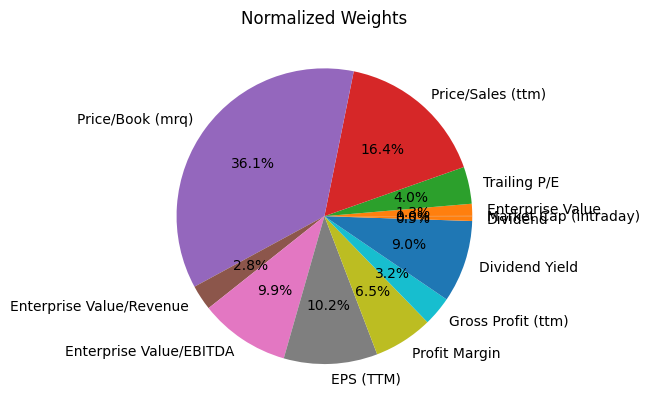

In [19]:
# Normalize weights to sum up to 1
weights = weights / np.sum(weights)

# Convert any negative values to positive values
weights = np.abs(weights)

# Create a pie chart of normalized weights
plt.pie(weights, labels=df.columns[1:], autopct='%1.1f%%')
plt.title('Normalized Weights')
plt.show()

**Shortlist stocks using Weight Scoring Model**

1) The Weight Scoring model is used for stock shortlisting based on fundamental data.

2) The overall score for each stock is calculated by multiplying the normalized value of each feature by its weight and summing the results.

3) This scoring system helps identify the top-performing stocks in a specific sector based on their overall scores.

image.png

Where,

Score = Score of stock  calculated on Fundamental Data

F1 – Fn = Factors that affect score. Eg : Market Capitalization, Enterprise Value, PE ratio,etc

W1- Wn = Weights assigned to respective Factors(F)


In [20]:
factors = ["Market Cap (intraday)", "Enterprise Value", "Trailing P/E", "Price/Sales (ttm)", "Price/Book (mrq)", "Enterprise Value/Revenue", "Enterprise Value/EBITDA",'EPS (TTM)',"Profit Margin",  "Gross Profit (ttm)","Dividend Yield", "Dividend"]

In [21]:
sectors = data["Sector"].unique()

In [22]:
sectors

array(['Chemicals', 'Investment Banking & Investment Services',
       'Real Estate Operations', 'Media & Publishing',
       'Construction & Engineering',
       'Oil & Gas Related Equipment and Services',
       'Machinery, Equipment & Components', 'Pharmaceuticals',
       'Textiles & Apparel', 'Professional & Commercial Services',
       'Banking Services', 'Diversified Industrial Goods Wholesale',
       'Construction Materials', 'Software & IT Services',
       'Freight & Logistics Services', 'Electrical Utilities & IPPs',
       'Transport Infrastructure', 'Food & Tobacco', 'Insurance',
       'Specialty Retailers', 'Hotels & Entertainment Services',
       'Homebuilding & Construction Supplies', 'Paper & Forest Products',
       'Food & Drug Retailing', 'Communications & Networking',
       'Automobiles & Auto Parts',
       'Computers, Phones & Household Electronics',
       'Containers & Packaging', 'Coal', 'Metals & Mining',
       'Healthcare Providers & Services', 'Aerospa

In [23]:
factors1 = {
    'Market Cap (intraday)': 0.0011760115832118486,
    'Enterprise Value': -0.04074949514972337,
    'Trailing P/E': 0.12583953287493094,
    'Price/Sales (ttm)': -0.5112851350345458,
    'Price/Book (mrq)': 1.1236542788901878,
    'Enterprise Value/Revenue': -0.08596840219977696,
    'Enterprise Value/EBITDA': 0.30838491934242973,
    'EPS (TTM)': -0.31911894287010617,
    'Profit Margin': 0.20137724856818778,
    'Gross Profit (ttm)': -0.09967515393906008,
    'Dividend Yield': 0.2801464470949708,
    'Dividend': 0.016218690839293205
    }

In [24]:
selected_stocks = {}

# Define columns to select in the dataframe
cols_to_select = ["Market Cap (intraday)", "Enterprise Value", "Trailing P/E", "Price/Sales (ttm)",
                  "Price/Book (mrq)", "Enterprise Value/Revenue", "Enterprise Value/EBITDA", 
                  "Gross Profit (ttm)", "Book Value Per Share (mrq)", 
                  "Price", "Dividend Yield", "Dividend", "Sector", "Score"]

# Create an empty dataframe to store the selected stocks
selected_stocks_df = pd.DataFrame(columns=cols_to_select)

for sector in sectors:
    sector_data = data[data["Sector"] == sector]
    sector_data = sector_data.set_index("Ticker")

    # Create a dataframe for all stocks in sector_data
    all_stocks_data = pd.DataFrame(sector_data)

    # Compute the score for each stock based on the factors and their weights
    all_stocks_data["Score"] = sum(
        all_stocks_data[factor1] * weight for factor1, weight in factors1.items()
        if pd.api.types.is_numeric_dtype(all_stocks_data[factor1])
    )

    # Select the top 10 stocks with the highest scores
    selected_tickers = all_stocks_data["Score"].nlargest(5).index.tolist()
    selected_stocks[sector] = selected_tickers
    
    # Print the top 10 stocks for the current sector
    print(f"Top 15 stocks in {sector}:")
    print(", ".join(selected_stocks[sector]))
    print()

    # Add the selected stocks to the dataframe
    selected_stocks_df = selected_stocks_df.append(all_stocks_data.loc[selected_tickers, cols_to_select])

Top 15 stocks in Chemicals:
TAINWALCHM.NS, ARVEE.NS, AGROPHOS.NS, SIKKO.NS, ALKALI.NS

Top 15 stocks in Investment Banking & Investment Services:
IITL.NS, 21STCENMGM.NS, DBSTOCKBRO.NS, HBSL.NS, INDBANK.NS

Top 15 stocks in Real Estate Operations:
AMJLAND.NS, PANSARI.NS, GEECEE.NS, SUMIT.NS, SHRADHA.NS

Top 15 stocks in Media & Publishing:
SILLYMONKS.NS, PNC.NS, PRESSMN.NS, DEN.NS, VERTOZ.NS

Top 15 stocks in Construction & Engineering:
COUNCODOS.NS, SETUINFRA.NS, HECPROJECT.NS, CORALFINAC.NS, UNIVASTU.NS

Top 15 stocks in Oil & Gas Related Equipment and Services:
AAKASH.NS, GLOBALVECT.NS, JINDRILL.NS, MANINDS.NS, SEAMECLTD.NS

Top 15 stocks in Machinery, Equipment & Components:
GODHA.NS, INDIANCARD.NS, AARON.NS, BEARDSELL.NS, GEEKAYWIRE.NS

Top 15 stocks in Pharmaceuticals:
BIOFILCHEM.NS, VAISHALI.NS, ALPA.NS, KILITCH.NS, SMSLIFE.NS

Top 15 stocks in Textiles & Apparel:
MITTAL.NS, LYPSAGEMS.NS, VCL.NS, SILGO.NS, BANARBEADS.NS

Top 15 stocks in Professional & Commercial Services:
ARENTE

<ipython-input-24-70c442db579f>:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  selected_stocks_df = selected_stocks_df.append(all_stocks_data.loc[selected_tickers, cols_to_select])
<ipython-input-24-70c442db579f>:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  selected_stocks_df = selected_stocks_df.append(all_stocks_data.loc[selected_tickers, cols_to_select])
<ipython-input-24-70c442db579f>:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  selected_stocks_df = selected_stocks_df.append(all_stocks_data.loc[selected_tickers, cols_to_select])
<ipython-input-24-70c442db579f>:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  selected_s

Top 15 stocks in Diversified Industrial Goods Wholesale:
KOTHARIPRO.NS, ABB.NS, ADANIENT.NS, HEXATRADEX.NS, STCINDIA.NS

Top 15 stocks in Construction Materials:
KAKATCEM.NS, BVCL.NS, BIGBLOC.NS, SHREDIGCEM.NS, DECCANCE.NS

Top 15 stocks in Software & IT Services:
ADROITINFO.NS, HOVS.NS, EXCEL.NS, TREJHARA.NS, CTE.NS

Top 15 stocks in Freight & Logistics Services:
PATINTLOG.NS, JETFREIGHT.NS, NECCLTD.NS, RUCHINFRA.NS, ACCURACY.NS

Top 15 stocks in Electrical Utilities & IPPs:
INDOWIND.NS, UJAAS.NS, ENERGYDEV.NS, URJA.NS, DPSCLTD.NS

Top 15 stocks in Transport Infrastructure:
DREDGECORP.NS, GPPL.NS, ADANIPORTS.NS, GMRINFRA.NS, MEP.NS

Top 15 stocks in Food & Tobacco:
NORBTEAEXP.NS, NARMADA.NS, AJOONI.NS, AGRITECH.NS, SHANTI.NS

Top 15 stocks in Insurance:
MFSL.NS, ABCAPITAL.NS, BAJAJFINSV.NS, GICRE.NS, HDFCLIFE.NS

Top 15 stocks in Specialty Retailers:
LIBAS.NS, COMPINFO.NS, DPABHUSHAN.NS, V2RETAIL.NS, TBZ.NS

Top 15 stocks in Hotels & Entertainment Services:
HAVISHA.NS, TALWALKARS.NS, 

<ipython-input-24-70c442db579f>:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  selected_stocks_df = selected_stocks_df.append(all_stocks_data.loc[selected_tickers, cols_to_select])
<ipython-input-24-70c442db579f>:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  selected_stocks_df = selected_stocks_df.append(all_stocks_data.loc[selected_tickers, cols_to_select])
<ipython-input-24-70c442db579f>:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  selected_stocks_df = selected_stocks_df.append(all_stocks_data.loc[selected_tickers, cols_to_select])
<ipython-input-24-70c442db579f>:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  selected_s


SUNDARAM.NS, WIPL.NS, SHRENIK.NS, AIROLAM.NS, MALUPAPER.NS

Top 15 stocks in Food & Drug Retailing:
AKG.NS, SAKUMA.NS, DMART.NS, FRETAIL.NS, OSIAHYPER.NS

Top 15 stocks in Communications & Networking:
SMARTLINK.NS, KERNEX.NS, AKSHOPTFBR.NS, DLINKINDIA.NS, PARACABLES.NS

Top 15 stocks in Automobiles & Auto Parts:
MODIRUBBER.NS, SOMICONVEY.NS, JMA.NS, SINTERCOM.NS, OMAXAUTO.NS

Top 15 stocks in Computers, Phones & Household Electronics:
UNIVPHOTO.NS, PANACHE.NS, CEREBRAINT.NS, BPL.NS, TVSELECT.NS

Top 15 stocks in Containers & Packaging:
TOKYOPLAST.NS, ARROWGREEN.NS, WORTH.NS, AMDIND.NS, TPLPLASTEH.NS

Top 15 stocks in Coal:
ANIKINDS.NS, GMDCLTD.NS, COALINDIA.NS, MERCATOR.NS

Top 15 stocks in Metals & Mining:
NSIL.NS, CUBEXTUB.NS, SUPREMEENG.NS, KRITIKA.NS, GAL.NS

Top 15 stocks in Healthcare Providers & Services:
LOTUSEYE.NS, PAR.NS, SHALBY.NS, THYROCARE.NS, HCG.NS

Top 15 stocks in Aerospace & Defense:
APOLLO.NS, ZENTEC.NS, MAZDOCK.NS, BDL.NS, BEL.NS

Top 15 stocks in Professional & B

<ipython-input-24-70c442db579f>:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  selected_stocks_df = selected_stocks_df.append(all_stocks_data.loc[selected_tickers, cols_to_select])
<ipython-input-24-70c442db579f>:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  selected_stocks_df = selected_stocks_df.append(all_stocks_data.loc[selected_tickers, cols_to_select])
<ipython-input-24-70c442db579f>:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  selected_stocks_df = selected_stocks_df.append(all_stocks_data.loc[selected_tickers, cols_to_select])
<ipython-input-24-70c442db579f>:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  selected_s

Top 15 stocks in Financial Technology (Fintech) & Infrastructure:
INFIBEAM.NS, INTELLECT.NS, ATNINTER.NS

Top 15 stocks in Household Goods:
AVROIND.NS, PILITA.NS, BUTTERFLY.NS, LAOPALA.NS, ICIL.NS

Top 15 stocks in Personal & Household Products & Services:
CLEDUCATE.NS, CUPID.NS, BAJAJCON.NS, JYOTHYLAB.NS, GILLETTE.NS

Top 15 stocks in Consumer Goods Conglomerates:
BALMLAWRIE.NS, GODREJIND.NS, JPASSOCIAT.NS, JITFINFRA.NS

Top 15 stocks in Oil & Gas:
SELAN.NS, GULFPETRO.NS, GOACARBON.NS, HINDOILEXP.NS, TIDEWATER.NS

Top 15 stocks in Telecommunications Services:
UNIINFO.NS, TATACOMM.NS, BHARTIARTL.NS, GTLINFRA.NS, MTNL.NS

Top 15 stocks in Biotechnology & Medical Research:


<ipython-input-24-70c442db579f>:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  selected_stocks_df = selected_stocks_df.append(all_stocks_data.loc[selected_tickers, cols_to_select])
<ipython-input-24-70c442db579f>:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  selected_stocks_df = selected_stocks_df.append(all_stocks_data.loc[selected_tickers, cols_to_select])
<ipython-input-24-70c442db579f>:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  selected_stocks_df = selected_stocks_df.append(all_stocks_data.loc[selected_tickers, cols_to_select])
<ipython-input-24-70c442db579f>:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  selected_s

VIMTALABS.NS, SYNGENE.NS, BIOCON.NS

Top 15 stocks in Miscellaneous Educational Service Providers:
MTEDUCARE.NS, CAREERP.NS, GLOBAL.NS, EDUCOMP.NS

Top 15 stocks in Natural Gas Utilities:
CONFIPET.NS, MGL.NS, GSPL.NS, IGL.NS, GUJGASLTD.NS

Top 15 stocks in Renewable Energy:
SURANASOL.NS, EUROMULTI.NS, INDOSOLAR.NS, INOXWIND.NS, SUZLON.NS

Top 15 stocks in Residential & Commercial REIT:
GKWLIMITED.NS, TAKE.NS

Top 15 stocks in Passenger Transportation Services:
IRCTC.NS, INDIGO.NS, JETAIRWAYS.NS

Top 15 stocks in Holding Companies:
MCDHOLDING.NS

Top 15 stocks in Healthcare Equipment & Supplies:
POLYMED.NS, OPTOCIRCUI.NS



<ipython-input-24-70c442db579f>:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  selected_stocks_df = selected_stocks_df.append(all_stocks_data.loc[selected_tickers, cols_to_select])
<ipython-input-24-70c442db579f>:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  selected_stocks_df = selected_stocks_df.append(all_stocks_data.loc[selected_tickers, cols_to_select])
<ipython-input-24-70c442db579f>:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  selected_stocks_df = selected_stocks_df.append(all_stocks_data.loc[selected_tickers, cols_to_select])
<ipython-input-24-70c442db579f>:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  selected_s

Top 15 stocks in Diversified Retail:
VMART.NS, SHOPERSTOP.NS, TRENT.NS

Top 15 stocks in Water Utilities:
WABAG.NS

Top 15 stocks in School, College & University:
ZEELEARN.NS



<ipython-input-24-70c442db579f>:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  selected_stocks_df = selected_stocks_df.append(all_stocks_data.loc[selected_tickers, cols_to_select])
<ipython-input-24-70c442db579f>:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  selected_stocks_df = selected_stocks_df.append(all_stocks_data.loc[selected_tickers, cols_to_select])


In [25]:
selected_stocks_df

,Market Cap (intraday),Enterprise Value,Trailing P/E,Price/Sales (ttm),Price/Book (mrq),Enterprise Value/Revenue,Enterprise Value/EBITDA,Gross Profit (ttm),Book Value Per Share (mrq),Price,Dividend Yield,Dividend,Sector,Score
TAINWALCHM.NS,9.476200e+08,9.414100e+08,18.54,16.63,1.02,16.54,16.88,1.244000e+07,93.35,103.90,0.00,0.00,Chemicals,-3.848753e+07
ARVEE.NS,1.130000e+09,1.120000e+09,23.03,1.63,4.16,1.62,12.30,1.788800e+08,16.96,105.00,0.00,0.00,Chemicals,-6.214042e+07
AGROPHOS.NS,7.896800e+08,9.062800e+08,13.52,1.29,1.68,1.49,9.30,3.374000e+08,24.98,41.00,0.67,0.25,Chemicals,-6.963217e+07
SIKKO.NS,1.530000e+09,1.530000e+09,71.72,2.53,6.55,2.55,42.75,1.239900e+08,16.74,93.45,0.32,0.30,Chemicals,-7.290612e+07
ALKALI.NS,1.260000e+09,1.430000e+09,45.29,1.34,2.40,1.59,13.22,5.075500e+08,43.46,123.15,1.74,2.00,Chemicals,-1.073801e+08
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
VMART.NS,5.051000e+10,6.199000e+10,191.29,2.18,5.88,2.66,20.25,5.540000e+09,224.34,2542.00,0.03,0.75,Diversified Retail,-3.018861e+09
SHOPERSTOP.NS,7.378000e+10,9.289000e+10,84.88,1.96,61.21,2.45,13.88,9.000000e+09,-14.56,660.65,0.00,0.00,Diversified Retail,-4.595531e+09
TRENT.NS,4.720900e+11,5.126900e+11,120.80,6.43,19.82,6.98,39.68,2.016000e+10,65.07,1341.90,0.17,2.30,Diversified Retail,-2.234613e+10
WABAG.NS,2.066000e+10,2.078000e+10,12.38,0.69,1.29,0.72,8.44,4.550000e+09,241.75,323.80,0.00,0.00,Water Utilities,-1.276000e+09


In [26]:
selected_stocks_df.index.name = 'Ticker'
selected_stocks_df

,Market Cap (intraday),Enterprise Value,Trailing P/E,Price/Sales (ttm),Price/Book (mrq),Enterprise Value/Revenue,Enterprise Value/EBITDA,Gross Profit (ttm),Book Value Per Share (mrq),Price,Dividend Yield,Dividend,Sector,Score
Ticker,,,,,,,,,,,,,,
TAINWALCHM.NS,9.476200e+08,9.414100e+08,18.54,16.63,1.02,16.54,16.88,1.244000e+07,93.35,103.90,0.00,0.00,Chemicals,-3.848753e+07
ARVEE.NS,1.130000e+09,1.120000e+09,23.03,1.63,4.16,1.62,12.30,1.788800e+08,16.96,105.00,0.00,0.00,Chemicals,-6.214042e+07
AGROPHOS.NS,7.896800e+08,9.062800e+08,13.52,1.29,1.68,1.49,9.30,3.374000e+08,24.98,41.00,0.67,0.25,Chemicals,-6.963217e+07
SIKKO.NS,1.530000e+09,1.530000e+09,71.72,2.53,6.55,2.55,42.75,1.239900e+08,16.74,93.45,0.32,0.30,Chemicals,-7.290612e+07
ALKALI.NS,1.260000e+09,1.430000e+09,45.29,1.34,2.40,1.59,13.22,5.075500e+08,43.46,123.15,1.74,2.00,Chemicals,-1.073801e+08
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
VMART.NS,5.051000e+10,6.199000e+10,191.29,2.18,5.88,2.66,20.25,5.540000e+09,224.34,2542.00,0.03,0.75,Diversified Retail,-3.018861e+09
SHOPERSTOP.NS,7.378000e+10,9.289000e+10,84.88,1.96,61.21,2.45,13.88,9.000000e+09,-14.56,660.65,0.00,0.00,Diversified Retail,-4.595531e+09
TRENT.NS,4.720900e+11,5.126900e+11,120.80,6.43,19.82,6.98,39.68,2.016000e+10,65.07,1341.90,0.17,2.30,Diversified Retail,-2.234613e+10


In [27]:
selected_stocks_df.rename(columns = {'Market Cap (intraday)':'Market Capitalization', 'Trailing P/E':'PE Ratio',
                              'Price/Book (mrq)':'PB Ratio','Price/Sales (ttm)':'Price to Sales Ratio','Enterprise Value/Revenue':'Revenue','Enterprise Value/EBITDA':'EBITDA','Gross Profit (ttm)':'Gross Profit','Book Value Per Share (mrq)':'Book Value' }, inplace = True)

In [28]:
selected_stocks

{'Chemicals': ['TAINWALCHM.NS',
  'ARVEE.NS',
  'AGROPHOS.NS',
  'SIKKO.NS',
  'ALKALI.NS'],
 'Investment Banking & Investment Services': ['IITL.NS',
  '21STCENMGM.NS',
  'DBSTOCKBRO.NS',
  'HBSL.NS',
  'INDBANK.NS'],
 'Real Estate Operations': ['AMJLAND.NS',
  'PANSARI.NS',
  'GEECEE.NS',
  'SUMIT.NS',
  'SHRADHA.NS'],
 'Media & Publishing': ['SILLYMONKS.NS',
  'PNC.NS',
  'PRESSMN.NS',
  'DEN.NS',
  'VERTOZ.NS'],
 'Construction & Engineering': ['COUNCODOS.NS',
  'SETUINFRA.NS',
  'HECPROJECT.NS',
  'CORALFINAC.NS',
  'UNIVASTU.NS'],
 'Oil & Gas Related Equipment and Services': ['AAKASH.NS',
  'GLOBALVECT.NS',
  'JINDRILL.NS',
  'MANINDS.NS',
  'SEAMECLTD.NS'],
 'Machinery, Equipment & Components': ['GODHA.NS',
  'INDIANCARD.NS',
  'AARON.NS',
  'BEARDSELL.NS',
  'GEEKAYWIRE.NS'],
 'Pharmaceuticals': ['BIOFILCHEM.NS',
  'VAISHALI.NS',
  'ALPA.NS',
  'KILITCH.NS',
  'SMSLIFE.NS'],
 'Textiles & Apparel': ['MITTAL.NS',
  'LYPSAGEMS.NS',
  'VCL.NS',
  'SILGO.NS',
  'BANARBEADS.NS'],
 'Pro

Fetch Historical Data of Shortlisted Stocks of Each Sector

In [29]:
historical_data = pd.DataFrame()

for sector, stocks in selected_stocks.items():
    for stock in stocks:
        try:
            # Load stock data
            data = si.get_data(stock, start_date="2013-01-01", end_date=datetime.today())
            #data = si.get_data(stock, start_date="2015-01-01", end_date='2023-01-01')

            # Add a column with the ticker symbol
            data['Sector'] = sector

            # Add the stock data to the DataFrame
            historical_data = historical_data.append(data)
        except AssertionError as error:
            print(f"Error retrieving data for {stock}: {error}")

<ipython-input-29-29afa71a0322>:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  historical_data = historical_data.append(data)
<ipython-input-29-29afa71a0322>:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  historical_data = historical_data.append(data)
<ipython-input-29-29afa71a0322>:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  historical_data = historical_data.append(data)
<ipython-input-29-29afa71a0322>:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  historical_data = historical_data.append(data)
<ipython-input-29-29afa71a0322>:14: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a fu

In [30]:
historical_data

,open,high,low,close,adjclose,volume,ticker,Sector
2013-01-01,21.000000,22.100000,21.000000,21.150000,21.150000,752.0,TAINWALCHM.NS,Chemicals
2013-01-02,21.950001,21.950001,20.500000,21.049999,21.049999,98.0,TAINWALCHM.NS,Chemicals
2013-01-03,21.950001,21.950001,21.000000,21.000000,21.000000,503.0,TAINWALCHM.NS,Chemicals
2013-01-04,21.950001,21.950001,20.700001,20.750000,20.750000,40.0,TAINWALCHM.NS,Chemicals
2013-01-07,21.750000,21.750000,20.500000,21.450001,21.450001,2152.0,TAINWALCHM.NS,Chemicals
...,...,...,...,...,...,...,...,...
2023-05-16,3.400000,3.500000,3.400000,3.400000,3.400000,1185800.0,ZEELEARN.NS,"School, College & University"
2023-05-17,3.450000,3.500000,3.400000,3.400000,3.400000,353564.0,ZEELEARN.NS,"School, College & University"
2023-05-18,3.400000,3.500000,3.350000,3.400000,3.400000,293752.0,ZEELEARN.NS,"School, College & University"
2023-05-19,3.450000,3.450000,3.350000,3.400000,3.400000,280130.0,ZEELEARN.NS,"School, College & University"


**Historical data Preprocessing**

1) Null Value Removal

2) Rounding off 

3) Feature Selection ( Corelation Metrics)



In [31]:
historical_data.isnull().sum(axis = 0)

open        821
high        821
low         821
close       821
adjclose    821
volume      821
ticker        0
Sector        0
dtype: int64

In [32]:
# Drop Null Values
df_historical_data = historical_data.dropna()
df_historical_data

,open,high,low,close,adjclose,volume,ticker,Sector
2013-01-01,21.000000,22.100000,21.000000,21.150000,21.150000,752.0,TAINWALCHM.NS,Chemicals
2013-01-02,21.950001,21.950001,20.500000,21.049999,21.049999,98.0,TAINWALCHM.NS,Chemicals
2013-01-03,21.950001,21.950001,21.000000,21.000000,21.000000,503.0,TAINWALCHM.NS,Chemicals
2013-01-04,21.950001,21.950001,20.700001,20.750000,20.750000,40.0,TAINWALCHM.NS,Chemicals
2013-01-07,21.750000,21.750000,20.500000,21.450001,21.450001,2152.0,TAINWALCHM.NS,Chemicals
...,...,...,...,...,...,...,...,...
2023-05-16,3.400000,3.500000,3.400000,3.400000,3.400000,1185800.0,ZEELEARN.NS,"School, College & University"
2023-05-17,3.450000,3.500000,3.400000,3.400000,3.400000,353564.0,ZEELEARN.NS,"School, College & University"
2023-05-18,3.400000,3.500000,3.350000,3.400000,3.400000,293752.0,ZEELEARN.NS,"School, College & University"
2023-05-19,3.450000,3.450000,3.350000,3.400000,3.400000,280130.0,ZEELEARN.NS,"School, College & University"


In [33]:
df_historical_data.index.name = 'Date'

In [34]:
# Check for missing values in the columns
df_historical_data.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 476774 entries, 2013-01-01 to 2023-05-22
Data columns (total 8 columns):
 #   Column    Non-Null Count   Dtype  
---  ------    --------------   -----  
 0   open      476774 non-null  float64
 1   high      476774 non-null  float64
 2   low       476774 non-null  float64
 3   close     476774 non-null  float64
 4   adjclose  476774 non-null  float64
 5   volume    476774 non-null  float64
 6   ticker    476774 non-null  object 
 7   Sector    476774 non-null  object 
dtypes: float64(6), object(2)
memory usage: 32.7+ MB


In [35]:
df_historical_data.columns

Index(['open', 'high', 'low', 'close', 'adjclose', 'volume', 'ticker',
       'Sector'],
      dtype='object')

In [36]:
#Round of all float values

float_cols = df_historical_data.select_dtypes(include=['float64'])
# round all values in float columns to 2 decimal places
rounded_float_cols = float_cols.round(2)
# replace original float columns with the rounded versions
df_historical_data[float_cols.columns] = rounded_float_cols

<ipython-input-36-e4f6f81740f1>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_historical_data[float_cols.columns] = rounded_float_cols


Feature Selection

In [37]:
# Calculate the correlation matrix
corr_matrix = df_historical_data.corr()

<ipython-input-37-1801498b0aaf>:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr_matrix = df_historical_data.corr()


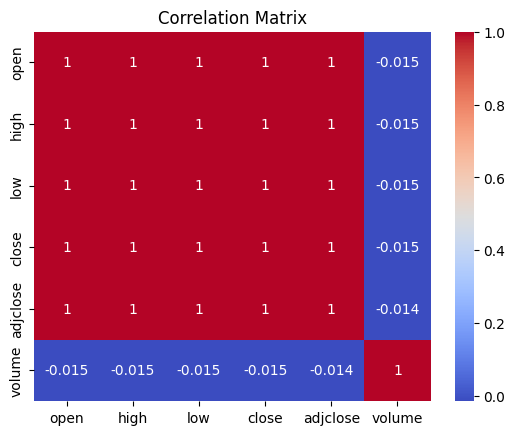

In [38]:
# Plot the correlation matrix
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Matrix')
plt.show()

In [39]:
# Select the top 5 most correlated features
top_features = corr_matrix['close'].sort_values(ascending=False)[1:6]

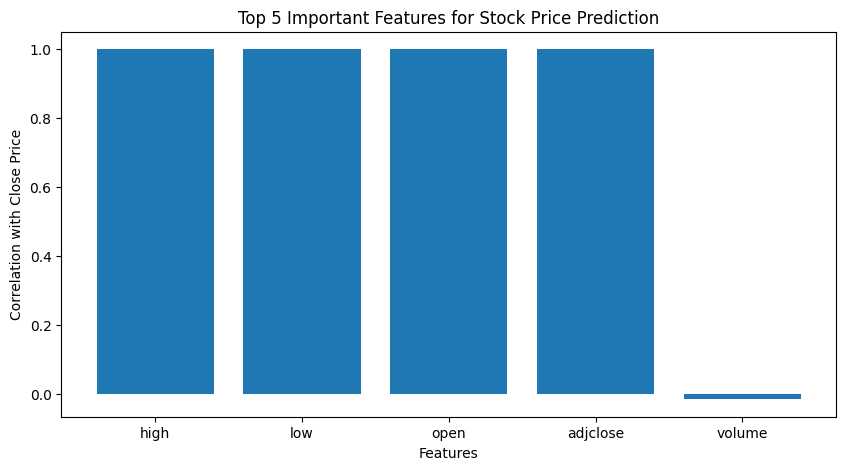

In [40]:
# Plot the features in order of importance
plt.figure(figsize=(10, 5))
plt.bar(top_features.index, top_features.values)
plt.title('Top 5 Important Features for Stock Price Prediction')
plt.xlabel('Features')
plt.ylabel('Correlation with Close Price')
plt.show()

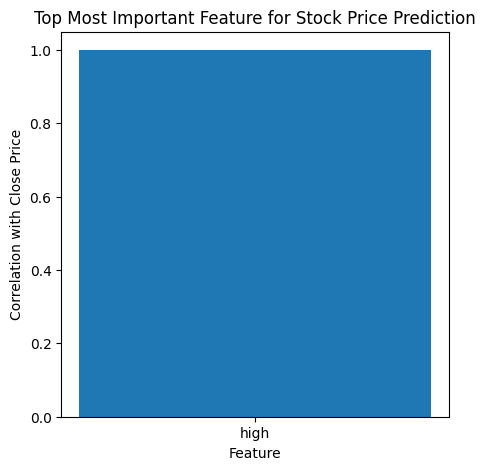

In [41]:
# Select the top most correlated feature
top_feature = corr_matrix.loc['close'].drop('close').idxmax()

# Plot the feature
plt.figure(figsize=(5, 5))
plt.bar(top_feature, corr_matrix.loc['close', top_feature])
plt.title('Top Most Important Feature for Stock Price Prediction')
plt.xlabel('Feature')
plt.ylabel('Correlation with Close Price')
plt.show()


**Train Test Split in 80-20**

In [42]:
train_data, test_data = train_test_split(df_historical_data, test_size=0.2, random_state=42)

In [43]:
train_data

,open,high,low,close,adjclose,volume,ticker,Sector
Date,,,,,,,,
2020-04-30,11.00,11.00,11.00,11.00,11.00,10.0,21STCENMGM.NS,Investment Banking & Investment Services
2019-07-29,133.00,133.00,133.00,133.00,133.00,0.0,HECPROJECT.NS,Construction & Engineering
2015-05-07,62.00,64.00,58.80,60.00,58.19,57130.0,SURANASOL.NS,Renewable Energy
2021-10-22,19.85,19.85,18.25,18.80,18.80,332869.0,NECCLTD.NS,Freight & Logistics Services
2016-03-04,275.38,292.50,274.00,287.25,267.17,4264.0,DECCANCE.NS,Construction Materials
...,...,...,...,...,...,...,...,...
2021-12-08,45.20,50.40,45.20,49.40,49.40,184925.0,OMAXAUTO.NS,Automobiles & Auto Parts
2019-08-26,134.95,136.05,128.50,129.70,118.02,54443.0,CUPID.NS,Personal & Household Products & Services
2015-11-16,0.63,0.65,0.63,0.64,0.64,36045.0,EXCEL.NS,Software & IT Services


**Visualization of Historical data**

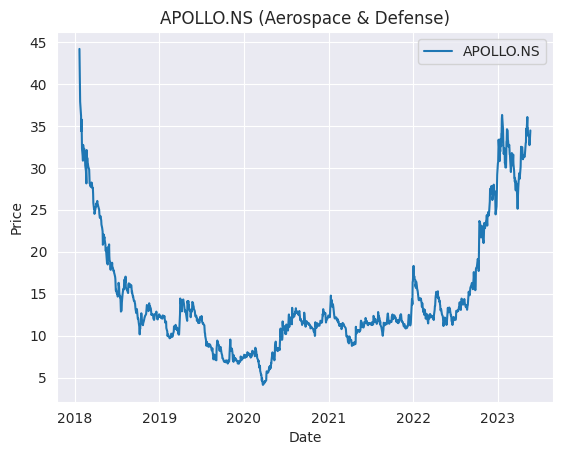

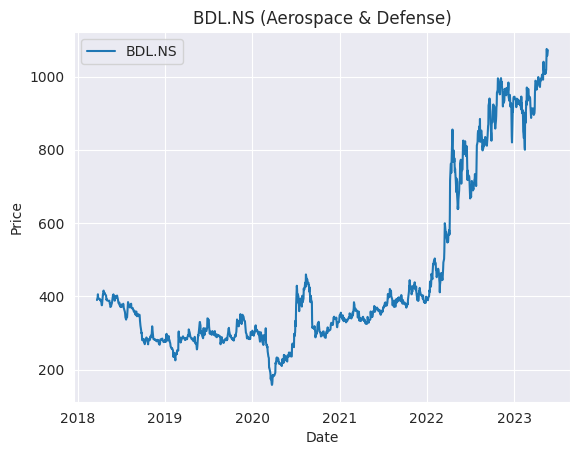

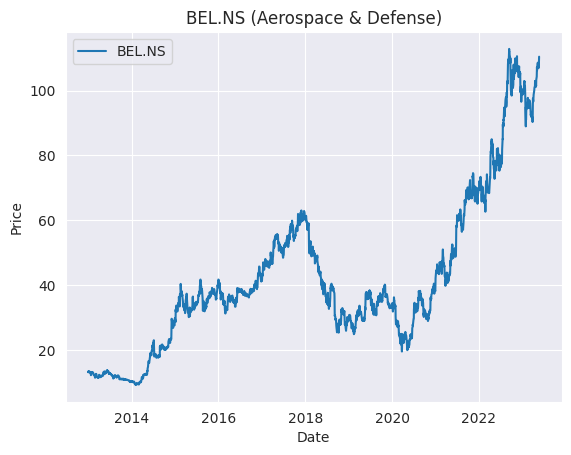

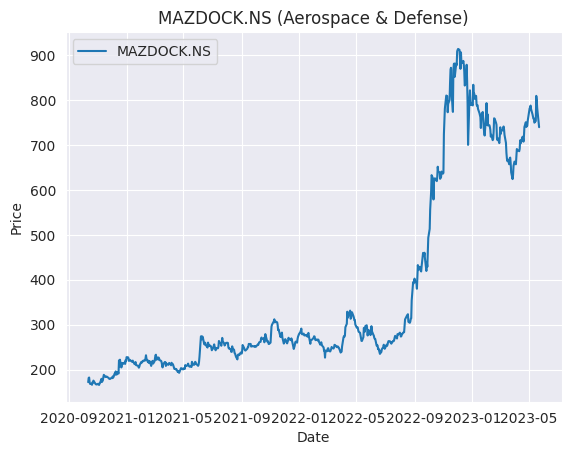

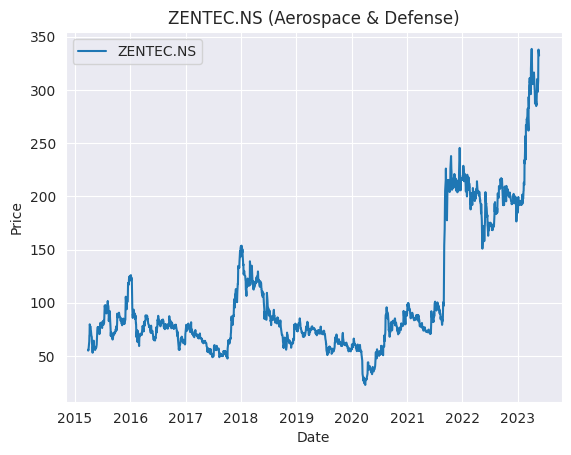

...

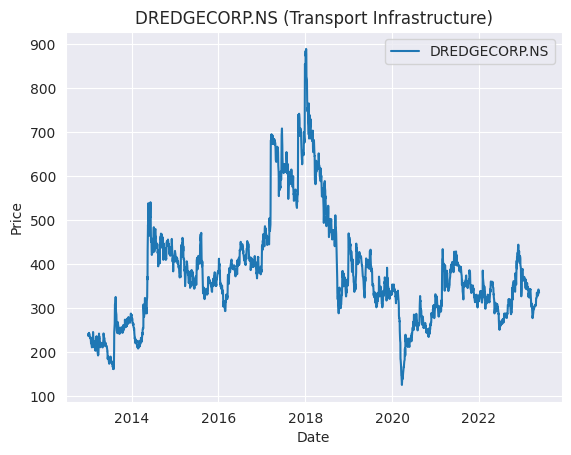

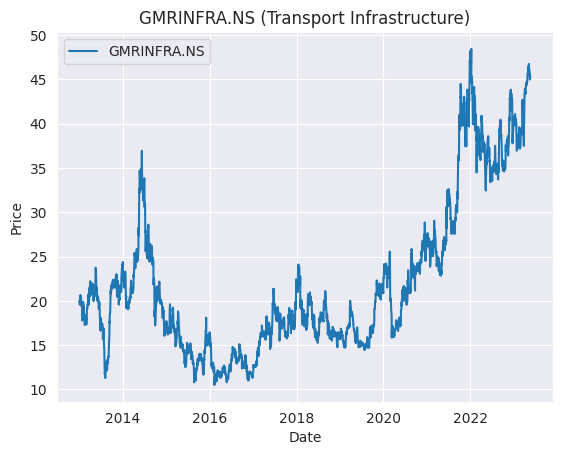

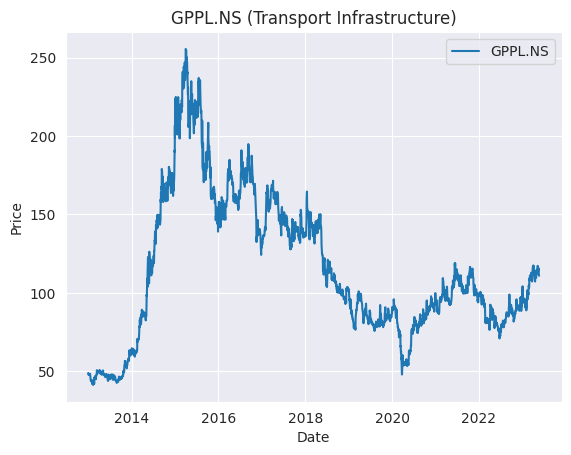

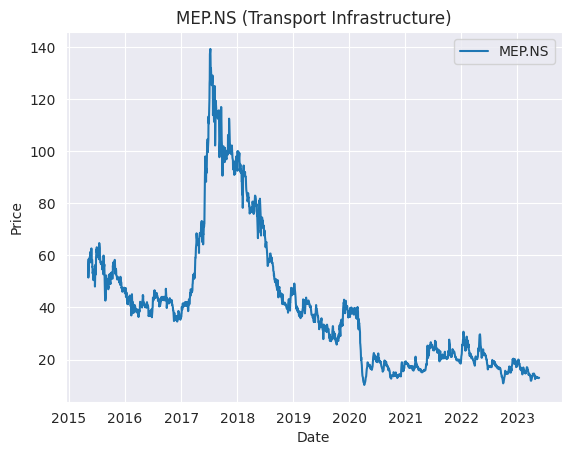

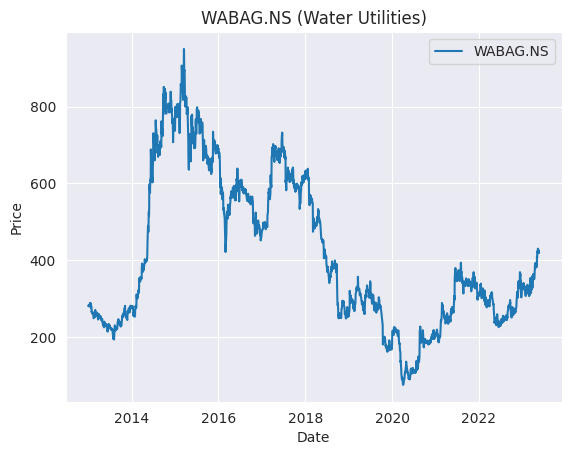

In [44]:
# Set the style of the plots
sns.set_style("darkgrid")

# Group the historical data by sector and ticker
grouped_data = df_historical_data.groupby(['Sector', 'ticker'])

# Iterate over each group and create a line plot
for name, group in grouped_data:
    sector, ticker = name
    sns.lineplot(x=group.index, y=group['close'], label=ticker)
    plt.title(f"{ticker} ({sector})")
    plt.ylabel('Price')
    plt.xlabel('Date')
    plt.show()

In [45]:
df_historical_data

,open,high,low,close,adjclose,volume,ticker,Sector
Date,,,,,,,,
2013-01-01,21.00,22.10,21.00,21.15,21.15,752.0,TAINWALCHM.NS,Chemicals
2013-01-02,21.95,21.95,20.50,21.05,21.05,98.0,TAINWALCHM.NS,Chemicals
2013-01-03,21.95,21.95,21.00,21.00,21.00,503.0,TAINWALCHM.NS,Chemicals
2013-01-04,21.95,21.95,20.70,20.75,20.75,40.0,TAINWALCHM.NS,Chemicals
2013-01-07,21.75,21.75,20.50,21.45,21.45,2152.0,TAINWALCHM.NS,Chemicals
...,...,...,...,...,...,...,...,...
2023-05-16,3.40,3.50,3.40,3.40,3.40,1185800.0,ZEELEARN.NS,"School, College & University"
2023-05-17,3.45,3.50,3.40,3.40,3.40,353564.0,ZEELEARN.NS,"School, College & University"
2023-05-18,3.40,3.50,3.35,3.40,3.40,293752.0,ZEELEARN.NS,"School, College & University"


## Implementation of Algorithms

**Ensemble Learning Algorithm ( Proposed Model)**

- LSTM + XG-Boost + SVM

Forecasting TAINWALCHM.NS in Chemicals sector
Epoch 1/50
60/60 [==============================] - 6s 22ms/step - loss: 0.0337 - val_loss: 0.0030
Epoch 2/50
60/60 [==============================] - 0s 7ms/step - loss: 0.0040 - val_loss: 0.0022
Epoch 3/50
60/60 [==============================] - 0s 6ms/step - loss: 0.0032 - val_loss: 8.3059e-04
Epoch 4/50
60/60 [==============================] - 0s 6ms/step - loss: 0.0024 - val_loss: 5.9751e-04
Epoch 5/50
60/60 [==============================] - 0s 7ms/step - loss: 0.0019 - val_loss: 4.0730e-04
Epoch 6/50
60/60 [==============================] - 1s 9ms/step - loss: 0.0016 - val_loss: 6.4258e-04
Epoch 7/50
60/60 [==============================] - 1s 9ms/step - loss: 0.0016 - val_loss: 0.0011
Epoch 8/50
60/60 [==============================] - 1s 9ms/step - loss: 0.0015 - val_loss: 3.3787e-04
Epoch 9/50
60/60 [==============================] - 1s 9ms/step - loss: 0.0012 - val_loss: 0.0014
Epoch 10/50
60/60 [==============================] 

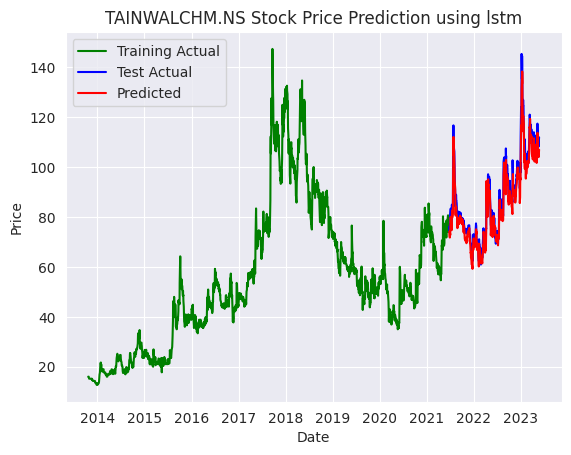

LSTM RMSE: 3.6356
RMSE for TAINWALCHM.NS using LSTM: 3.6355606875810493
Fitting 5 folds for each of 27 candidates, totalling 135 fits
Best hyperparameters:  {'learning_rate': 0.1, 'max_depth': 7, 'n_estimators': 50}
Best score:  0.9503202224545287
Mean Squared Error for XGBoost: 4.2792


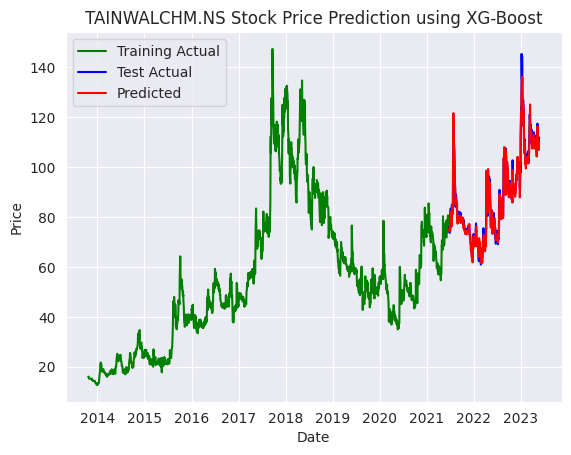

XGB RMSE: 2.0686
RMSE for TAINWALCHM.NS using XGBoost: 2.0686258987340476


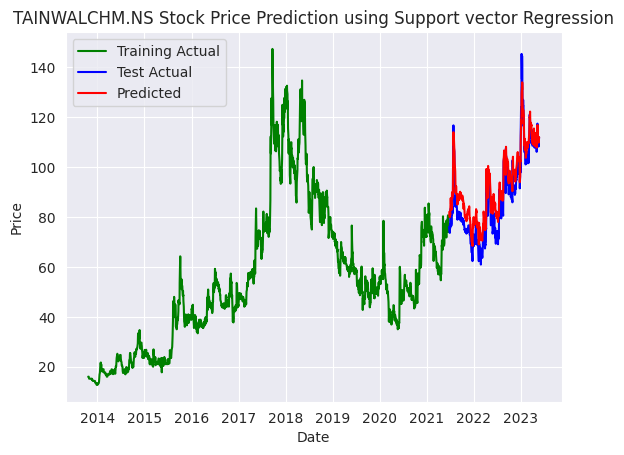

SVM RMSE: 6.0046
RMSE for TAINWALCHM.NS using SVM: 6.0046005484563345
15/15 [==============================] - 0s 2ms/step


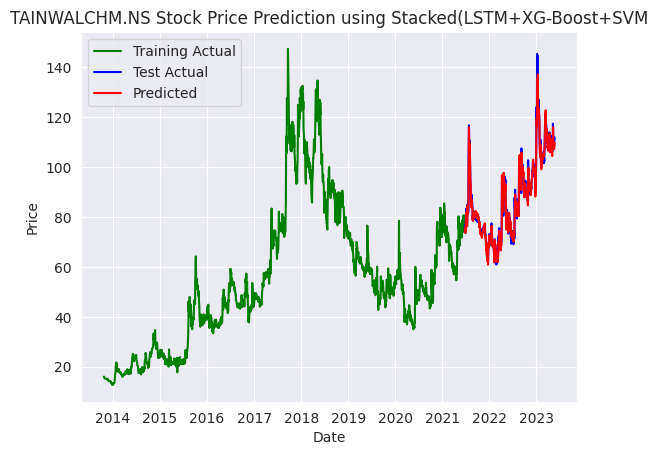

Stacked RMSE: 2.2110
RMSE for TAINWALCHM.NS using Stacked Algorithm: 2.211049875476264


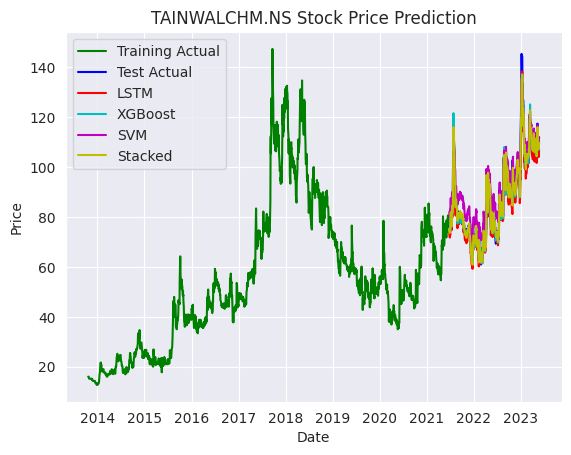

Model evaluation:
LSTM RMSE: 13.2173
LSTM MAE: 2.9018
LSTM R2 Score: 0.9513
XGBoost RMSE: 2.0686
XGBoost MAE: 1.4479
XGBoost R2 Score: 0.9842
SVM RMSE: 6.0046
SVM MAE: 5.4050
SVM R2 Score: 0.8670
Stacked RMSE: 2.2110
Stacked MAE: 1.5281
Stacked R2 Score: 0.9820


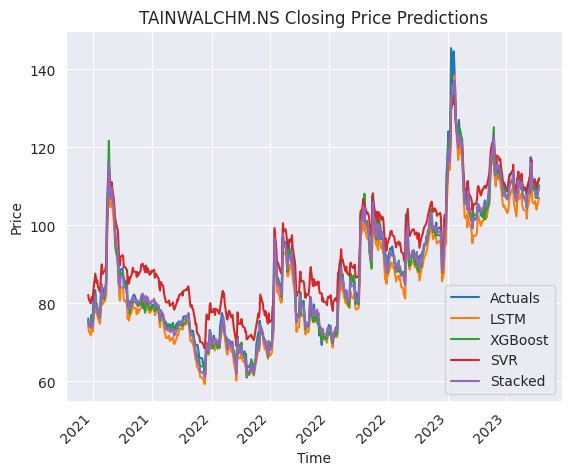

-------------------------------------------------------
Forecasting ARVEE.NS in Chemicals sector
Epoch 1/50
14/14 [==============================] - 5s 75ms/step - loss: 0.1405 - val_loss: 0.2180
Epoch 2/50
14/14 [==============================] - 0s 8ms/step - loss: 0.0331 - val_loss: 0.0112
Epoch 3/50
14/14 [==============================] - 0s 9ms/step - loss: 0.0235 - val_loss: 0.0350
Epoch 4/50
14/14 [==============================] - 0s 8ms/step - loss: 0.0154 - val_loss: 0.0175
Epoch 5/50
14/14 [==============================] - 0s 8ms/step - loss: 0.0107 - val_loss: 0.0096
Epoch 6/50
14/14 [==============================] - 0s 9ms/step - loss: 0.0072 - val_loss: 0.0051
Epoch 7/50
14/14 [==============================] - 0s 8ms/step - loss: 0.0054 - val_loss: 0.0036
Epoch 8/50
14/14 [==============================] - 0s 8ms/step - loss: 0.0048 - val_loss: 0.0023
Epoch 9/50
14/14 [==============================] - 0s 8ms/step - loss: 0.0038 - val_loss: 0.0021
Epoch 10/50
14/14 [=

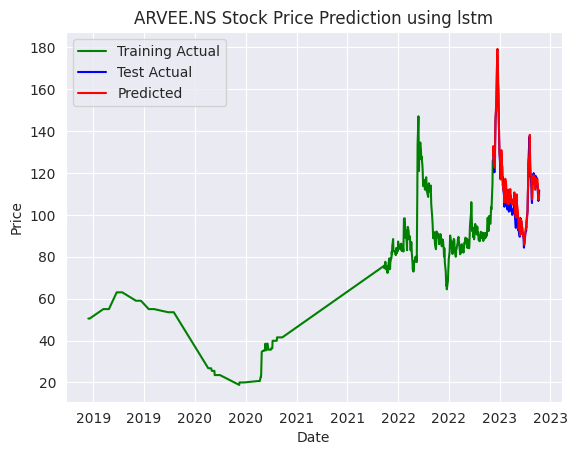

LSTM RMSE: 3.5215
RMSE for ARVEE.NS using LSTM: 3.5215153935553336
Fitting 5 folds for each of 27 candidates, totalling 135 fits
Best hyperparameters:  {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 200}
Best score:  0.8950494734929322
Mean Squared Error for XGBoost: 86.2831


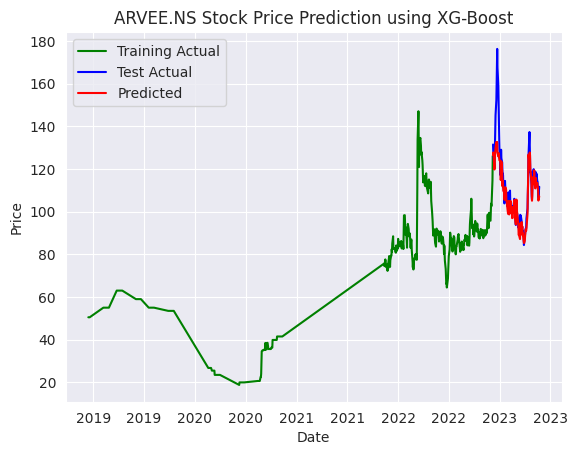

XGB RMSE: 9.2889
RMSE for ARVEE.NS using XGBoost: 9.288870156119337


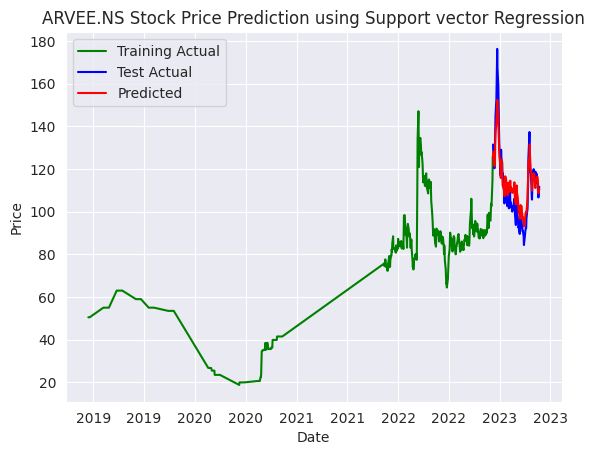

SVM RMSE: 7.0158
RMSE for ARVEE.NS using SVM: 7.015832858546523
4/4 [==============================] - 0s 3ms/step


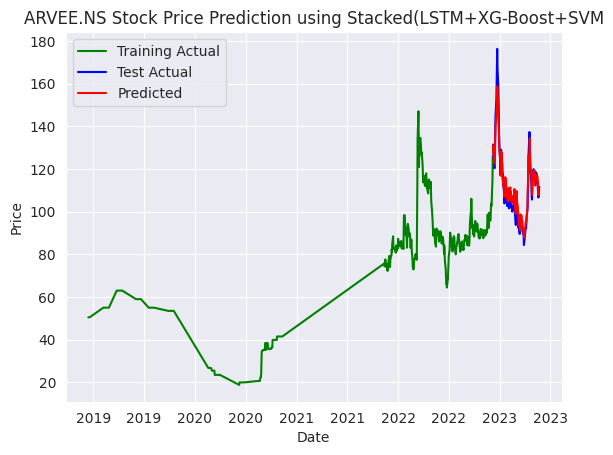

Stacked RMSE: 4.5082
RMSE for ARVEE.NS using Stacked Algorithm: 4.508200497304231


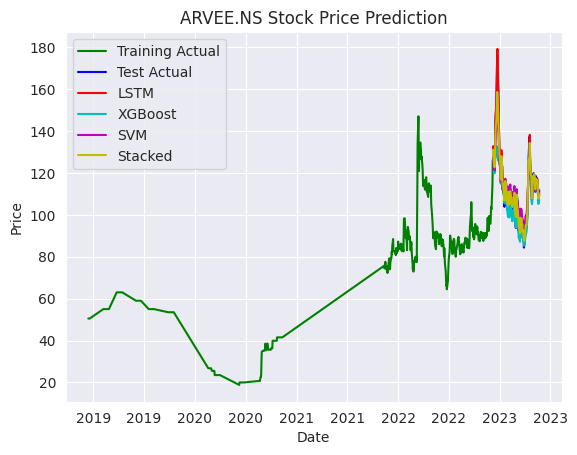

Model evaluation:
LSTM RMSE: 12.4011
LSTM MAE: 2.7779
LSTM R2 Score: 0.9625
XGBoost RMSE: 9.2889
XGBoost MAE: 4.7631
XGBoost R2 Score: 0.7390
SVM RMSE: 7.0158
SVM MAE: 5.7092
SVM R2 Score: 0.8511
Stacked RMSE: 4.5082
Stacked MAE: 3.4976
Stacked R2 Score: 0.9385


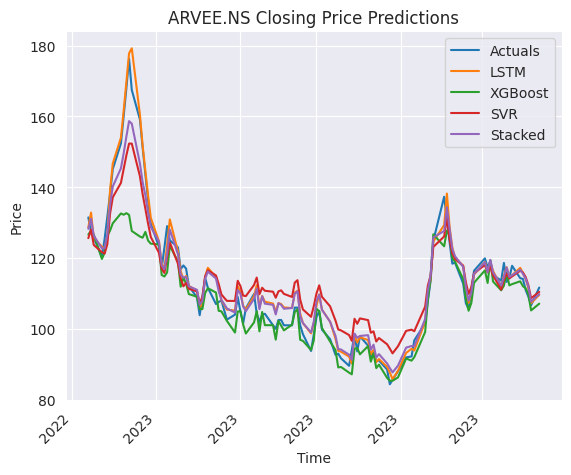

-------------------------------------------------------
Forecasting AGROPHOS.NS in Chemicals sector
Epoch 1/50
34/34 [==============================] - 5s 35ms/step - loss: 0.0372 - val_loss: 0.0012
Epoch 2/50
34/34 [==============================] - 0s 7ms/step - loss: 0.0060 - val_loss: 0.0014
Epoch 3/50
34/34 [==============================] - 0s 7ms/step - loss: 0.0026 - val_loss: 4.4214e-04
Epoch 4/50
34/34 [==============================] - 0s 7ms/step - loss: 0.0016 - val_loss: 5.7778e-04
Epoch 5/50
34/34 [==============================] - 0s 8ms/step - loss: 0.0016 - val_loss: 3.3201e-04
Epoch 6/50
34/34 [==============================] - 0s 7ms/step - loss: 0.0018 - val_loss: 2.5478e-04
Epoch 7/50
34/34 [==============================] - 0s 9ms/step - loss: 0.0014 - val_loss: 5.9795e-04
Epoch 8/50
34/34 [==============================] - 0s 7ms/step - loss: 0.0014 - val_loss: 2.9412e-04
Epoch 9/50
34/34 [==============================] - 0s 7ms/step - loss: 0.0012 - val_loss: 

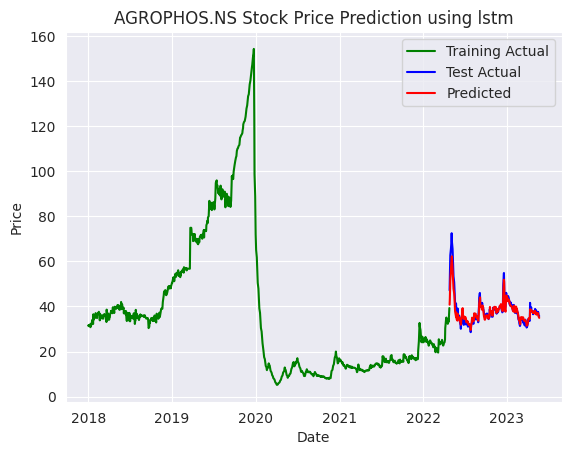

LSTM RMSE: 2.2911
RMSE for AGROPHOS.NS using LSTM: 2.291149163988615
Fitting 5 folds for each of 27 candidates, totalling 135 fits
Best hyperparameters:  {'learning_rate': 0.1, 'max_depth': 5, 'n_estimators': 200}
Best score:  0.9206761896663569
Mean Squared Error for XGBoost: 1.8545


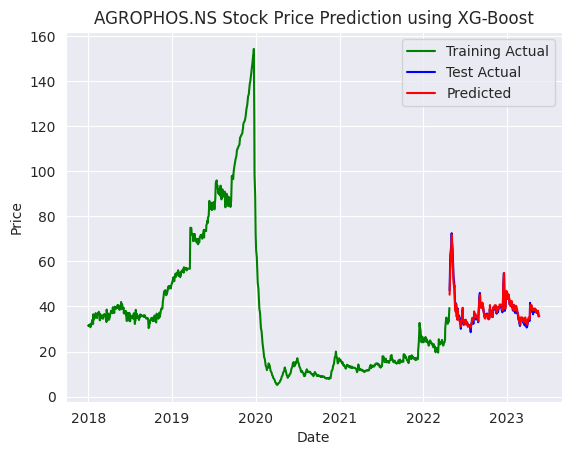

XGB RMSE: 1.3618
RMSE for AGROPHOS.NS using XGBoost: 1.3617989754539956


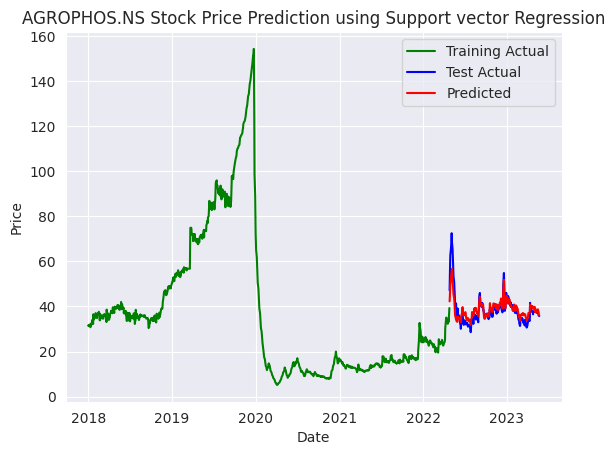

SVM RMSE: 3.4273
RMSE for AGROPHOS.NS using SVM: 3.427271439526911
9/9 [==============================] - 0s 4ms/step


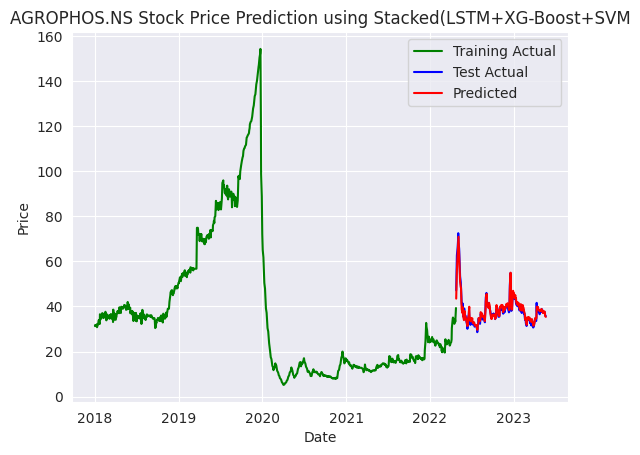

Stacked RMSE: 1.4176
RMSE for AGROPHOS.NS using Stacked Algorithm: 1.4175892005143822


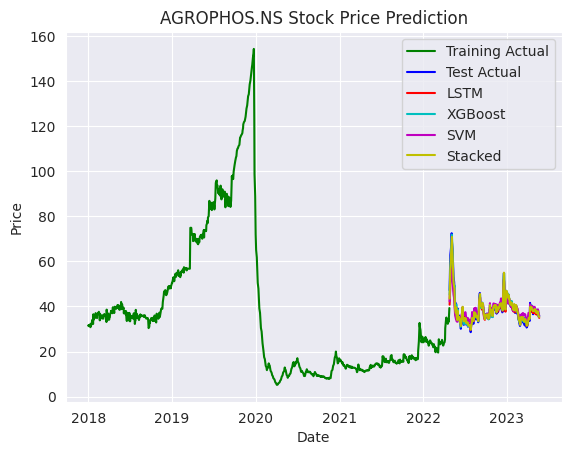

Model evaluation:
LSTM RMSE: 5.2494
LSTM MAE: 1.3443
LSTM R2 Score: 0.8809
XGBoost RMSE: 1.3618
XGBoost MAE: 1.0077
XGBoost R2 Score: 0.9579
SVM RMSE: 3.4273
SVM MAE: 2.4255
SVM R2 Score: 0.7335
Stacked RMSE: 1.4176
Stacked MAE: 1.0398
Stacked R2 Score: 0.9544


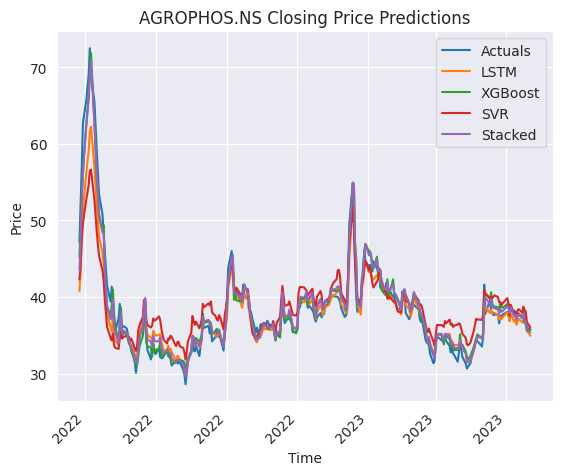

-------------------------------------------------------
Forecasting SIKKO.NS in Chemicals sector
Epoch 1/50
30/30 [==============================] - 5s 39ms/step - loss: 0.0546 - val_loss: 0.8316
Epoch 2/50
30/30 [==============================] - 0s 8ms/step - loss: 0.0108 - val_loss: 0.1104
Epoch 3/50
30/30 [==============================] - 0s 9ms/step - loss: 0.0036 - val_loss: 0.0557
Epoch 4/50
30/30 [==============================] - 0s 8ms/step - loss: 0.0026 - val_loss: 0.0175
Epoch 5/50
30/30 [==============================] - 0s 8ms/step - loss: 0.0026 - val_loss: 0.0069
Epoch 6/50
30/30 [==============================] - 0s 8ms/step - loss: 0.0017 - val_loss: 0.0043
Epoch 7/50
30/30 [==============================] - 0s 8ms/step - loss: 0.0018 - val_loss: 0.0204
Epoch 8/50
30/30 [==============================] - 0s 7ms/step - loss: 0.0016 - val_loss: 0.0093
Epoch 9/50
30/30 [==============================] - 0s 8ms/step - loss: 0.0016 - val_loss: 0.0278
Epoch 10/50
30/30 [=

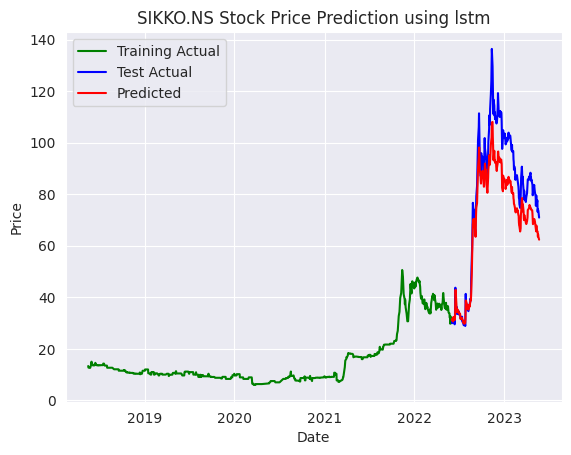

LSTM RMSE: 11.9141
RMSE for SIKKO.NS using LSTM: 11.914091583150126
Fitting 5 folds for each of 27 candidates, totalling 135 fits
Best hyperparameters:  {'learning_rate': 0.1, 'max_depth': 5, 'n_estimators': 200}
Best score:  0.07034350202406356
Mean Squared Error for XGBoost: 1620.5860


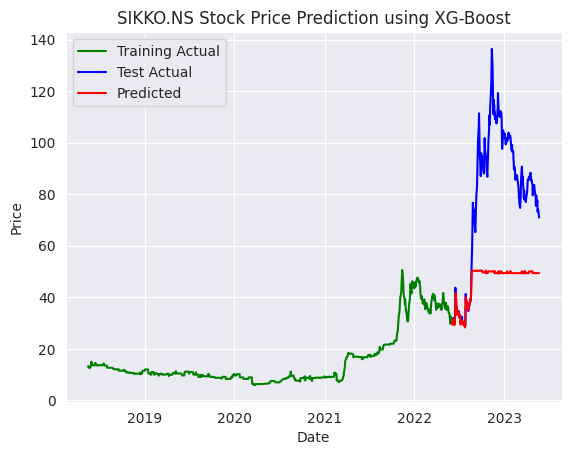

XGB RMSE: 40.2565
RMSE for SIKKO.NS using XGBoost: 40.256502036753915


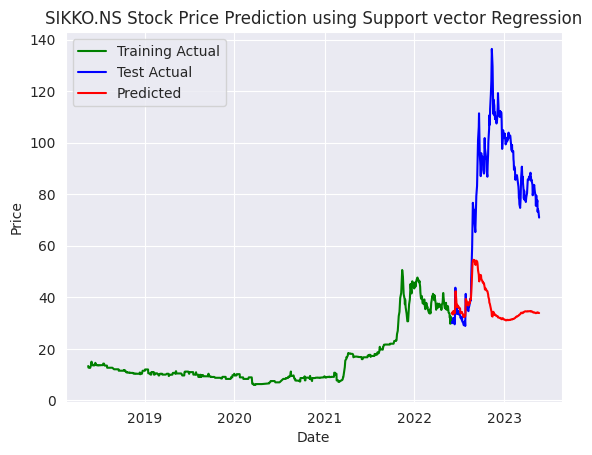

SVM RMSE: 51.9050
RMSE for SIKKO.NS using SVM: 51.90501820644716
8/8 [==============================] - 0s 4ms/step


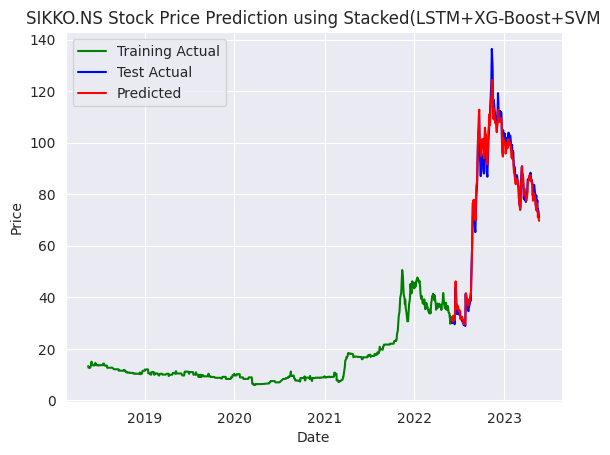

Stacked RMSE: 3.3075
RMSE for SIKKO.NS using Stacked Algorithm: 3.3075153192172126


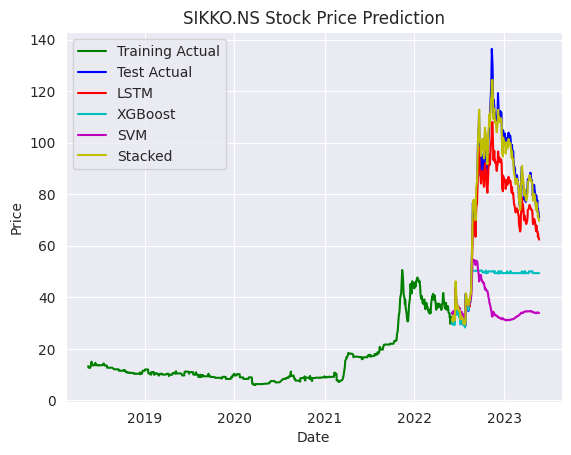

Model evaluation:
LSTM RMSE: 141.9456
LSTM MAE: 9.8271
LSTM R2 Score: 0.8186
XGBoost RMSE: 40.2565
XGBoost MAE: 33.7679
XGBoost R2 Score: -1.0713
SVM RMSE: 51.9050
SVM MAE: 43.8700
SVM R2 Score: -2.4434
Stacked RMSE: 3.3075
Stacked MAE: 2.5563
Stacked R2 Score: 0.9860


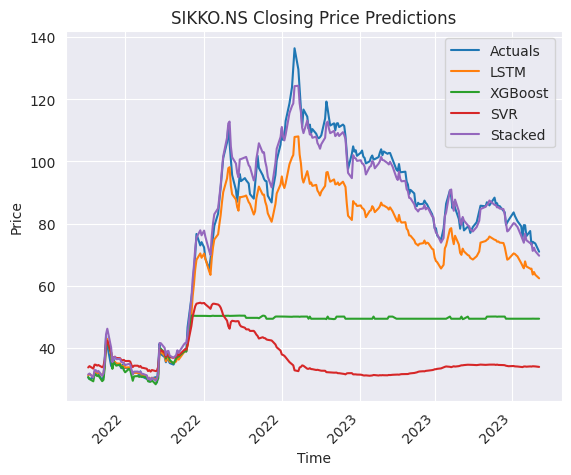

-------------------------------------------------------
Forecasting ALKALI.NS in Chemicals sector
Epoch 1/50
60/60 [==============================] - 7s 30ms/step - loss: 0.0469 - val_loss: 0.0317
Epoch 2/50
60/60 [==============================] - 1s 10ms/step - loss: 0.0063 - val_loss: 0.0070
Epoch 3/50
60/60 [==============================] - 0s 8ms/step - loss: 0.0043 - val_loss: 0.0040
Epoch 4/50
60/60 [==============================] - 0s 8ms/step - loss: 0.0035 - val_loss: 0.0023
Epoch 5/50
60/60 [==============================] - 0s 7ms/step - loss: 0.0030 - val_loss: 0.0020
Epoch 6/50
60/60 [==============================] - 0s 8ms/step - loss: 0.0026 - val_loss: 0.0012
Epoch 7/50
60/60 [==============================] - 0s 8ms/step - loss: 0.0023 - val_loss: 0.0012
Epoch 8/50
60/60 [==============================] - 0s 7ms/step - loss: 0.0020 - val_loss: 0.0026
Epoch 9/50
60/60 [==============================] - 0s 8ms/step - loss: 0.0017 - val_loss: 0.0013
Epoch 10/50
60/60 

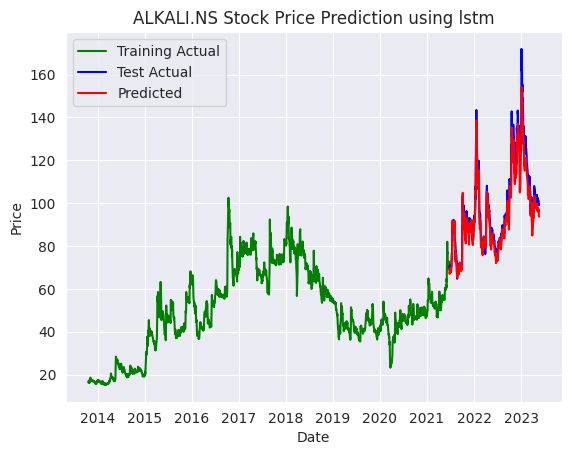

LSTM RMSE: 4.4268
RMSE for ALKALI.NS using LSTM: 4.426783527141665
Fitting 5 folds for each of 27 candidates, totalling 135 fits
Best hyperparameters:  {'learning_rate': 0.1, 'max_depth': 7, 'n_estimators': 50}
Best score:  0.937514704777923
Mean Squared Error for XGBoost: 373.2988


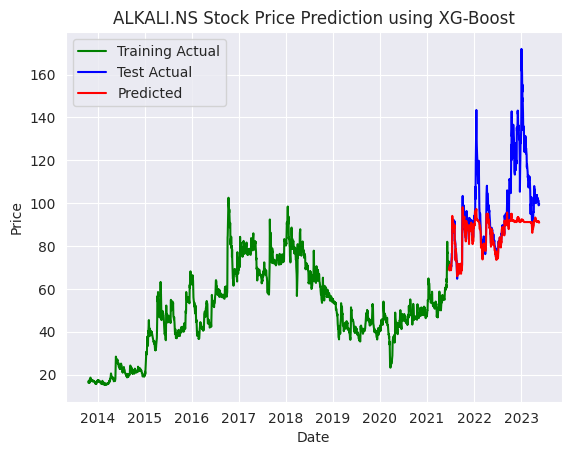

XGB RMSE: 19.3209
RMSE for ALKALI.NS using XGBoost: 19.320941630885812


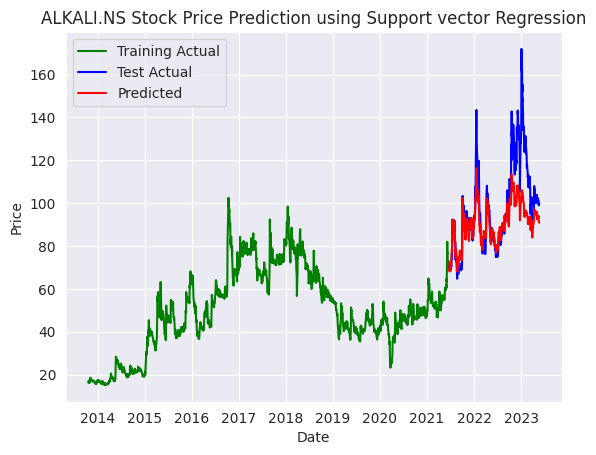

SVM RMSE: 14.3670
RMSE for ALKALI.NS using SVM: 14.367018969251454
15/15 [==============================] - 0s 3ms/step


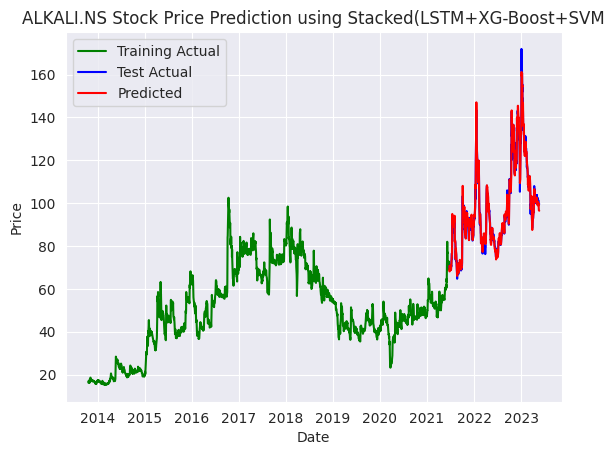

Stacked RMSE: 2.6989
RMSE for ALKALI.NS using Stacked Algorithm: 2.6988718188945042


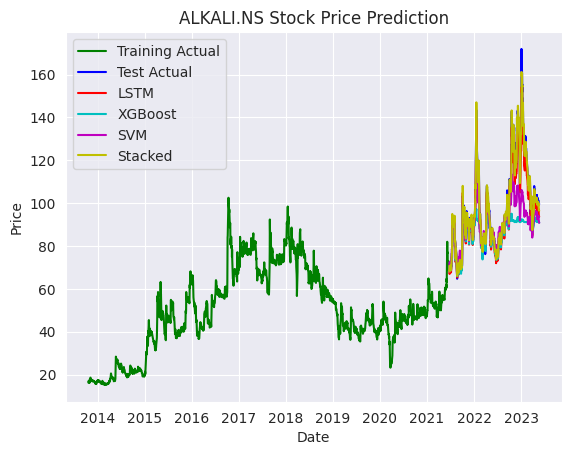

Model evaluation:
LSTM RMSE: 19.5964
LSTM MAE: 3.2038
LSTM R2 Score: 0.9529
XGBoost RMSE: 19.3209
XGBoost MAE: 11.5635
XGBoost R2 Score: 0.1025
SVM RMSE: 14.3670
SVM MAE: 8.8603
SVM R2 Score: 0.5037
Stacked RMSE: 2.6989
Stacked MAE: 1.8537
Stacked R2 Score: 0.9825


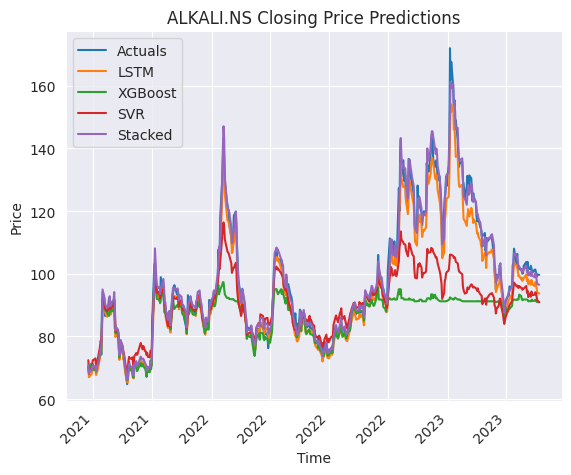

-------------------------------------------------------
Forecasting IITL.NS in Investment Banking & Investment Services sector
Epoch 1/50
59/59 [==============================] - 6s 22ms/step - loss: 0.0172 - val_loss: 0.0086
Epoch 2/50
59/59 [==============================] - 1s 9ms/step - loss: 0.0030 - val_loss: 0.0018
Epoch 3/50
59/59 [==============================] - 1s 9ms/step - loss: 0.0016 - val_loss: 5.7462e-04
Epoch 4/50
59/59 [==============================] - 1s 8ms/step - loss: 0.0014 - val_loss: 4.2546e-04
Epoch 5/50
59/59 [==============================] - 1s 8ms/step - loss: 0.0012 - val_loss: 5.6979e-04
Epoch 6/50
59/59 [==============================] - 0s 8ms/step - loss: 0.0011 - val_loss: 4.2782e-04
Epoch 7/50
59/59 [==============================] - 0s 8ms/step - loss: 8.8955e-04 - val_loss: 3.8872e-04
Epoch 8/50
59/59 [==============================] - 0s 8ms/step - loss: 9.1029e-04 - val_loss: 3.7539e-04
Epoch 9/50
59/59 [==============================] - 1s 9

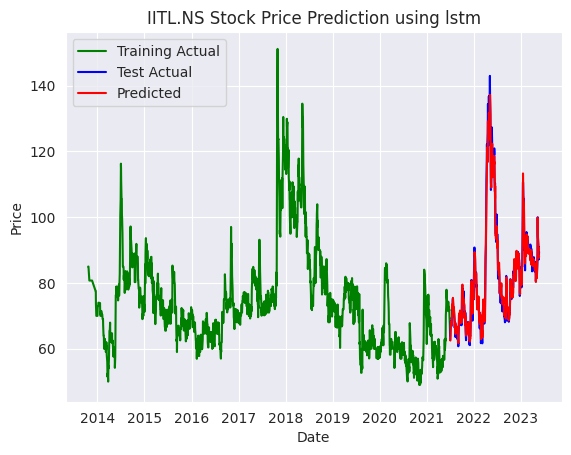

LSTM RMSE: 2.0209
RMSE for IITL.NS using LSTM: 2.0208842468328747
Fitting 5 folds for each of 27 candidates, totalling 135 fits
Best hyperparameters:  {'learning_rate': 0.1, 'max_depth': 7, 'n_estimators': 200}
Best score:  0.9639783458759146
Mean Squared Error for XGBoost: 3.5816


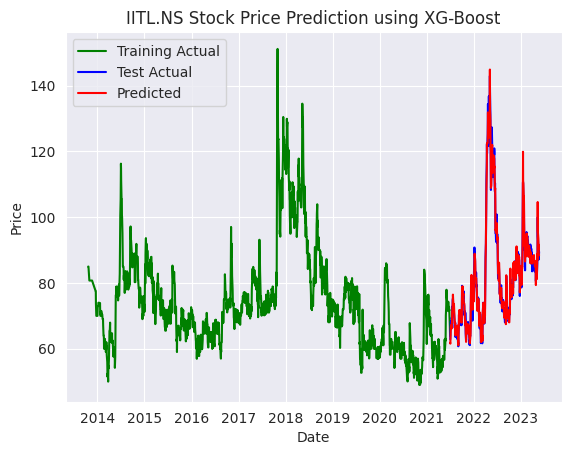

XGB RMSE: 1.8925
RMSE for IITL.NS using XGBoost: 1.8925228707450072


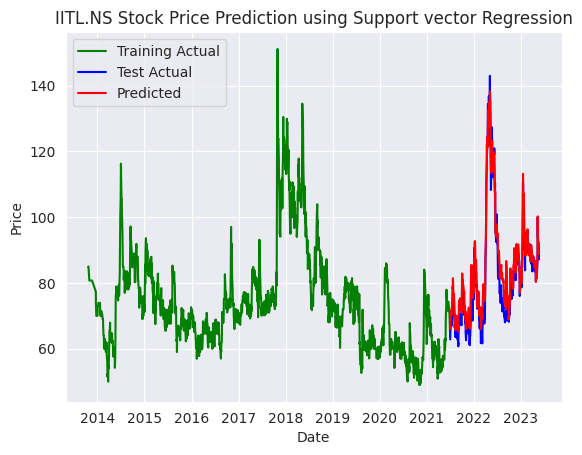

SVM RMSE: 3.7735
RMSE for IITL.NS using SVM: 3.773507788895338
15/15 [==============================] - 0s 3ms/step


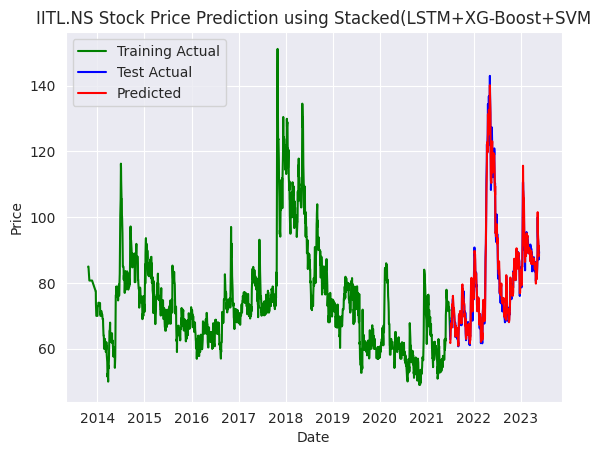

Stacked RMSE: 1.7860
RMSE for IITL.NS using Stacked Algorithm: 1.7860396911059149


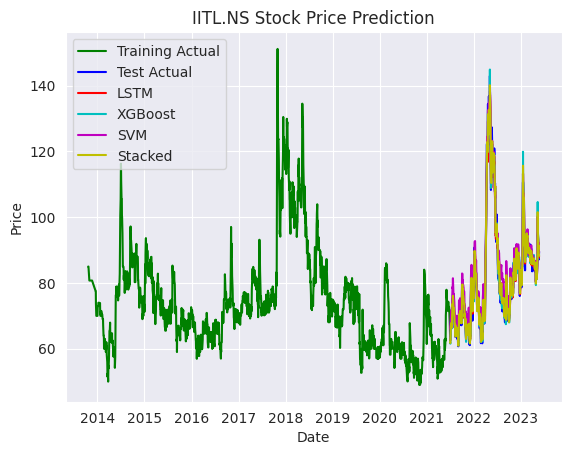

Model evaluation:
LSTM RMSE: 4.0840
LSTM MAE: 1.4449
LSTM R2 Score: 0.9849
XGBoost RMSE: 1.8925
XGBoost MAE: 1.3786
XGBoost R2 Score: 0.9868
SVM RMSE: 3.7735
SVM MAE: 3.1270
SVM R2 Score: 0.9474
Stacked RMSE: 1.7860
Stacked MAE: 1.3265
Stacked R2 Score: 0.9882


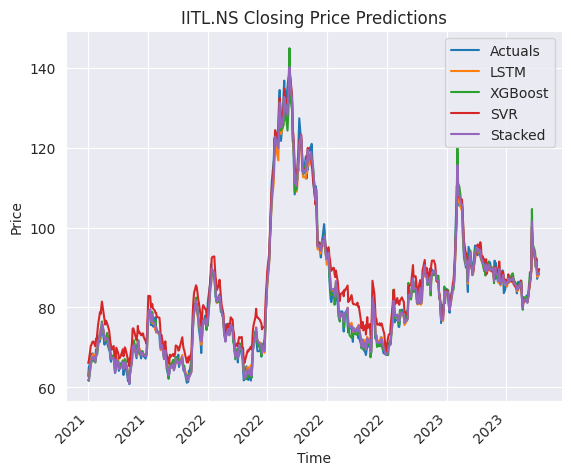

-------------------------------------------------------
Forecasting 21STCENMGM.NS in Investment Banking & Investment Services sector
Epoch 1/50
29/29 [==============================] - 7s 43ms/step - loss: 0.0517 - val_loss: 0.0042
Epoch 2/50
29/29 [==============================] - 0s 11ms/step - loss: 0.0106 - val_loss: 2.7374e-04
Epoch 3/50
29/29 [==============================] - 0s 10ms/step - loss: 0.0032 - val_loss: 0.0012
Epoch 4/50
29/29 [==============================] - 0s 11ms/step - loss: 0.0024 - val_loss: 6.4794e-04
Epoch 5/50
29/29 [==============================] - 0s 11ms/step - loss: 0.0022 - val_loss: 0.0020
Epoch 6/50
29/29 [==============================] - 0s 11ms/step - loss: 0.0019 - val_loss: 5.1320e-04
Epoch 7/50
29/29 [==============================] - 0s 12ms/step - loss: 0.0017 - val_loss: 3.6066e-04
Epoch 8/50
29/29 [==============================] - 0s 10ms/step - loss: 0.0014 - val_loss: 2.3693e-04
Epoch 9/50
29/29 [==============================] - 0s 

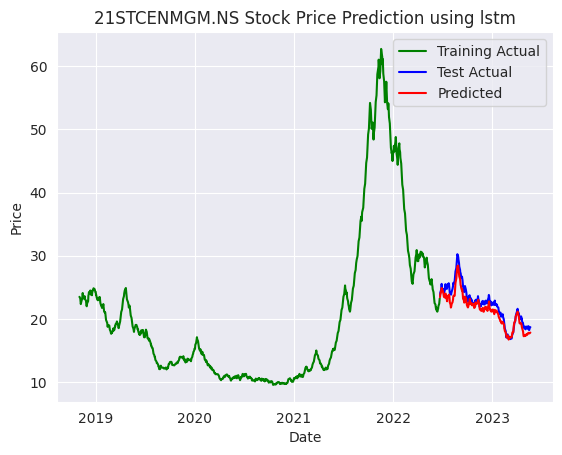

LSTM RMSE: 1.1373
RMSE for 21STCENMGM.NS using LSTM: 1.1372951649902663
Fitting 5 folds for each of 27 candidates, totalling 135 fits
Best hyperparameters:  {'learning_rate': 0.1, 'max_depth': 7, 'n_estimators': 50}
Best score:  0.8499052936062818
Mean Squared Error for XGBoost: 0.0966


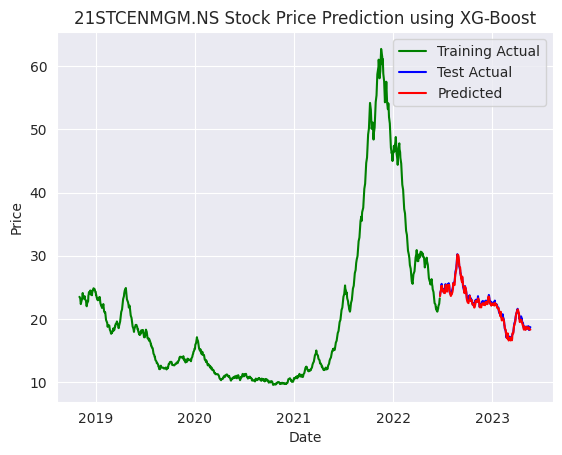

XGB RMSE: 0.3108
RMSE for 21STCENMGM.NS using XGBoost: 0.3107517815200462


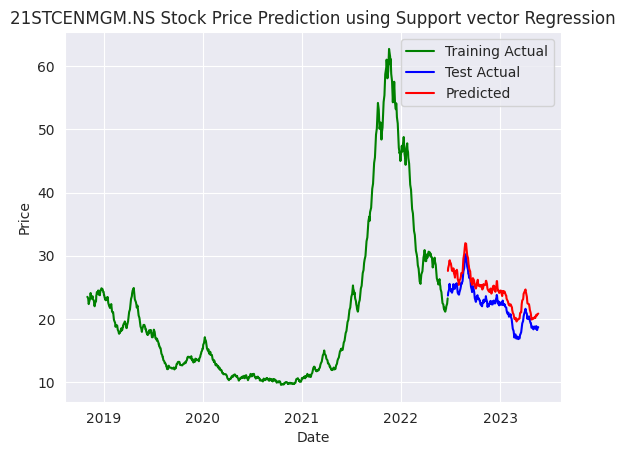

SVM RMSE: 2.3424
RMSE for 21STCENMGM.NS using SVM: 2.342420722247555
8/8 [==============================] - 0s 5ms/step


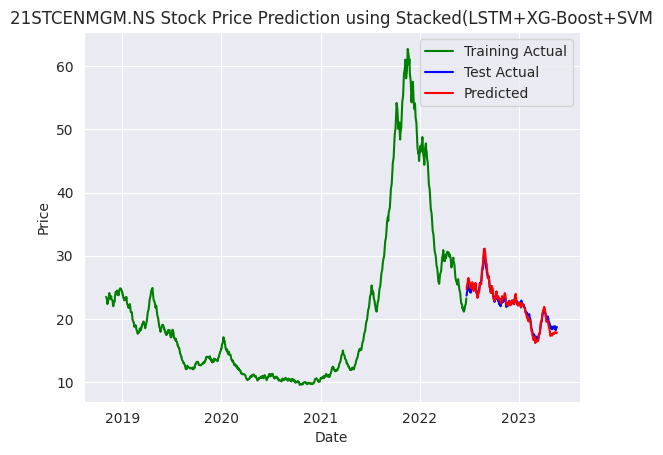

Stacked RMSE: 0.5589
RMSE for 21STCENMGM.NS using Stacked Algorithm: 0.5589283964561048


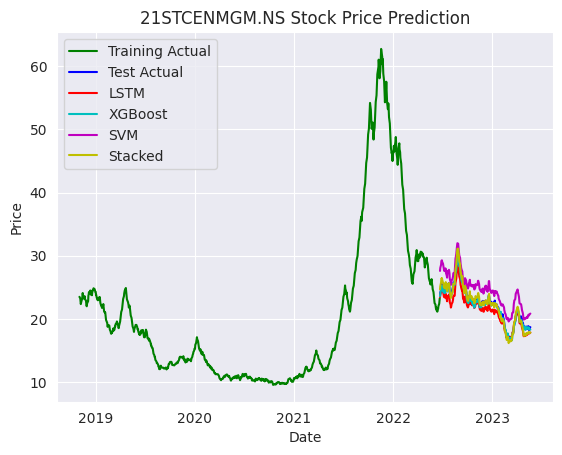

Model evaluation:
LSTM RMSE: 1.2934
LSTM MAE: 0.9759
LSTM R2 Score: 0.8519
XGBoost RMSE: 0.3108
XGBoost MAE: 0.2456
XGBoost R2 Score: 0.9889
SVM RMSE: 2.3424
SVM MAE: 2.2336
SVM R2 Score: 0.3716
Stacked RMSE: 0.5589
Stacked MAE: 0.4401
Stacked R2 Score: 0.9642


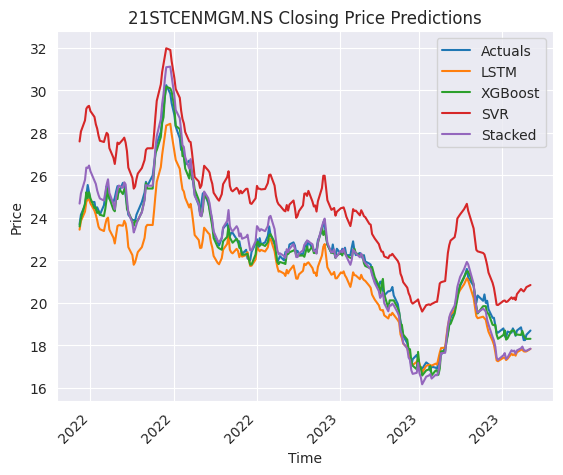

-------------------------------------------------------
Forecasting DBSTOCKBRO.NS in Investment Banking & Investment Services sector
Epoch 1/50
56/56 [==============================] - 6s 36ms/step - loss: 0.0361 - val_loss: 0.0063
Epoch 2/50
56/56 [==============================] - 1s 11ms/step - loss: 0.0032 - val_loss: 0.0037
Epoch 3/50
56/56 [==============================] - 1s 10ms/step - loss: 0.0024 - val_loss: 0.0016
Epoch 4/50
56/56 [==============================] - 1s 9ms/step - loss: 0.0021 - val_loss: 0.0018
Epoch 5/50
56/56 [==============================] - 0s 9ms/step - loss: 0.0016 - val_loss: 0.0018
Epoch 6/50
56/56 [==============================] - 1s 9ms/step - loss: 0.0015 - val_loss: 0.0011
Epoch 7/50
56/56 [==============================] - 0s 9ms/step - loss: 0.0015 - val_loss: 0.0011
Epoch 8/50
56/56 [==============================] - 0s 8ms/step - loss: 0.0014 - val_loss: 9.4038e-04
Epoch 9/50
56/56 [==============================] - 1s 9ms/step - loss: 0.00

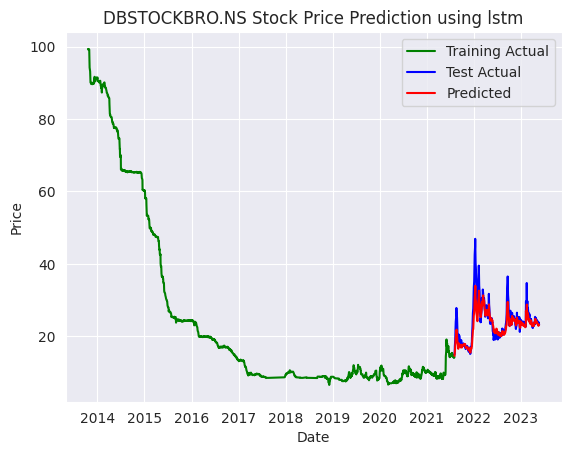

LSTM RMSE: 2.6301
RMSE for DBSTOCKBRO.NS using LSTM: 2.630067620335375
Fitting 5 folds for each of 27 candidates, totalling 135 fits
Best hyperparameters:  {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 200}
Best score:  0.0547251591680223
Mean Squared Error for XGBoost: 0.7353


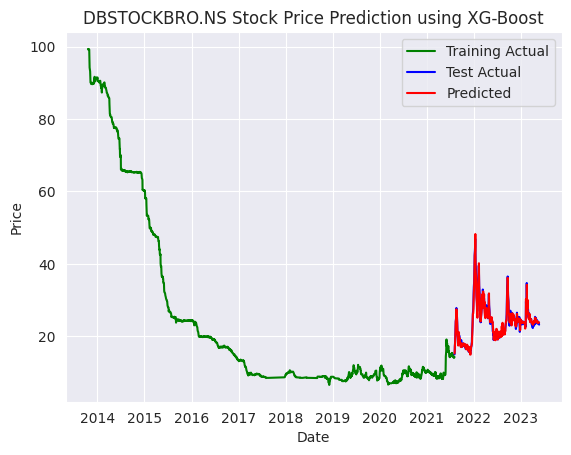

XGB RMSE: 0.8575
RMSE for DBSTOCKBRO.NS using XGBoost: 0.857512714970847


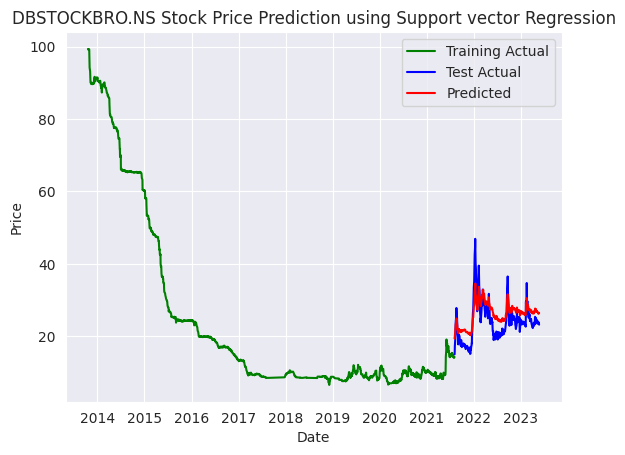

SVM RMSE: 3.5342
RMSE for DBSTOCKBRO.NS using SVM: 3.534238213932302
14/14 [==============================] - 0s 3ms/step


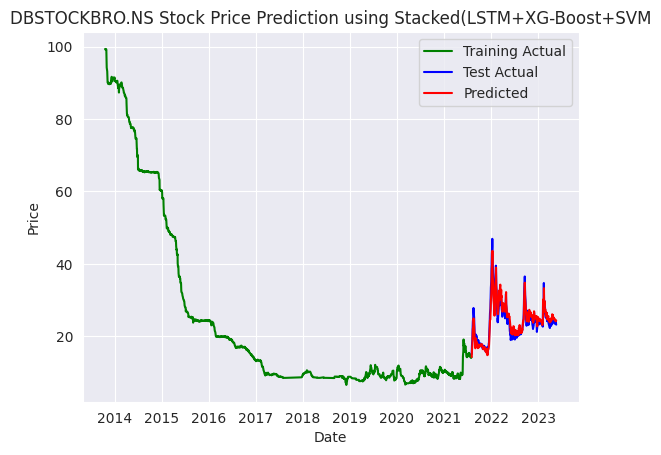

Stacked RMSE: 1.3679
RMSE for DBSTOCKBRO.NS using Stacked Algorithm: 1.3678972444800823


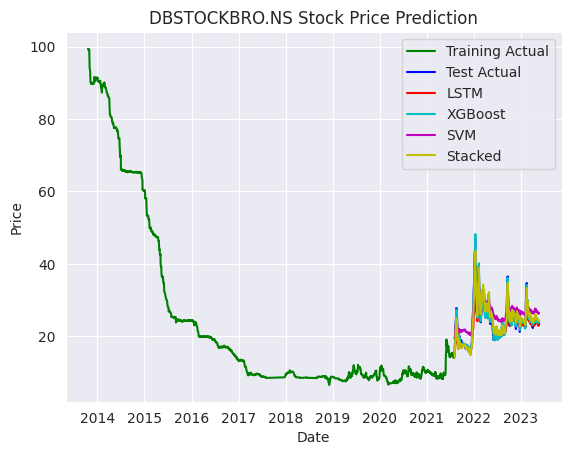

Model evaluation:
LSTM RMSE: 6.9173
LSTM MAE: 1.5119
LSTM R2 Score: 0.7476
XGBoost RMSE: 0.8575
XGBoost MAE: 0.5912
XGBoost R2 Score: 0.9732
SVM RMSE: 3.5342
SVM MAE: 3.1295
SVM R2 Score: 0.5443
Stacked RMSE: 1.3679
Stacked MAE: 1.0707
Stacked R2 Score: 0.9317


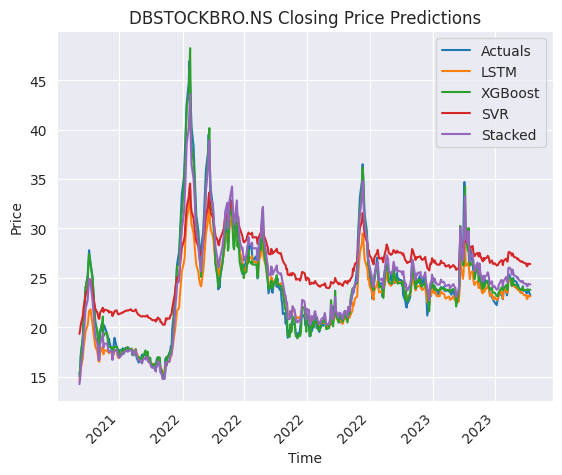

-------------------------------------------------------
Forecasting HBSL.NS in Investment Banking & Investment Services sector
Epoch 1/50
57/57 [==============================] - 6s 25ms/step - loss: 0.0191 - val_loss: 0.0013
Epoch 2/50
57/57 [==============================] - 1s 11ms/step - loss: 0.0025 - val_loss: 2.2586e-04
Epoch 3/50
57/57 [==============================] - 1s 11ms/step - loss: 0.0016 - val_loss: 2.2558e-04
Epoch 4/50
57/57 [==============================] - 1s 10ms/step - loss: 0.0012 - val_loss: 1.3063e-04
Epoch 5/50
57/57 [==============================] - 1s 12ms/step - loss: 8.8540e-04 - val_loss: 1.2817e-04
Epoch 6/50
57/57 [==============================] - 1s 13ms/step - loss: 8.6985e-04 - val_loss: 1.4013e-04
Epoch 7/50
15/15 [==============================] - 1s 4ms/step


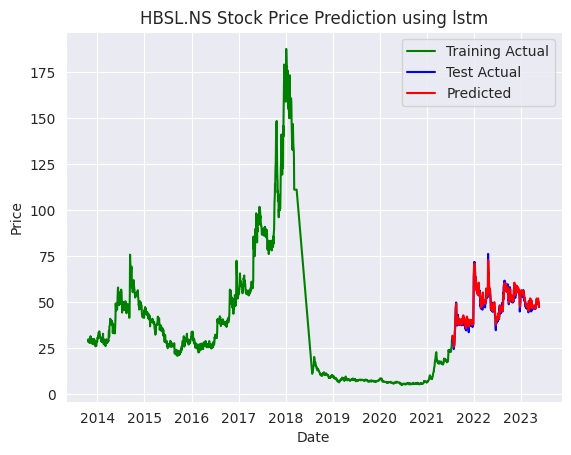

LSTM RMSE: 1.5611
RMSE for HBSL.NS using LSTM: 1.561095650979957
Fitting 5 folds for each of 27 candidates, totalling 135 fits
Best hyperparameters:  {'learning_rate': 0.1, 'max_depth': 7, 'n_estimators': 100}
Best score:  0.7408144795374301
Mean Squared Error for XGBoost: 1.4570


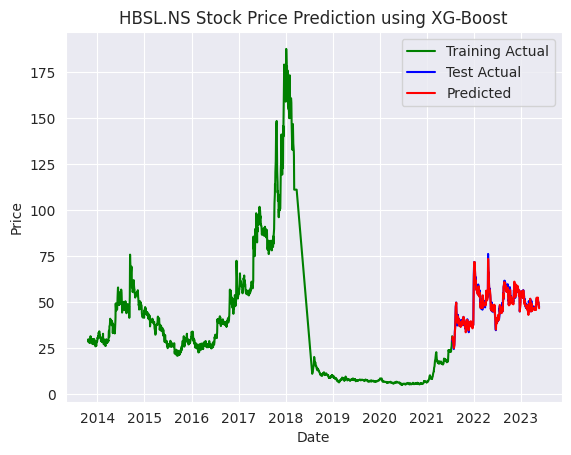

XGB RMSE: 1.2071
RMSE for HBSL.NS using XGBoost: 1.2070541482277048


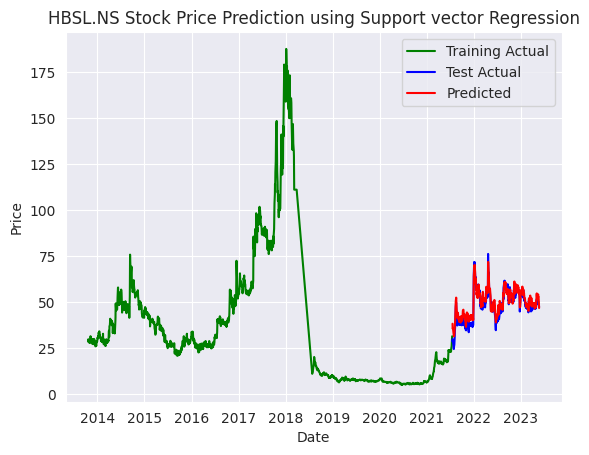

SVM RMSE: 2.7543
RMSE for HBSL.NS using SVM: 2.75434215986944
15/15 [==============================] - 0s 3ms/step


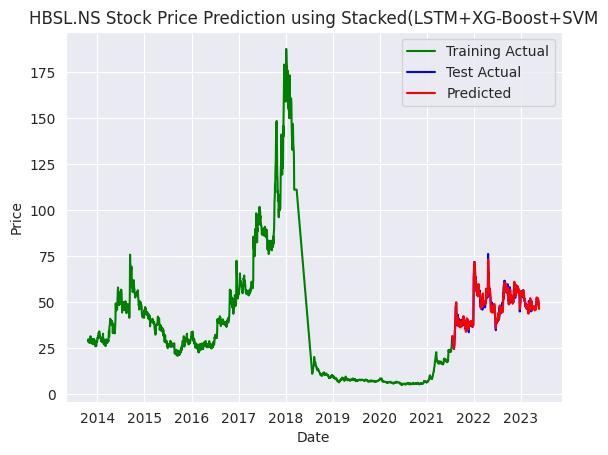

Stacked RMSE: 1.3159
RMSE for HBSL.NS using Stacked Algorithm: 1.3159346678471522


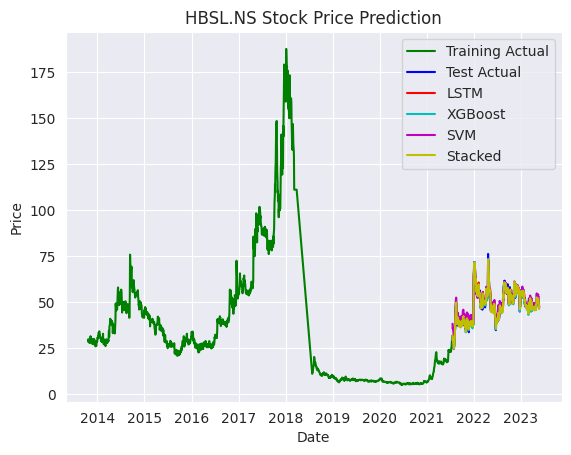

Model evaluation:
LSTM RMSE: 2.4370
LSTM MAE: 1.2426
LSTM R2 Score: 0.9649
XGBoost RMSE: 1.2071
XGBoost MAE: 0.9194
XGBoost R2 Score: 0.9790
SVM RMSE: 2.7543
SVM MAE: 2.2885
SVM R2 Score: 0.8907
Stacked RMSE: 1.3159
Stacked MAE: 1.0003
Stacked R2 Score: 0.9751


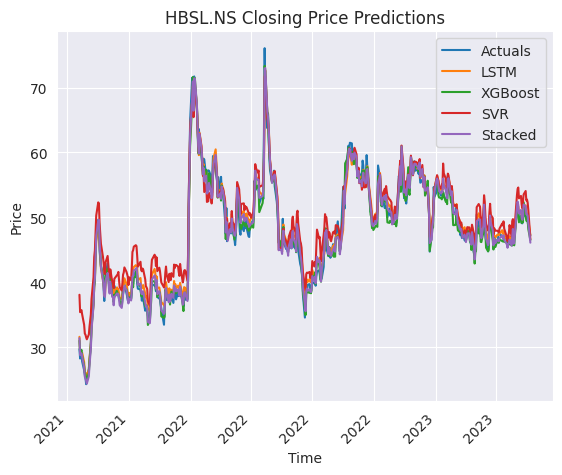

-------------------------------------------------------
Forecasting INDBANK.NS in Investment Banking & Investment Services sector
Epoch 1/50
60/60 [==============================] - 7s 26ms/step - loss: 0.0176 - val_loss: 0.0060
Epoch 2/50
60/60 [==============================] - 1s 10ms/step - loss: 0.0026 - val_loss: 0.0029
Epoch 3/50
60/60 [==============================] - 1s 10ms/step - loss: 0.0015 - val_loss: 0.0012
Epoch 4/50
60/60 [==============================] - 1s 10ms/step - loss: 0.0011 - val_loss: 0.0020
Epoch 5/50
60/60 [==============================] - 1s 10ms/step - loss: 9.9172e-04 - val_loss: 0.0013
Epoch 6/50
60/60 [==============================] - 1s 10ms/step - loss: 0.0010 - val_loss: 0.0014
Epoch 7/50
60/60 [==============================] - 1s 11ms/step - loss: 8.1108e-04 - val_loss: 5.0317e-04
Epoch 8/50
60/60 [==============================] - 1s 13ms/step - loss: 7.7071e-04 - val_loss: 9.2563e-04
Epoch 9/50
60/60 [==============================] - 1s 14m

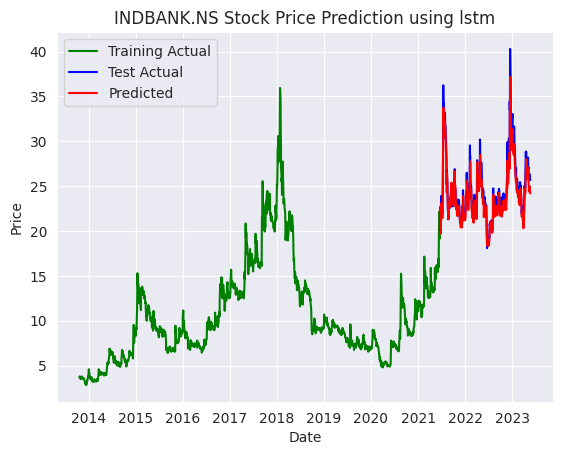

LSTM RMSE: 0.9815
RMSE for INDBANK.NS using LSTM: 0.9814857932923564
Fitting 5 folds for each of 27 candidates, totalling 135 fits
Best hyperparameters:  {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 200}
Best score:  0.9244179076249438
Mean Squared Error for XGBoost: 0.5118


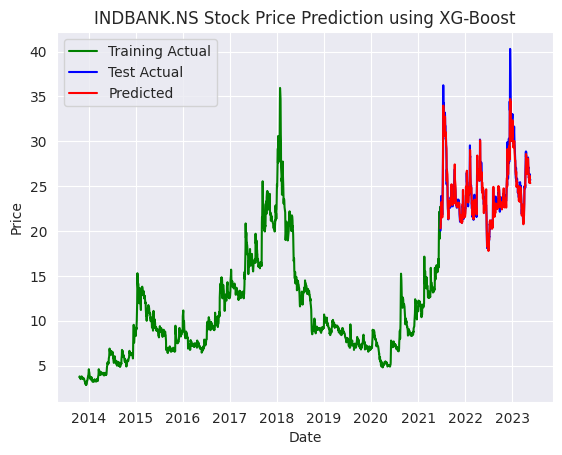

XGB RMSE: 0.7154
RMSE for INDBANK.NS using XGBoost: 0.7153832225171631


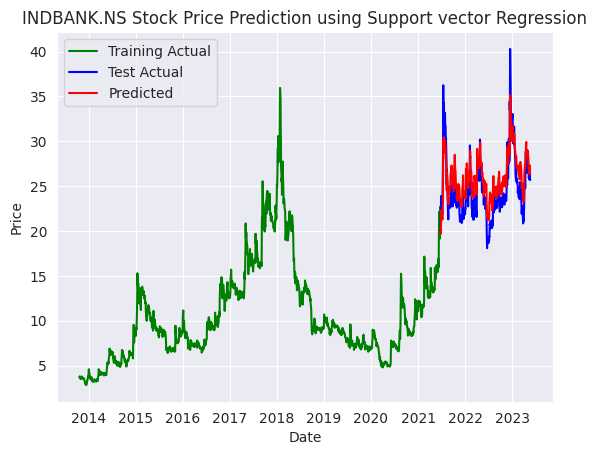

SVM RMSE: 2.0000
RMSE for INDBANK.NS using SVM: 2.0000096456030954
15/15 [==============================] - 0s 4ms/step


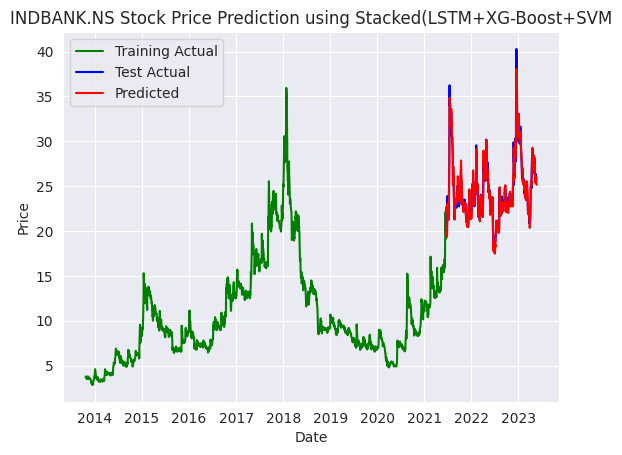

Stacked RMSE: 0.6631
RMSE for INDBANK.NS using Stacked Algorithm: 0.6631266711288561


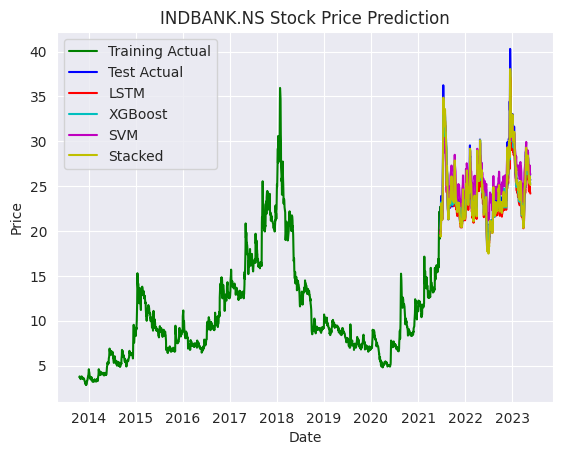

Model evaluation:
LSTM RMSE: 0.9633
LSTM MAE: 0.7527
LSTM R2 Score: 0.9154
XGBoost RMSE: 0.7154
XGBoost MAE: 0.4652
XGBoost R2 Score: 0.9551
SVM RMSE: 2.0000
SVM MAE: 1.8164
SVM R2 Score: 0.6487
Stacked RMSE: 0.6631
Stacked MAE: 0.4873
Stacked R2 Score: 0.9614


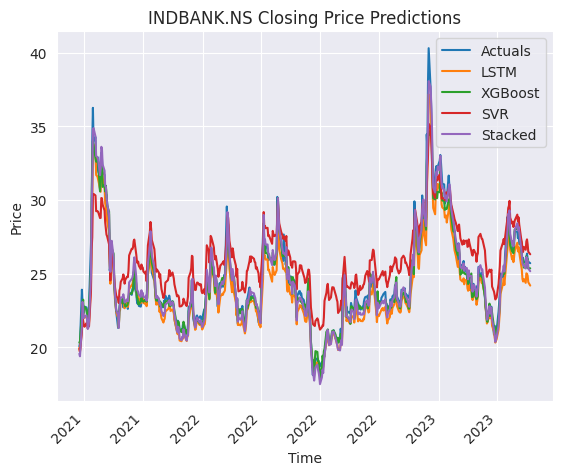

-------------------------------------------------------
Forecasting AMJLAND.NS in Real Estate Operations sector
Epoch 1/50
60/60 [==============================] - 6s 24ms/step - loss: 0.0262 - val_loss: 0.0074
Epoch 2/50
60/60 [==============================] - 1s 9ms/step - loss: 0.0042 - val_loss: 4.8250e-04
Epoch 3/50
60/60 [==============================] - 1s 9ms/step - loss: 0.0020 - val_loss: 0.0012
Epoch 4/50
60/60 [==============================] - 1s 9ms/step - loss: 0.0014 - val_loss: 2.6863e-04
Epoch 5/50
60/60 [==============================] - 1s 10ms/step - loss: 0.0013 - val_loss: 2.9990e-04
Epoch 6/50
60/60 [==============================] - 1s 9ms/step - loss: 0.0011 - val_loss: 2.8156e-04
Epoch 7/50
60/60 [==============================] - 1s 12ms/step - loss: 9.6046e-04 - val_loss: 2.0343e-04
Epoch 8/50
60/60 [==============================] - 1s 11ms/step - loss: 9.5001e-04 - val_loss: 1.9454e-04
Epoch 9/50
60/60 [==============================] - 1s 11ms/step - l

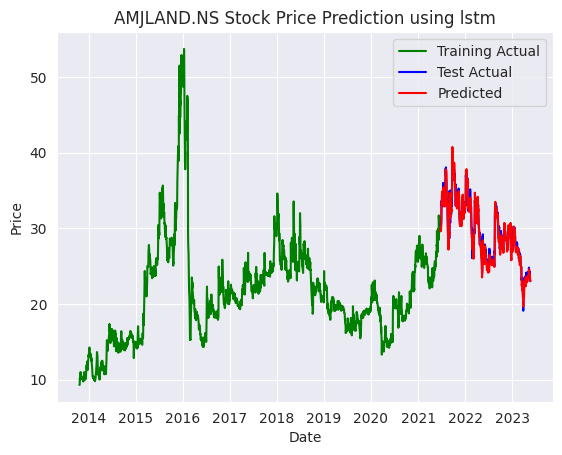

LSTM RMSE: 0.6641
RMSE for AMJLAND.NS using LSTM: 0.6640658007546384
Fitting 5 folds for each of 27 candidates, totalling 135 fits
Best hyperparameters:  {'learning_rate': 0.1, 'max_depth': 7, 'n_estimators': 200}
Best score:  0.8807147657203951
Mean Squared Error for XGBoost: 0.5510


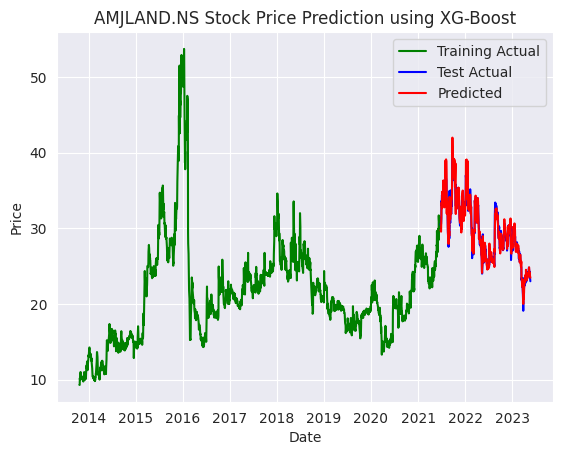

XGB RMSE: 0.7423
RMSE for AMJLAND.NS using XGBoost: 0.7422652883729546


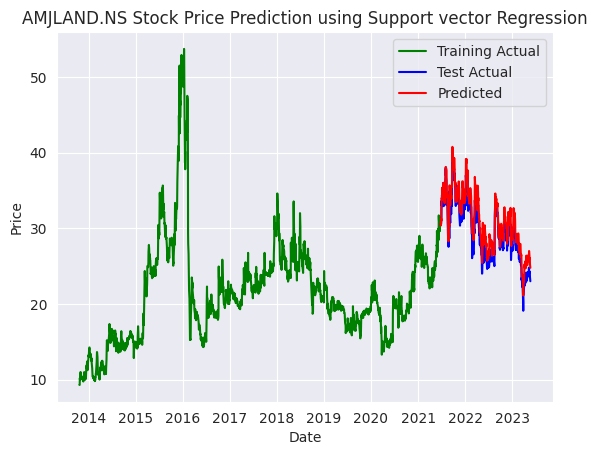

SVM RMSE: 1.5848
RMSE for AMJLAND.NS using SVM: 1.5847509317640742
15/15 [==============================] - 0s 4ms/step


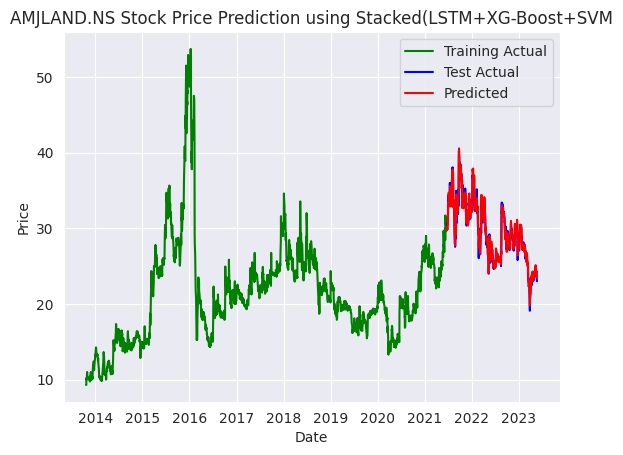

Stacked RMSE: 0.5755
RMSE for AMJLAND.NS using Stacked Algorithm: 0.5754721307644723


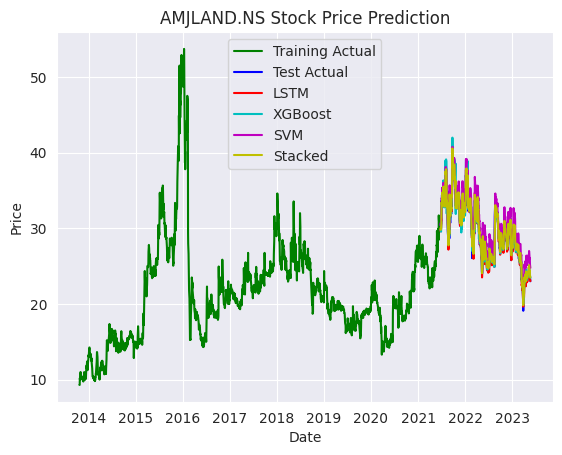

Model evaluation:
LSTM RMSE: 0.4410
LSTM MAE: 0.4981
LSTM R2 Score: 0.9714
XGBoost RMSE: 0.7423
XGBoost MAE: 0.4933
XGBoost R2 Score: 0.9643
SVM RMSE: 1.5848
SVM MAE: 1.4308
SVM R2 Score: 0.8371
Stacked RMSE: 0.5755
Stacked MAE: 0.4251
Stacked R2 Score: 0.9785


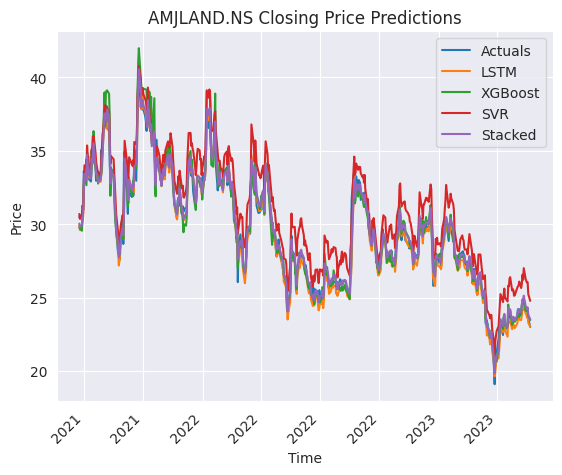

-------------------------------------------------------
Forecasting PANSARI.NS in Real Estate Operations sector
Epoch 1/50
21/21 [==============================] - 6s 59ms/step - loss: 0.0497 - val_loss: 0.0018
Epoch 2/50
21/21 [==============================] - 0s 11ms/step - loss: 0.0200 - val_loss: 0.0012
Epoch 3/50
21/21 [==============================] - 0s 12ms/step - loss: 0.0051 - val_loss: 0.0011
Epoch 4/50
21/21 [==============================] - 0s 10ms/step - loss: 0.0037 - val_loss: 5.7852e-04
Epoch 5/50
21/21 [==============================] - 0s 11ms/step - loss: 0.0027 - val_loss: 5.6099e-04
Epoch 6/50
21/21 [==============================] - 0s 11ms/step - loss: 0.0027 - val_loss: 3.7276e-04
Epoch 7/50
21/21 [==============================] - 0s 11ms/step - loss: 0.0028 - val_loss: 5.4499e-04
Epoch 8/50
21/21 [==============================] - 0s 11ms/step - loss: 0.0020 - val_loss: 2.4921e-04
Epoch 9/50
21/21 [==============================] - 0s 10ms/step - loss: 0.0

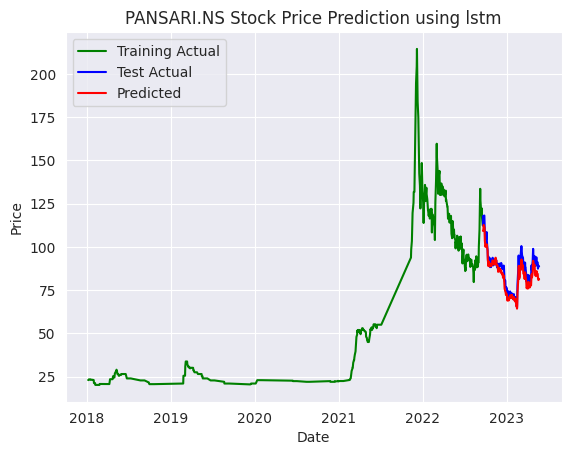

LSTM RMSE: 4.1988
RMSE for PANSARI.NS using LSTM: 4.1987749310265965
Fitting 5 folds for each of 27 candidates, totalling 135 fits
Best hyperparameters:  {'learning_rate': 0.1, 'max_depth': 5, 'n_estimators': 200}
Best score:  0.9584047916365979
Mean Squared Error for XGBoost: 14.0058


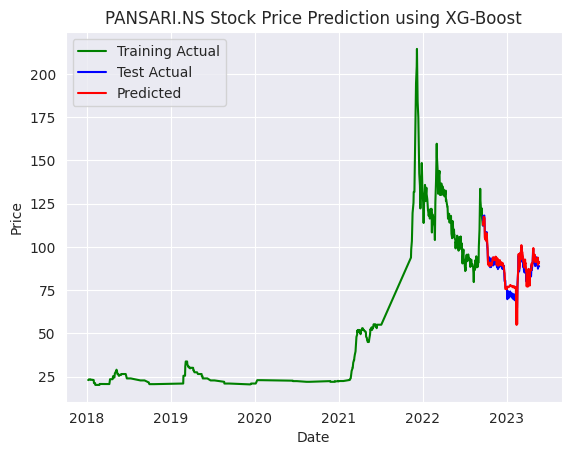

XGB RMSE: 3.7424
RMSE for PANSARI.NS using XGBoost: 3.742425991144037


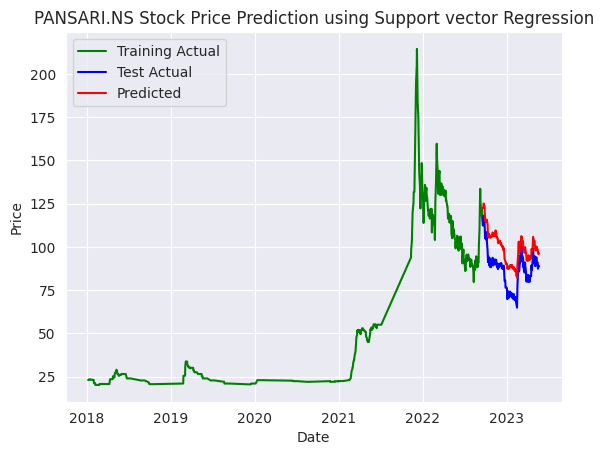

SVM RMSE: 12.9599
RMSE for PANSARI.NS using SVM: 12.95989028253551
6/6 [==============================] - 0s 3ms/step


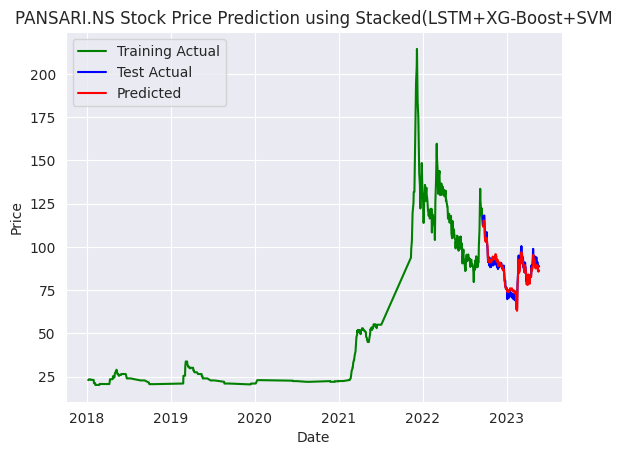

Stacked RMSE: 2.5606
RMSE for PANSARI.NS using Stacked Algorithm: 2.5605731217227277


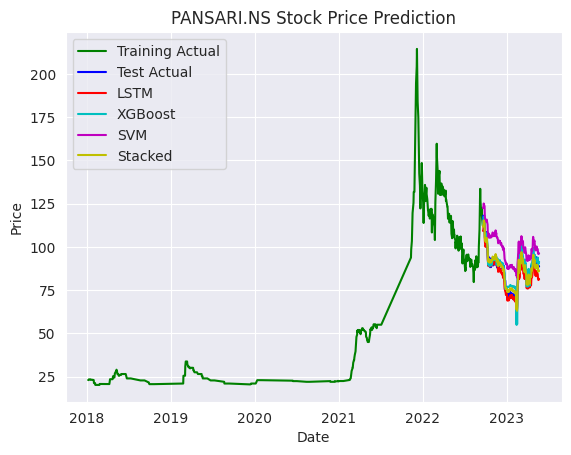

Model evaluation:
LSTM RMSE: 17.6297
LSTM MAE: 3.4541
LSTM R2 Score: 0.8495
XGBoost RMSE: 3.7424
XGBoost MAE: 2.8172
XGBoost R2 Score: 0.8804
SVM RMSE: 12.9599
SVM MAE: 12.4677
SVM R2 Score: -0.4341
Stacked RMSE: 2.5606
Stacked MAE: 2.1278
Stacked R2 Score: 0.9440


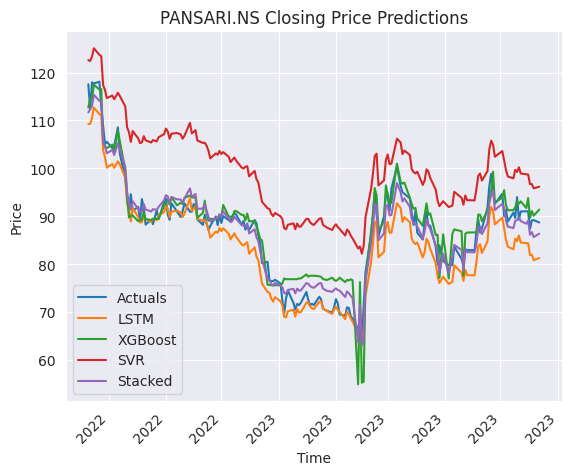

-------------------------------------------------------
Forecasting GEECEE.NS in Real Estate Operations sector
Epoch 1/50
60/60 [==============================] - 7s 41ms/step - loss: 0.0413 - val_loss: 0.0045
Epoch 2/50
60/60 [==============================] - 1s 11ms/step - loss: 0.0061 - val_loss: 0.0018
Epoch 3/50
60/60 [==============================] - 1s 12ms/step - loss: 0.0036 - val_loss: 4.7306e-04
Epoch 4/50
60/60 [==============================] - 1s 10ms/step - loss: 0.0028 - val_loss: 3.7836e-04
Epoch 5/50
60/60 [==============================] - 1s 10ms/step - loss: 0.0024 - val_loss: 4.8490e-04
Epoch 6/50
60/60 [==============================] - 1s 10ms/step - loss: 0.0020 - val_loss: 0.0014
Epoch 7/50
60/60 [==============================] - 1s 13ms/step - loss: 0.0021 - val_loss: 2.6652e-04
Epoch 8/50
60/60 [==============================] - 1s 11ms/step - loss: 0.0020 - val_loss: 2.6538e-04
Epoch 9/50
60/60 [==============================] - 1s 14ms/step - loss: 0.00

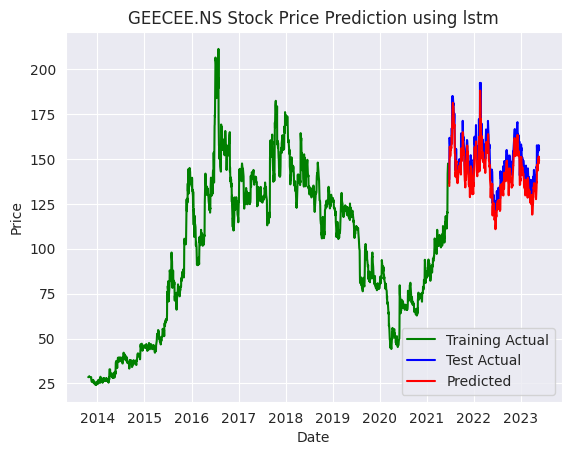

LSTM RMSE: 6.8356
RMSE for GEECEE.NS using LSTM: 6.83558991688931
Fitting 5 folds for each of 27 candidates, totalling 135 fits
Best hyperparameters:  {'learning_rate': 0.1, 'max_depth': 5, 'n_estimators': 50}
Best score:  0.543100755537053
Mean Squared Error for XGBoost: 7.4252


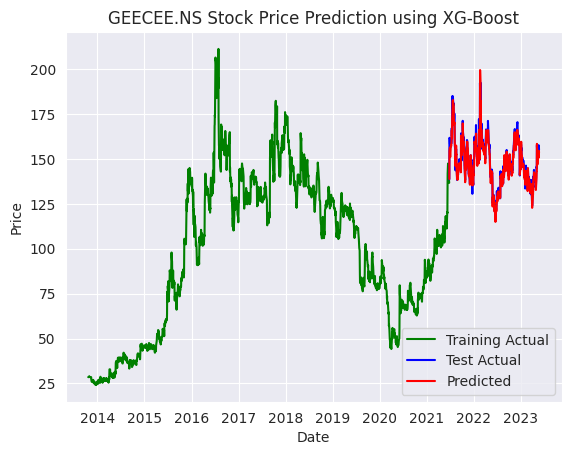

XGB RMSE: 2.7249
RMSE for GEECEE.NS using XGBoost: 2.7249280687669515


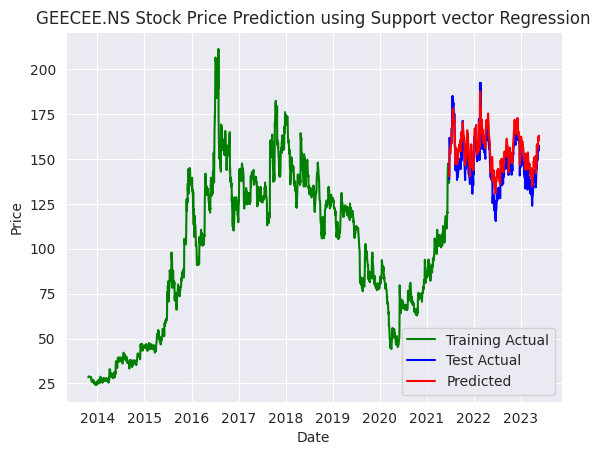

SVM RMSE: 7.5572
RMSE for GEECEE.NS using SVM: 7.557237948019563
15/15 [==============================] - 0s 3ms/step


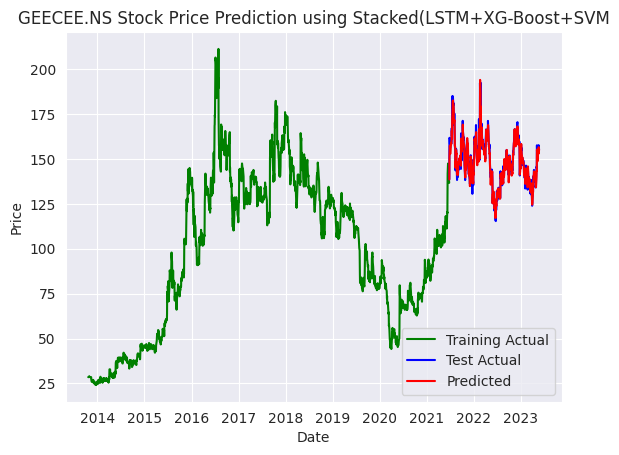

Stacked RMSE: 2.6033
RMSE for GEECEE.NS using Stacked Algorithm: 2.603290359311718


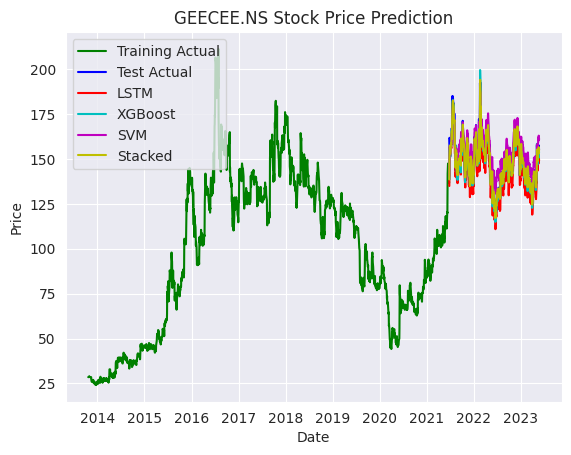

Model evaluation:
LSTM RMSE: 46.7253
LSTM MAE: 6.2062
LSTM R2 Score: 0.7115
XGBoost RMSE: 2.7249
XGBoost MAE: 1.9689
XGBoost R2 Score: 0.9542
SVM RMSE: 7.5572
SVM MAE: 6.6589
SVM R2 Score: 0.6474
Stacked RMSE: 2.6033
Stacked MAE: 1.8285
Stacked R2 Score: 0.9582


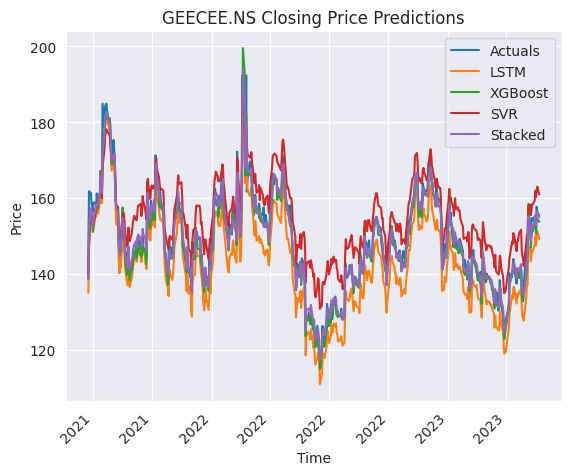

-------------------------------------------------------
Forecasting SUMIT.NS in Real Estate Operations sector
Epoch 1/50
24/24 [==============================] - 6s 51ms/step - loss: 0.0752 - val_loss: 0.4879
Epoch 2/50
24/24 [==============================] - 0s 10ms/step - loss: 0.0244 - val_loss: 0.2664
Epoch 3/50
24/24 [==============================] - 0s 11ms/step - loss: 0.0097 - val_loss: 0.0582
Epoch 4/50
24/24 [==============================] - 0s 10ms/step - loss: 0.0066 - val_loss: 0.0207
Epoch 5/50
24/24 [==============================] - 0s 10ms/step - loss: 0.0049 - val_loss: 0.0148
Epoch 6/50
24/24 [==============================] - 0s 10ms/step - loss: 0.0029 - val_loss: 0.0203
Epoch 7/50
24/24 [==============================] - 0s 10ms/step - loss: 0.0026 - val_loss: 0.0168
Epoch 8/50
24/24 [==============================] - 0s 10ms/step - loss: 0.0031 - val_loss: 0.0160
Epoch 9/50
24/24 [==============================] - 0s 10ms/step - loss: 0.0027 - val_loss: 0.0129

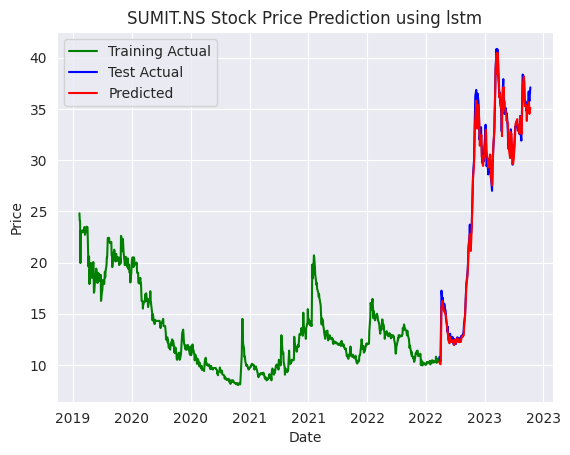

LSTM RMSE: 0.7049
RMSE for SUMIT.NS using LSTM: 0.7048737815116449
Fitting 5 folds for each of 27 candidates, totalling 135 fits
Best hyperparameters:  {'learning_rate': 1, 'max_depth': 3, 'n_estimators': 50}
Best score:  0.8280626698336941
Mean Squared Error for XGBoost: 57.4202


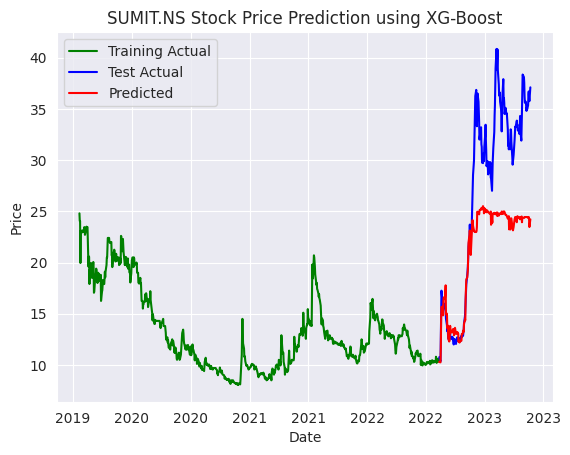

XGB RMSE: 7.5776
RMSE for SUMIT.NS using XGBoost: 7.577614163749361


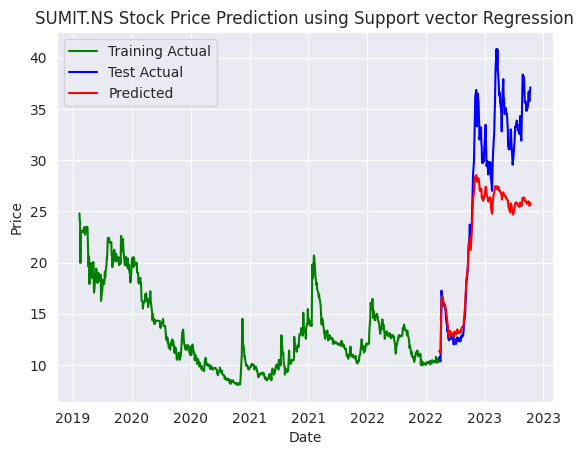

SVM RMSE: 6.0427
RMSE for SUMIT.NS using SVM: 6.04268644198153
6/6 [==============================] - 0s 3ms/step


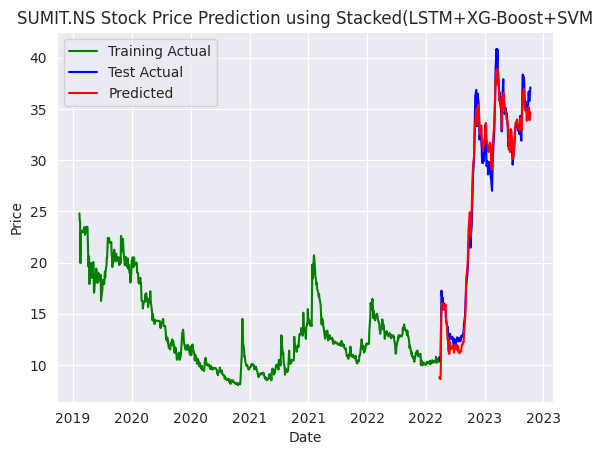

Stacked RMSE: 1.1498
RMSE for SUMIT.NS using Stacked Algorithm: 1.1498144188469117


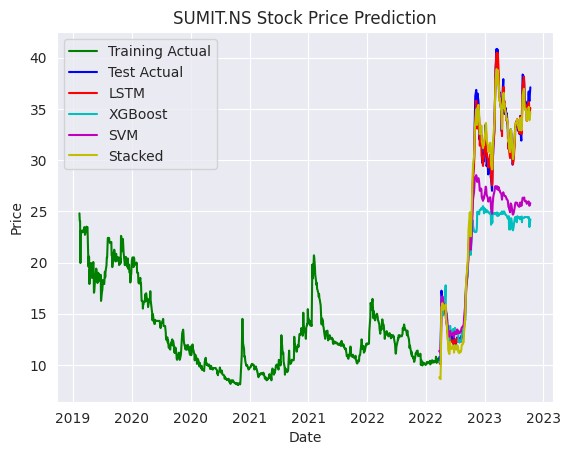

Model evaluation:
LSTM RMSE: 0.4968
LSTM MAE: 0.5423
LSTM R2 Score: 0.9944
XGBoost RMSE: 7.5776
XGBoost MAE: 5.9330
XGBoost R2 Score: 0.3543
SVM RMSE: 6.0427
SVM MAE: 4.6935
SVM R2 Score: 0.5894
Stacked RMSE: 1.1498
Stacked MAE: 0.9390
Stacked R2 Score: 0.9851


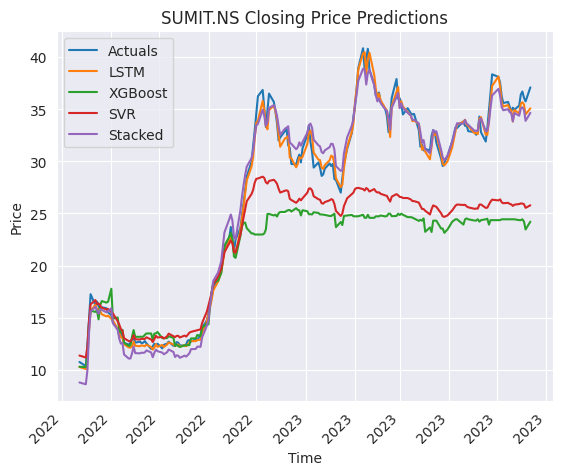

-------------------------------------------------------
Forecasting SHRADHA.NS in Real Estate Operations sector
Epoch 1/50
28/28 [==============================] - 8s 48ms/step - loss: 0.1260 - val_loss: 0.0804
Epoch 2/50
28/28 [==============================] - 0s 12ms/step - loss: 0.0260 - val_loss: 0.1244
Epoch 3/50
28/28 [==============================] - 0s 12ms/step - loss: 0.0161 - val_loss: 0.0462
Epoch 4/50
28/28 [==============================] - 0s 11ms/step - loss: 0.0092 - val_loss: 0.0069
Epoch 5/50
28/28 [==============================] - 0s 12ms/step - loss: 0.0054 - val_loss: 0.0070
Epoch 6/50
28/28 [==============================] - 0s 13ms/step - loss: 0.0045 - val_loss: 0.0120
Epoch 7/50
28/28 [==============================] - 0s 11ms/step - loss: 0.0043 - val_loss: 0.0053
Epoch 8/50
28/28 [==============================] - 0s 10ms/step - loss: 0.0038 - val_loss: 0.0090
Epoch 9/50
28/28 [==============================] - 0s 11ms/step - loss: 0.0038 - val_loss: 0.00

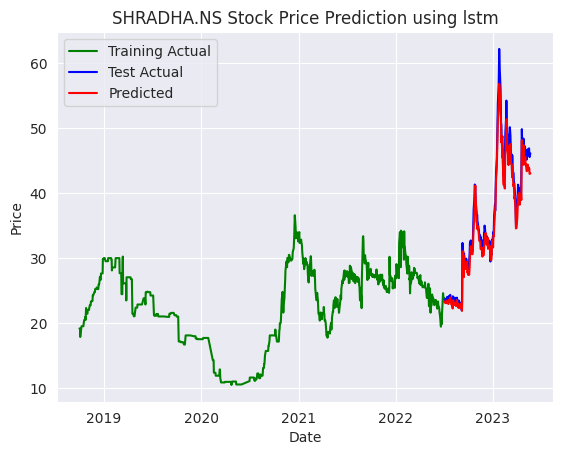

LSTM RMSE: 1.6350
RMSE for SHRADHA.NS using LSTM: 1.6349751079929493
Fitting 5 folds for each of 27 candidates, totalling 135 fits
Best hyperparameters:  {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 50}
Best score:  0.9646553161339586
Mean Squared Error for XGBoost: 82.8485


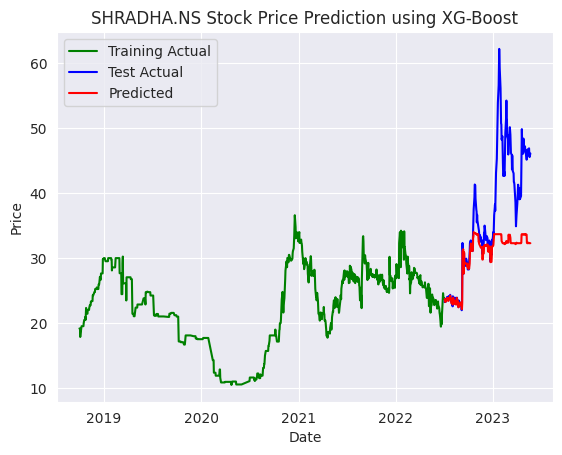

XGB RMSE: 9.1021
RMSE for SHRADHA.NS using XGBoost: 9.102113020995096


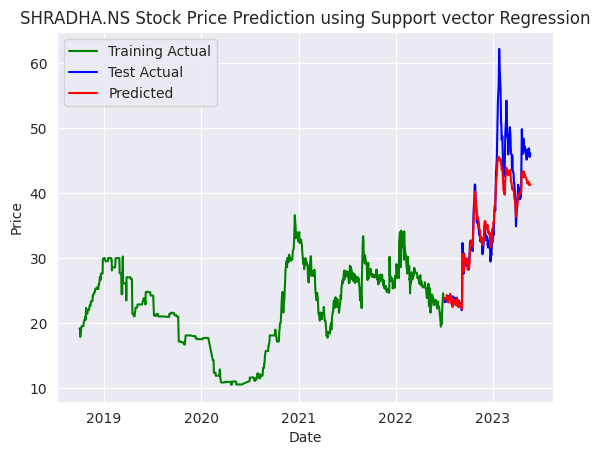

SVM RMSE: 3.5337
RMSE for SHRADHA.NS using SVM: 3.533671751017852
7/7 [==============================] - 0s 4ms/step


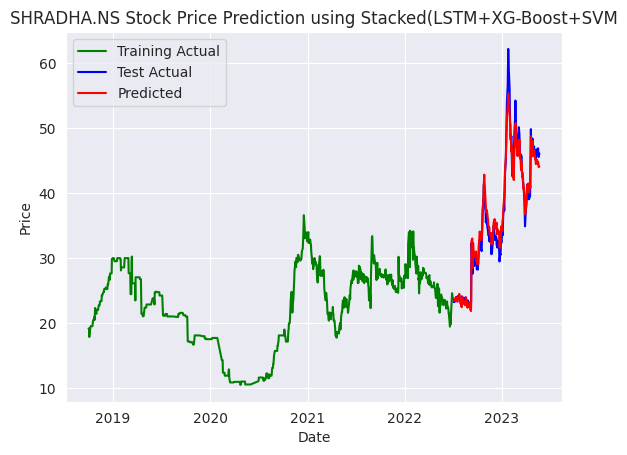

Stacked RMSE: 1.5348
RMSE for SHRADHA.NS using Stacked Algorithm: 1.5348374453989782


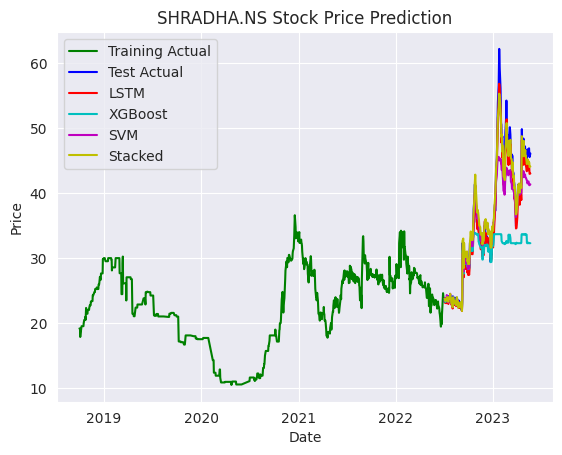

Model evaluation:
LSTM RMSE: 2.6731
LSTM MAE: 1.2526
LSTM R2 Score: 0.9711
XGBoost RMSE: 9.1021
XGBoost MAE: 6.0208
XGBoost R2 Score: 0.1039
SVM RMSE: 3.5337
SVM MAE: 2.2189
SVM R2 Score: 0.8649
Stacked RMSE: 1.5348
Stacked MAE: 1.1554
Stacked R2 Score: 0.9745


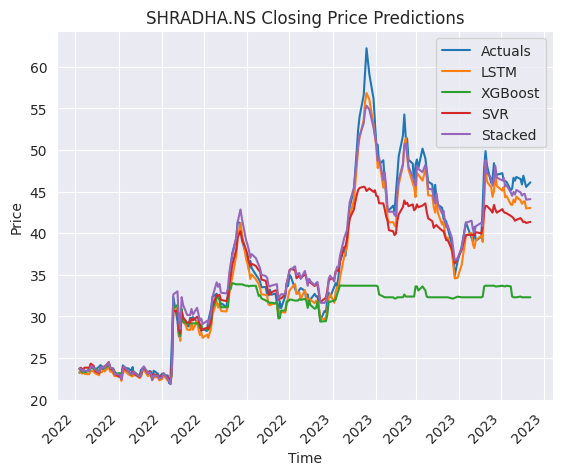

-------------------------------------------------------
Forecasting SILLYMONKS.NS in Media & Publishing sector
Epoch 1/50
28/28 [==============================] - 5s 43ms/step - loss: 0.0717 - val_loss: 0.0306
Epoch 2/50
28/28 [==============================] - 0s 10ms/step - loss: 0.0170 - val_loss: 0.0167
Epoch 3/50
28/28 [==============================] - 0s 10ms/step - loss: 0.0090 - val_loss: 0.0091
Epoch 4/50
28/28 [==============================] - 0s 10ms/step - loss: 0.0054 - val_loss: 0.0053
Epoch 5/50
28/28 [==============================] - 0s 11ms/step - loss: 0.0038 - val_loss: 0.0032
Epoch 6/50
28/28 [==============================] - 0s 12ms/step - loss: 0.0027 - val_loss: 0.0022
Epoch 7/50
28/28 [==============================] - 0s 12ms/step - loss: 0.0025 - val_loss: 0.0018
Epoch 8/50
28/28 [==============================] - 0s 13ms/step - loss: 0.0025 - val_loss: 0.0016
Epoch 9/50
28/28 [==============================] - 0s 13ms/step - loss: 0.0024 - val_loss: 0.001

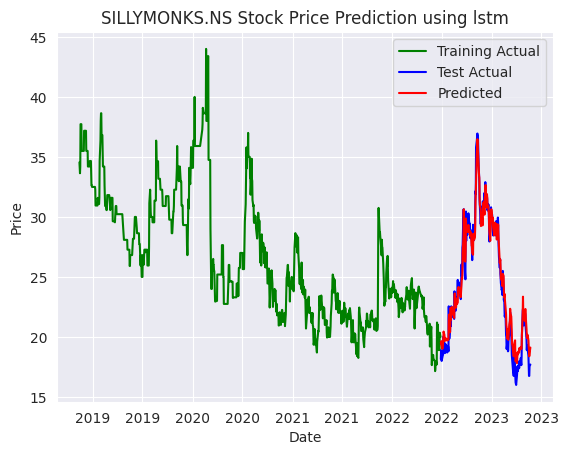

LSTM RMSE: 0.9440
RMSE for SILLYMONKS.NS using LSTM: 0.9439723069074933
Fitting 5 folds for each of 27 candidates, totalling 135 fits
Best hyperparameters:  {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 100}
Best score:  0.9368822485451297
Mean Squared Error for XGBoost: 0.4979


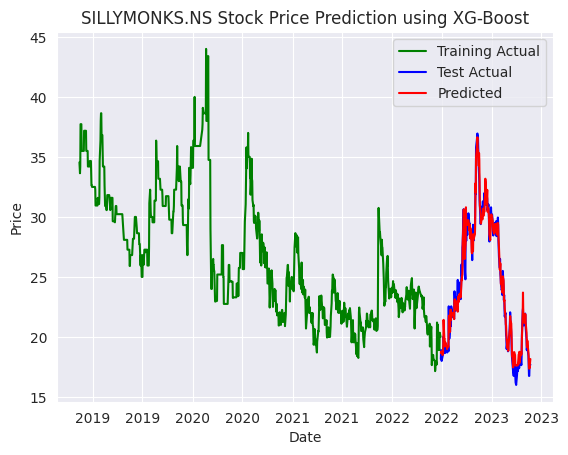

XGB RMSE: 0.7056
RMSE for SILLYMONKS.NS using XGBoost: 0.705617938401861


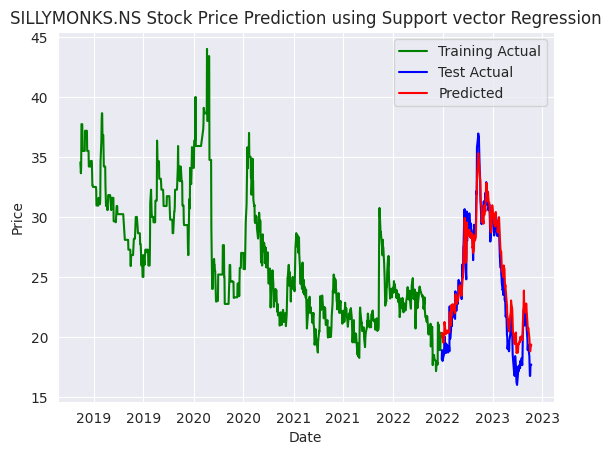

SVM RMSE: 1.3047
RMSE for SILLYMONKS.NS using SVM: 1.3047407142122416
7/7 [==============================] - 0s 4ms/step


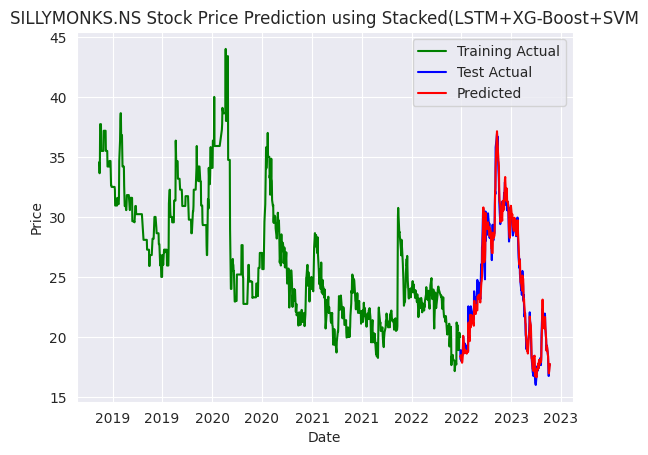

Stacked RMSE: 0.6853
RMSE for SILLYMONKS.NS using Stacked Algorithm: 0.6852831507592791


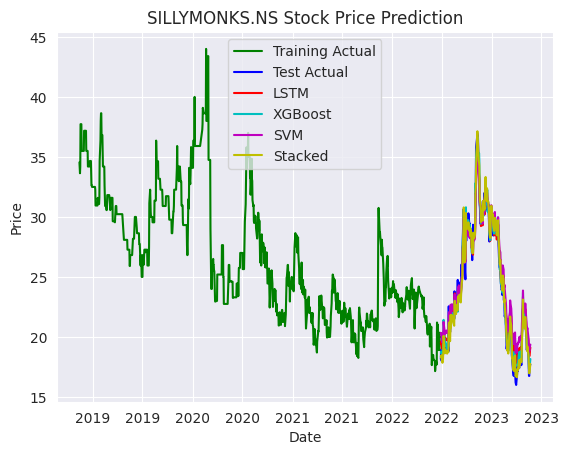

Model evaluation:
LSTM RMSE: 0.8911
LSTM MAE: 0.7579
LSTM R2 Score: 0.9679
XGBoost RMSE: 0.7056
XGBoost MAE: 0.5289
XGBoost R2 Score: 0.9821
SVM RMSE: 1.3047
SVM MAE: 1.0735
SVM R2 Score: 0.9387
Stacked RMSE: 0.6853
Stacked MAE: 0.5199
Stacked R2 Score: 0.9831


KeyboardInterrupt: ignored

In [46]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
import xgboost as xgb
from sklearn.svm import SVR
from sklearn.metrics import mean_squared_error
from keras.models import Sequential
from keras.layers import LSTM, Dense
from sklearn.ensemble import StackingRegressor
from keras.layers import Dropout
from xgboost import XGBRegressor
import matplotlib.dates as mdates
import xgboost as xgb
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from keras.models import Sequential
from keras.layers import Dense, LSTM, Dropout
from keras.callbacks import EarlyStopping
from tensorflow.keras.callbacks import Callback



# Function to reshape data for LSTM
def reshape_data(data):
    return np.reshape(data, (data.shape[0], 1, data.shape[1]))

# Function to compute RSI
def compute_RSI(data, window=14):
    delta = data.diff()
    gain = delta.where(delta > 0, 0)
    loss = -delta.where(delta < 0, 0)
    avg_gain = gain.rolling(window=window).mean()
    avg_loss = loss.rolling(window=window).mean()
    RS = avg_gain / avg_loss
    RSI = 100.0 - (100.0 / (1.0 + RS))
    return RSI

# pre-process data and train models for each stock
for sector, stocks in selected_stocks.items():
    for stock in stocks:
        print(f'Forecasting {stock} in {sector} sector')
        
        # get data for the stock
        stock_data = df_historical_data.loc[df_historical_data['ticker'] == stock]
        stock_data = stock_data.drop(['ticker', 'volume', 'adjclose'], axis=1)
        stock_data['MA50'] = stock_data['close'].rolling(window=50).mean()
        stock_data['MA200'] = stock_data['close'].rolling(window=200).mean()
        stock_data['RSI'] = compute_RSI(stock_data['close'])
        stock_data['Bollinger_upper'] = stock_data['MA50'] + 2 * stock_data['close'].rolling(window=50).std()
        stock_data['Bollinger_lower'] = stock_data['MA50'] - 2 * stock_data['close'].rolling(window=50).std()
        stock_data = stock_data.dropna()
        stock_data = stock_data.drop(['Sector'], axis=1) # drop sector column
        
        # split data into train and test sets
        X = stock_data.drop(['close'], axis=1)
        y = stock_data['close']
        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=False)
        
        # scale data using MinMaxScaler
        scaler = MinMaxScaler()
        X_train_scaled = scaler.fit_transform(X_train)
        X_test_scaled = scaler.transform(X_test)
        y_train_scaled = scaler.fit_transform(y_train.values.reshape(-1,1))
        y_test_scaled = scaler.transform(y_test.values.reshape(-1,1))
        
        # reshape data for LSTM
        X_train_reshaped = X_train_scaled.reshape((X_train_scaled.shape[0], 1, X_train_scaled.shape[1]))
        X_test_reshaped = X_test_scaled.reshape((X_test_scaled.shape[0], 1, X_test_scaled.shape[1]))

        model_lstm = Sequential()
        model_lstm.add(LSTM(50, return_sequences=True, input_shape= (1, X_train_scaled.shape[1])))
        model_lstm.add(Dropout(0.2))
        model_lstm.add(LSTM(50, return_sequences=False))
        model_lstm.add(Dropout(0.2))
        model_lstm.add(Dense(25))
        model_lstm.add(Dense(1))
        model_lstm.compile(loss="mean_squared_error", optimizer='adam')

        # Define the EarlyStopping callback
        # Create EarlyStopping callback with a patience of 10 epochs and a minimum improvement of 0.001
        early_stop = EarlyStopping(monitor='val_loss', min_delta=0.01, patience=10, verbose=1)

        # Custom callback to limit the validation loss to a minimum value
        class CustomCallback(Callback):
            def on_epoch_end(self, epoch, logs=None):
                if logs['val_loss'] < 0.0001:
                    self.model.stop_training = True

        # Train the model with the custom callback
        history_lstm = model_lstm.fit(X_train_reshaped, y_train_scaled, epochs=50, batch_size=32, validation_data=(X_test_reshaped, y_test_scaled), callbacks=[early_stop, CustomCallback()], verbose=1)

        
        # # train LSTM model
        # model_lstm = Sequential()
        # model_lstm.add(LSTM(units=50, activation='relu', input_shape=(1, X_train_scaled.shape[1])))
        # model_lstm.add(Dropout(0.2))
        # model_lstm.add(Dense(1))
        # model_lstm.compile(loss='mse', optimizer='adam')
        # history_lstm = model_lstm.fit(X_train_reshaped, y_train_scaled, epochs=20, batch_size=32, validation_data=(X_test_reshaped, y_test_scaled), verbose=1)
        
        # predict using LSTM model
        y_test_pred_lstm = scaler.inverse_transform(model_lstm.predict(X_test_reshaped))

        


        # plot actual and predicted prices for LSTM
        fig, ax = plt.subplots()
        ax.plot_date(X_train.index, y_train, 'g-', label='Training Actual')
        ax.plot_date(X_test.index, y_test, 'b-', label='Test Actual')
        ax.plot_date(X_test.index, y_test_pred_lstm, 'r-', label='Predicted')
        ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y'))
        plt.title(f'{stock} Stock Price Prediction using lstm')
        plt.xlabel('Date')
        plt.ylabel('Price')
        plt.legend()
        plt.show()


        # evaluate model using RMSE
        rmse_lstm = np.sqrt(mean_squared_error(y_test, y_test_pred_lstm))
        print(f'LSTM RMSE: {np.sqrt(mean_squared_error(y_test, y_test_pred_lstm)):.4f}')

        # rmse_lstm = np.sqrt(mean_squared_error(y_test, y_test_pred_lstm))
        print(f'RMSE for {stock} using LSTM: {rmse_lstm}')
      
        # train XGBoost model
        param_grid = {
            'max_depth': [3, 5, 7],
            'n_estimators': [50, 100, 200],
            'learning_rate': [0.01, 0.1, 1],
        }

        model_xgb = xgb.XGBRegressor(objective='reg:squarederror')

        # Perform a grid search to find the best hyperparameters
        grid_search = GridSearchCV(model_xgb, param_grid, cv=5, n_jobs=-1, verbose=2)
        grid_result_xg = grid_search.fit(X_train, y_train)

        # Print the best hyperparameters and the corresponding score
        print("Best hyperparameters: ", grid_search.best_params_)
        print("Best score: ", grid_search.best_score_)

        # Extract the best hyperparameters and import them into the model
        best_params = grid_search.best_params_
        best_params['objective'] = 'reg:squarederror'

        model_xgb = xgb.XGBRegressor(**best_params)

        model_xgb.fit(X_train, y_train)

        # predict using XGBoost model
        y_test_pred_xgb = model_xgb.predict(X_test)

        # compute mean squared error for XGBoost
        mse_xgb = mean_squared_error(y_test, y_test_pred_xgb)
        print(f'Mean Squared Error for XGBoost: {mse_xgb:.4f}')

        # plot actual and predicted prices for XG-Boost
        fig, ax = plt.subplots()
        ax.plot_date(X_train.index, y_train, 'g-', label='Training Actual')
        ax.plot_date(X_test.index, y_test, 'b-', label='Test Actual')
        ax.plot_date(X_test.index, y_test_pred_xgb, 'r-', label='Predicted')
        ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y'))
        plt.title(f'{stock} Stock Price Prediction using XG-Boost')
        plt.xlabel('Date')
        plt.ylabel('Price')
        plt.legend()
        plt.show()

        # evaluate model using RMSE
        # rmse_xgb = np.sqrt(mean_squared_error(y_test, y_test_pred_xgb)):.4f
        rmse_xgb = np.sqrt(mean_squared_error(y_test, y_test_pred_xgb))
        print(f'XGB RMSE: {np.sqrt(mean_squared_error(y_test, y_test_pred_xgb)):.4f}')
        print(f'RMSE for {stock} using XGBoost: {rmse_xgb}')

        # train SVM model
        model_svm = SVR(kernel='rbf', C=100, gamma=0.1, epsilon=.1)
        model_svm.fit(X_train_scaled, y_train_scaled.ravel())
        
        # predict using SVM model
        y_test_pred_svm = model_svm.predict(X_test_scaled)
        y_test_pred_svm = y_test_pred_svm.reshape(-1, 1)
        y_test_pred_svm = scaler.inverse_transform(y_test_pred_svm)

       # plot actual and predicted prices for SVM
        fig, ax = plt.subplots()
        ax.plot_date(X_train.index, y_train, 'g-', label='Training Actual')
        ax.plot_date(X_test.index, y_test, 'b-', label='Test Actual')
        ax.plot_date(X_test.index, y_test_pred_svm, 'r-', label='Predicted')
        ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y'))
        plt.title(f'{stock} Stock Price Prediction using Support vector Regression')
        plt.xlabel('Date')
        plt.ylabel('Price')
        plt.legend()
        plt.show()

        # evaluate model using RMSE
        rmse_svm = np.sqrt(mean_squared_error(y_test, y_test_pred_svm))
        print(f'SVM RMSE: {np.sqrt(mean_squared_error(y_test, y_test_pred_svm)):.4f}')
        print(f'RMSE for {stock} using SVM: {rmse_svm}')

        # stack predictions using linear regression
        stacked_predictions = np.column_stack((y_test_pred_lstm, y_test_pred_xgb, y_test_pred_svm))
        stacked_predictions_reshaped = stacked_predictions.reshape((stacked_predictions.shape[0], stacked_predictions.shape[1], 1))
        model_stacked = Sequential()
        model_stacked.add(LSTM(units=50, activation='relu', input_shape=(stacked_predictions.shape[1], 1)))
        model_stacked.add(Dense(1))
        model_stacked.compile(loss='mse', optimizer='adam')
        history_stacked = model_stacked.fit(stacked_predictions_reshaped, y_test.values, epochs=20, batch_size=32, verbose=0)
        y_test_pred_stacked = model_stacked.predict(stacked_predictions_reshaped)

        # plot actual and predicted prices for Stacked
        fig, ax = plt.subplots()
        ax.plot_date(X_train.index, y_train, 'g-', label='Training Actual')
        ax.plot_date(X_test.index, y_test, 'b-', label='Test Actual')
        ax.plot_date(X_test.index, y_test_pred_stacked, 'r-', label='Predicted')
        ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y'))
        plt.title(f'{stock} Stock Price Prediction using Stacked(LSTM+XG-Boost+SVM')
        plt.xlabel('Date')
        plt.ylabel('Price')
        plt.legend()
        plt.show()

        # evaluate model using RMSE
        rmse_stacked = np.sqrt(mean_squared_error(y_test, y_test_pred_stacked))
        print(f'Stacked RMSE: {np.sqrt(mean_squared_error(y_test, y_test_pred_stacked)):.4f}')
        print(f'RMSE for {stock} using Stacked Algorithm: {rmse_stacked}')


       # plot actual and predicted prices for all algorithms and stacked algorithm
        fig, ax = plt.subplots()
        ax.plot_date(X_train.index, y_train, 'g-', label='Training Actual')
        ax.plot_date(X_test.index, y_test, 'b-', label='Test Actual')
        ax.plot_date(X_test.index, y_test_pred_lstm, 'r-', label='LSTM')
        ax.plot_date(X_test.index, y_test_pred_xgb, 'c-', label='XGBoost')
        ax.plot_date(X_test.index, y_test_pred_svm, 'm-', label='SVM')
        ax.plot_date(X_test.index, y_test_pred_stacked, 'y-', label='Stacked')
        ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y'))
        plt.title(f'{stock} Stock Price Prediction')
        plt.xlabel('Date')
        plt.ylabel('Price')
        plt.legend()
        plt.show()


        print('Model evaluation:')
    
        # LSTM
        rmse_lstm = mean_squared_error(y_test, y_test_pred_lstm)
        print(f'LSTM RMSE: {rmse_lstm:.4f}')

        mae_lstm = mean_absolute_error(y_test, y_test_pred_lstm)
        print(f'LSTM MAE: {mae_lstm:.4f}')

        r2_lstm = r2_score(y_test, y_test_pred_lstm)
        print(f'LSTM R2 Score: {r2_lstm:.4f}')
        
        # XGBoost
        rmse_xgb = np.sqrt(mean_squared_error(y_test, y_test_pred_xgb))
        print(f'XGBoost RMSE: {rmse_xgb:.4f}')

        mae_xgb = mean_absolute_error(y_test, y_test_pred_xgb)
        print(f'XGBoost MAE: {mae_xgb:.4f}')

        r2_xgb = r2_score(y_test, y_test_pred_xgb)
        print(f'XGBoost R2 Score: {r2_xgb:.4f}')
        
        # SVM
        rmse_svm = np.sqrt(mean_squared_error(y_test, y_test_pred_svm))
        print(f'SVM RMSE: {rmse_svm:.4f}')

        mae_svm = mean_absolute_error(y_test, y_test_pred_svm)
        print(f'SVM MAE: {mae_svm:.4f}')
        
        r2_svm = r2_score(y_test, y_test_pred_svm)
        print(f'SVM R2 Score: {r2_svm:.4f}')


        # Stacked
        rmse_stacked = np.sqrt(mean_squared_error(y_test, y_test_pred_stacked))
        print(f'Stacked RMSE: {rmse_stacked:.4f}')

        mae_stacked = mean_absolute_error(y_test, y_test_pred_stacked)
        print(f'Stacked MAE: {mae_stacked:.4f}')

        r2_stacked = r2_score(y_test, y_test_pred_stacked)
        print(f'Stacked R2 Score: {r2_stacked:.4f}')

        
        # plot predictions vs actuals
        plt.plot(X_test.index, y_test.values, label='Actuals')
        plt.plot(X_test.index, y_test_pred_lstm, label='LSTM')
        plt.plot(X_test.index, y_test_pred_xgb, label='XGBoost')
        plt.plot(X_test.index, y_test_pred_svm, label='SVR')
        plt.plot(X_test.index, y_test_pred_stacked, label='Stacked')
        plt.title(f'{stock} Closing Price Predictions')
        plt.xlabel('Time')
        plt.ylabel('Price')
        plt.xticks(rotation=45, ha='right') # rotate the x-axis labels for better readability
        plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y')) # set the date format to display only the year
        plt.legend()
        plt.show()
        
        print('-------------------------------------------------------')


Regression Algorithms

- Linear Regression

- Support Vector Regression

- MLP Regression

- KNN Regressor

In [47]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
from sklearn.svm import SVR
from sklearn.neural_network import MLPRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.preprocessing import MinMaxScaler

In [48]:
# Define the regression algorithms
regression_algorithms = {
    'Linear Regression': LinearRegression(),
    'Support Vector Regression': SVR(kernel='rbf', C=100, gamma=0.1, epsilon=.1),
    'Multi layer Perceptron Regression': MLPRegressor(hidden_layer_sizes=(100, 50), activation='relu', solver='adam', alpha=0.001, max_iter=1000),
    'KNN Regression': KNeighborsRegressor(n_neighbors=5, weights='distance')
}

Forecasting TAINWALCHM.NS in Chemicals sector
 This is mse score :  1.4718446163734212e-27
 This is rmse score :  3.8364627150194244e-14
 This is r2 score :  1.0


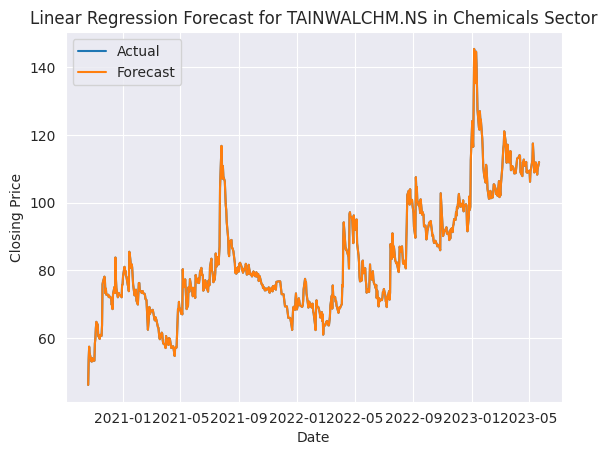

 This is mse score :  20.48203674654792
 This is rmse score :  4.52570842482676
 This is r2 score :  0.9279513044680799


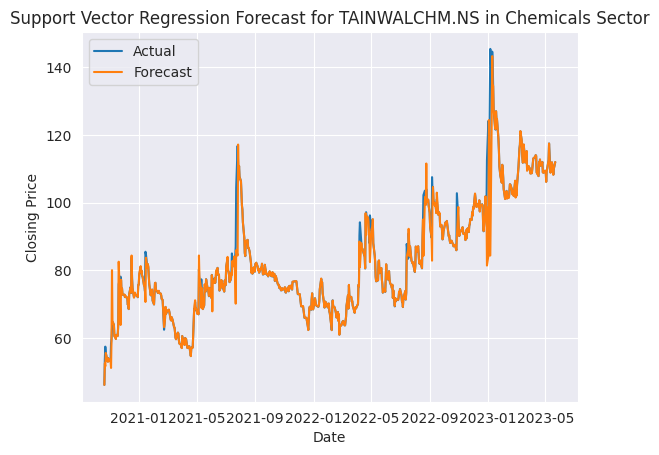

 This is mse score :  2.5260036927944434
 This is rmse score :  1.5893406471850027
 This is r2 score :  0.9911143958373512


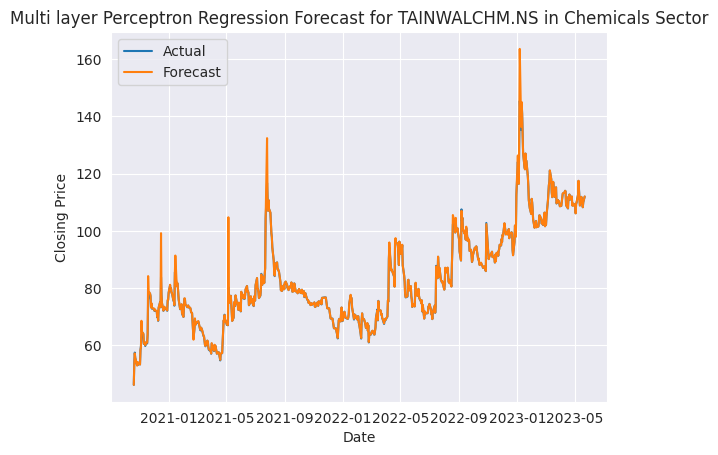

 This is mse score :  19.580404734201924
 This is rmse score :  4.424975111139262
 This is r2 score :  0.9311229329122237


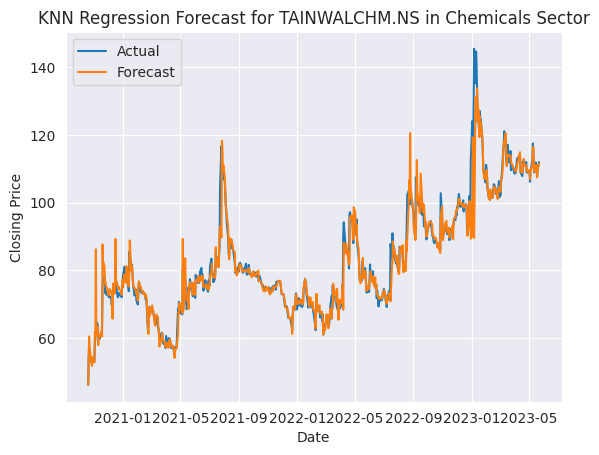

Forecasting ARVEE.NS in Chemicals sector
 This is mse score :  1.2656224503303018e-25
 This is rmse score :  3.5575587842371654e-13
 This is r2 score :  1.0


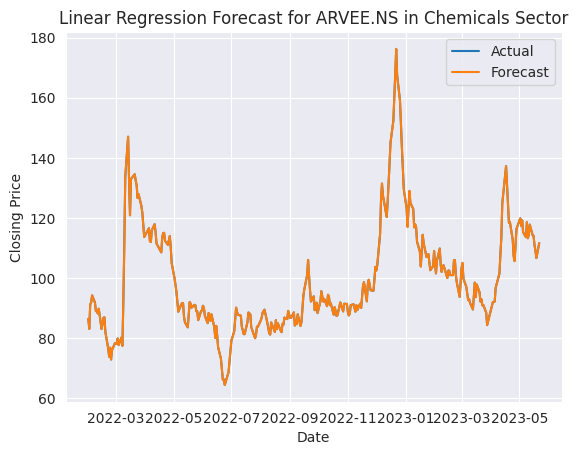

 This is mse score :  768.4863522667832
 This is rmse score :  27.72158639520443
 This is r2 score :  -1.2806081146832047


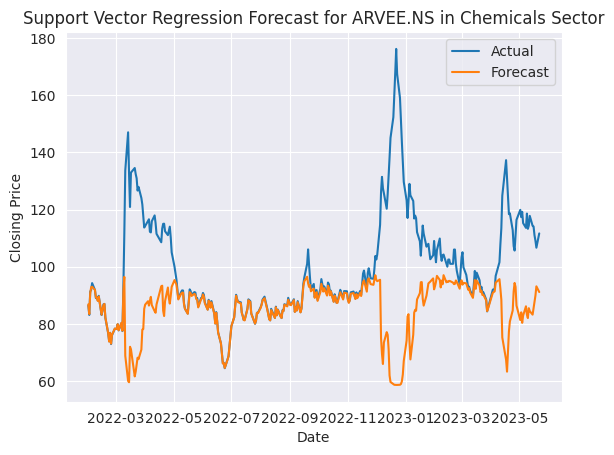

 This is mse score :  25.093737575499905
 This is rmse score :  5.009364987251368
 This is r2 score :  0.9255302564923773


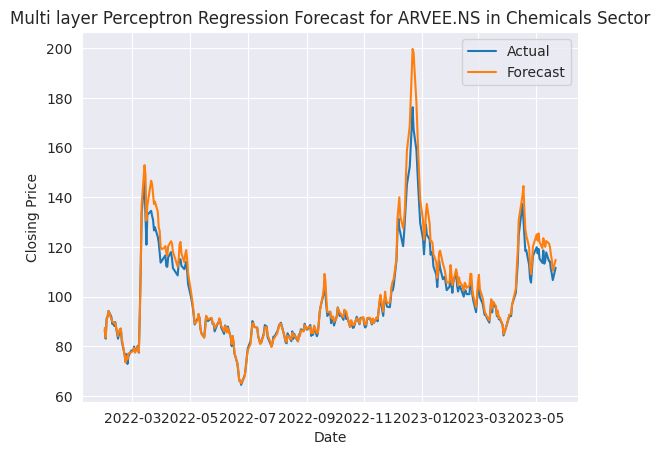

 This is mse score :  305.39357912432735
 This is rmse score :  17.475513701300095
 This is r2 score :  0.09369493333396084


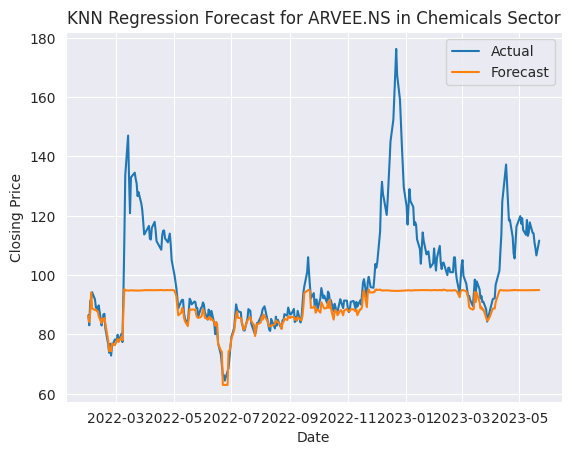

Forecasting AGROPHOS.NS in Chemicals sector
 This is mse score :  0.12909732917328956
 This is rmse score :  0.3593011677872611
 This is r2 score :  0.9984581245735802


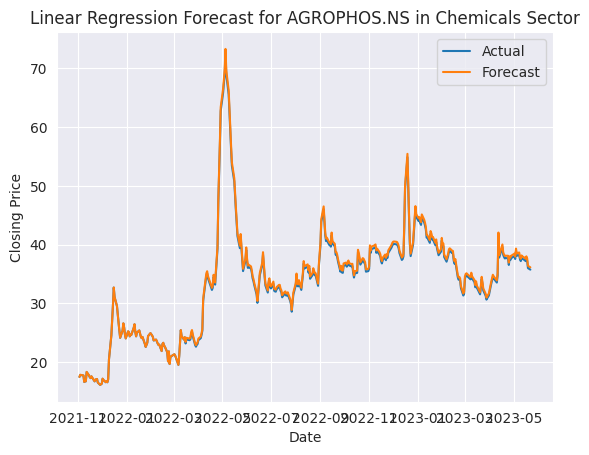

 This is mse score :  2.2723859541658467
 This is rmse score :  1.5074435160780806
 This is r2 score :  0.9728597323855815


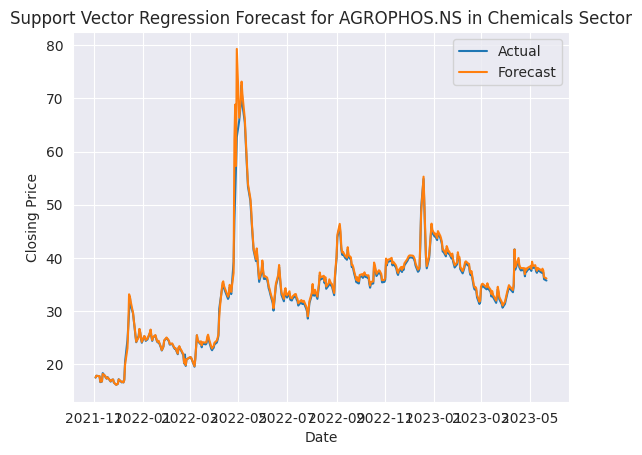

 This is mse score :  0.22697798147912826
 This is rmse score :  0.4764220623345735
 This is r2 score :  0.9972890858840987


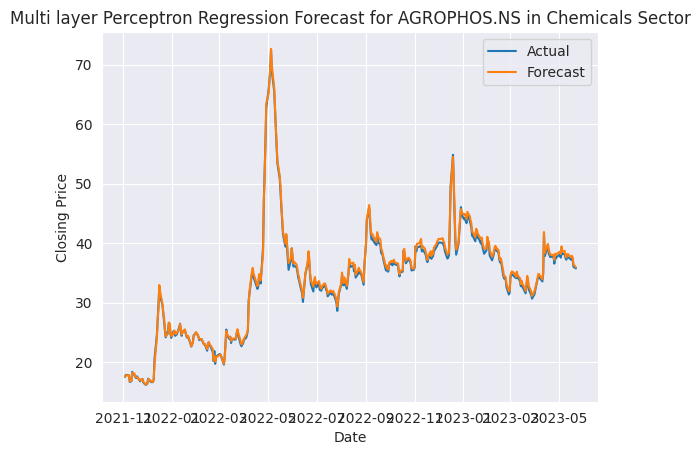

 This is mse score :  22.922894955859153
 This is rmse score :  4.787786018177833
 This is r2 score :  0.726220142111557


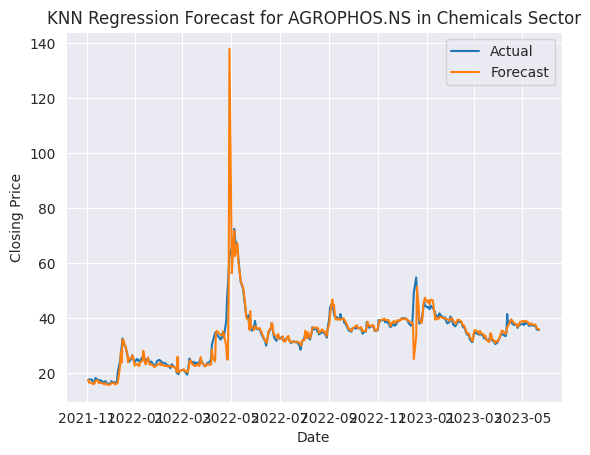

Forecasting SIKKO.NS in Chemicals sector
 This is mse score :  0.004065523282272143
 This is rmse score :  0.06376145608651157
 This is r2 score :  0.9999954716257764


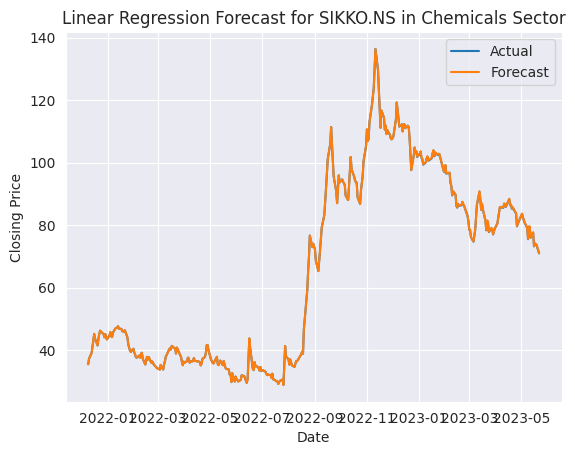

 This is mse score :  2688.527507441856
 This is rmse score :  51.85101259803762
 This is r2 score :  -1.9946104889730871


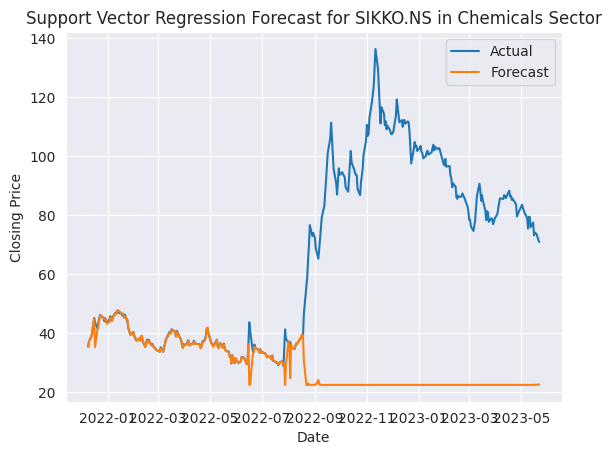

 This is mse score :  4.631369944524923
 This is rmse score :  2.152061789197727
 This is r2 score :  0.9948413587081407


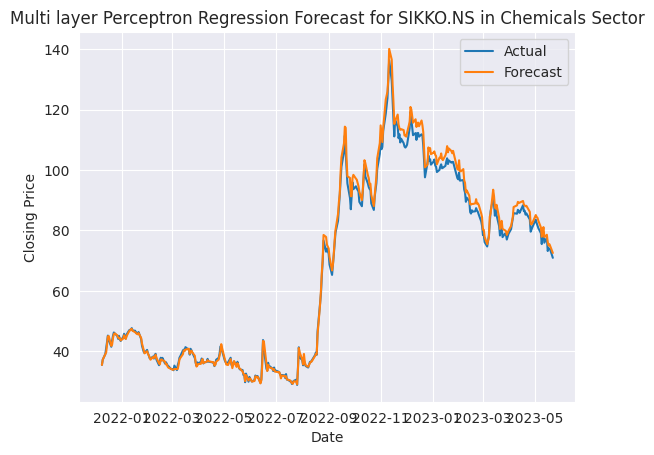

 This is mse score :  1190.6578824011003
 This is rmse score :  34.50591083279936
 This is r2 score :  -0.32621168038911375


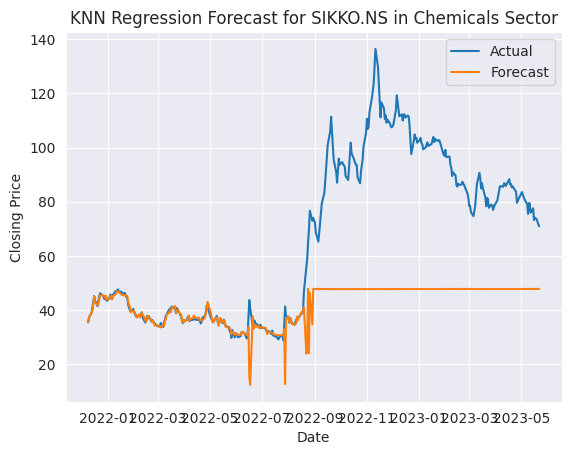

Forecasting ALKALI.NS in Chemicals sector
 This is mse score :  6.405802800832425
 This is rmse score :  2.530968747502115
 This is r2 score :  0.990612827970626


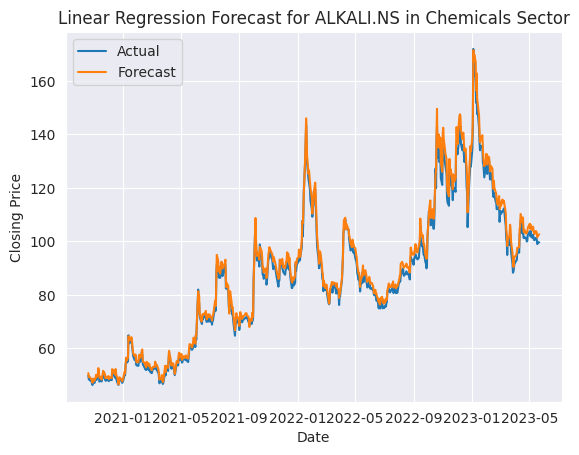

 This is mse score :  378.38530564497916
 This is rmse score :  19.45212856334697
 This is r2 score :  0.44550775790115016


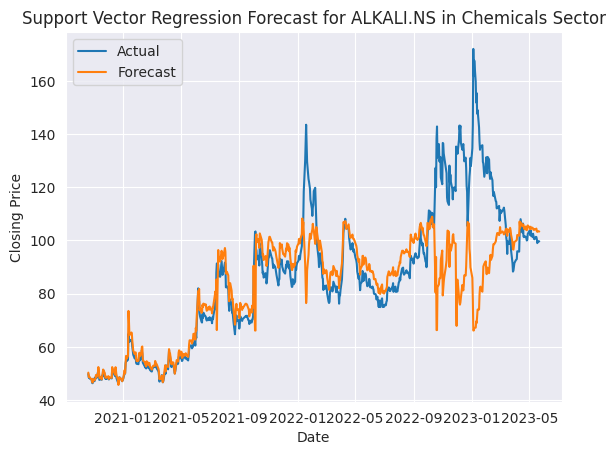

 This is mse score :  43.71608920379327
 This is rmse score :  6.611814365497058
 This is r2 score :  0.9359377017109959


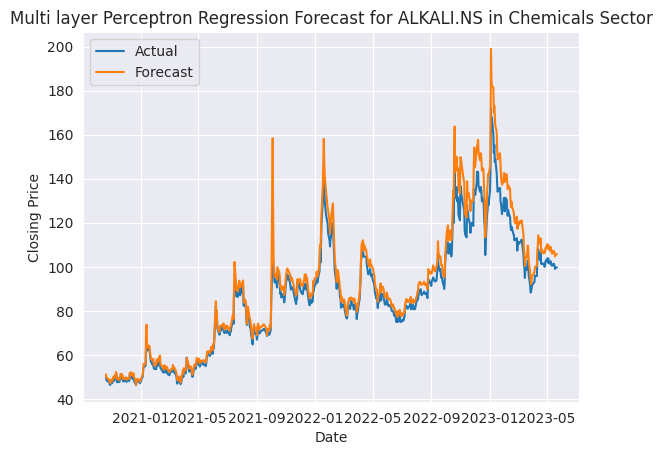

 This is mse score :  235.7388214001917
 This is rmse score :  15.353788503173792
 This is r2 score :  0.6545443343654138


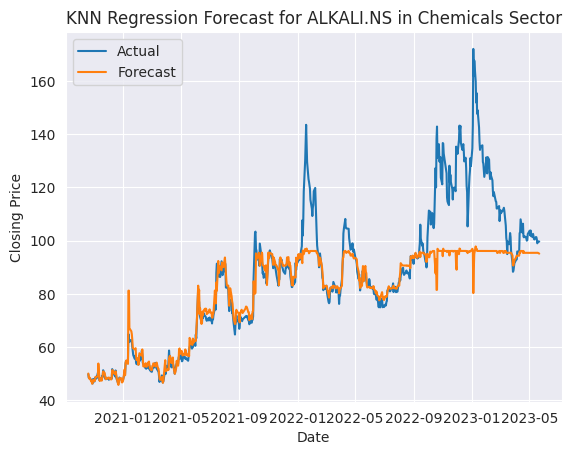

Forecasting IITL.NS in Investment Banking & Investment Services sector
 This is mse score :  0.9806964641088903
 This is rmse score :  0.9903011986809318
 This is r2 score :  0.9967170728164649


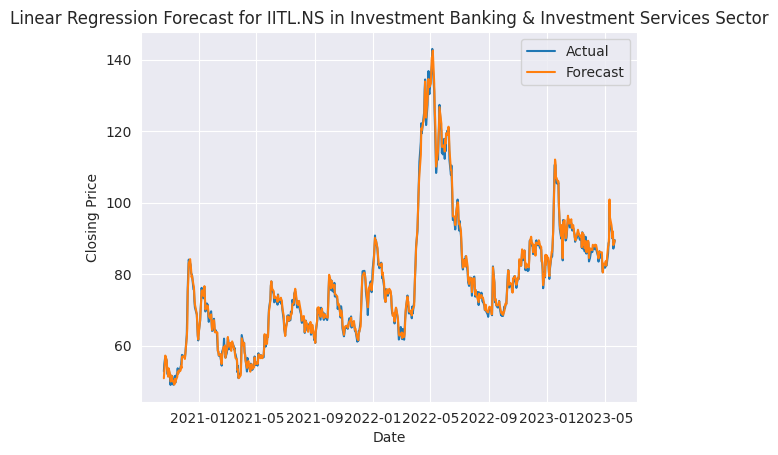

 This is mse score :  25.217316991188603
 This is rmse score :  5.02168467659894
 This is r2 score :  0.9155838544585573


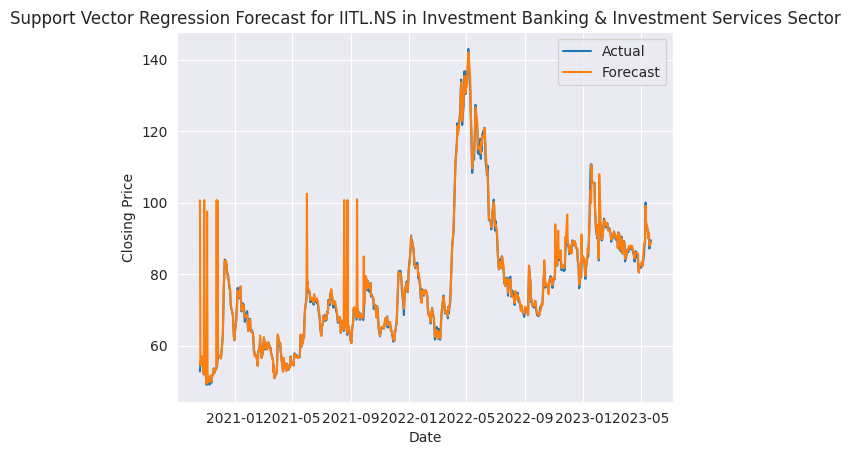

 This is mse score :  4.301244148401248
 This is rmse score :  2.0739441044544207
 This is r2 score :  0.985601384470537


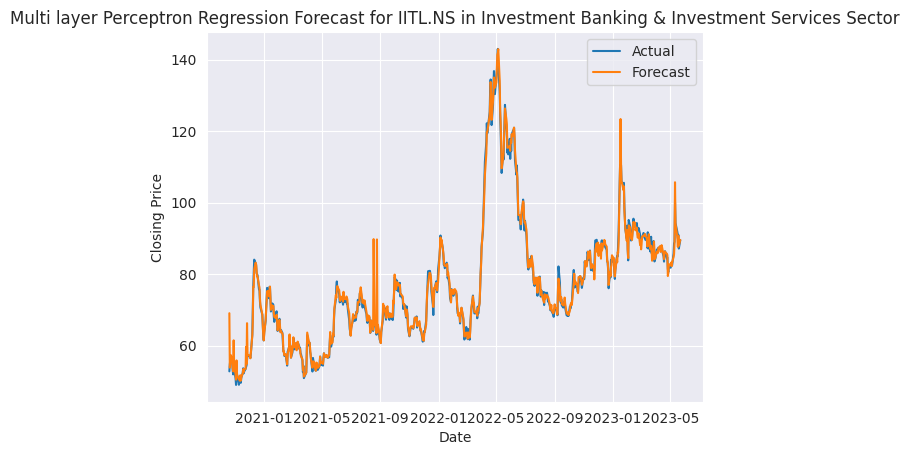

 This is mse score :  29.415629370277156
 This is rmse score :  5.423617738214702
 This is r2 score :  0.901529807830781


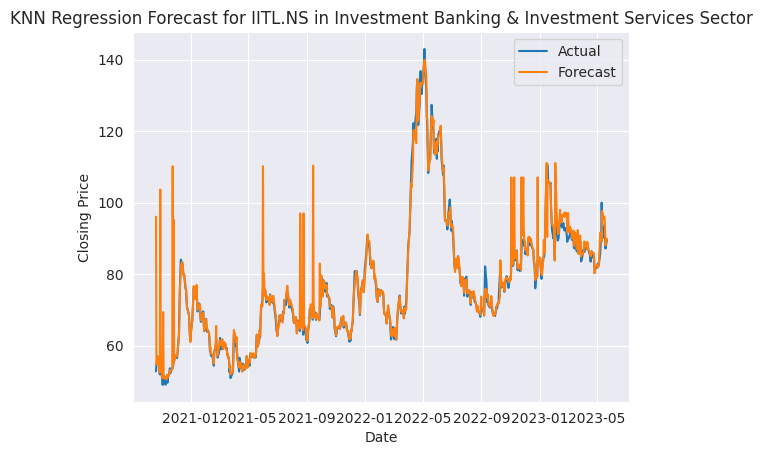

Forecasting 21STCENMGM.NS in Investment Banking & Investment Services sector
 This is mse score :  0.053923393037008445
 This is rmse score :  0.2322141103314104
 This is r2 score :  0.9984480983209445


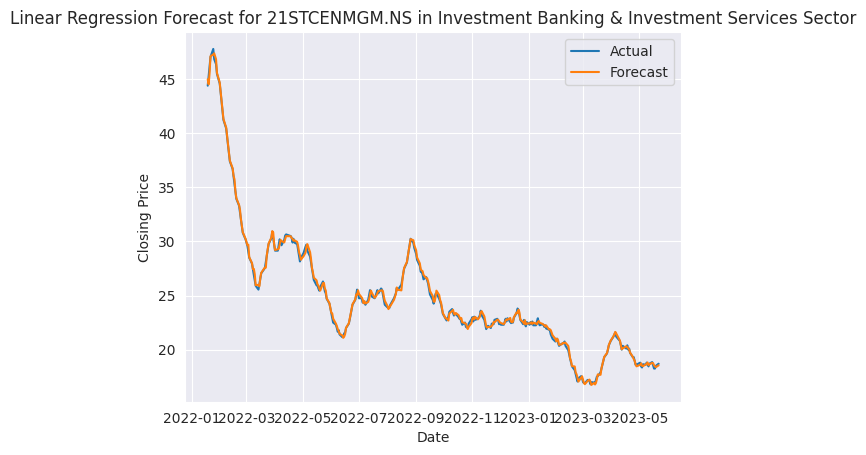

 This is mse score :  0.02413682272191851
 This is rmse score :  0.1553602996969255
 This is r2 score :  0.9993053483173155


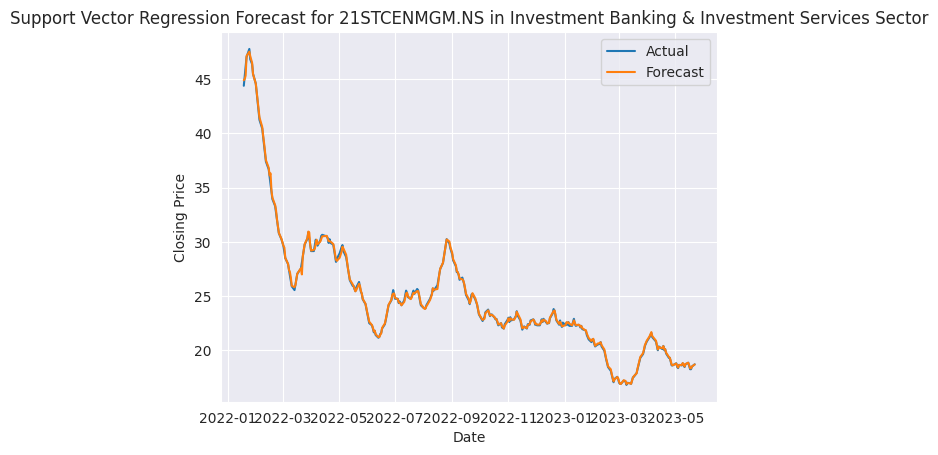

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:693: UserWarning: Training interrupted by user.
  warnings.warn("Training interrupted by user.")


 This is mse score :  20.404206064507626
 This is rmse score :  4.517101511423849
 This is r2 score :  0.4127720852140657


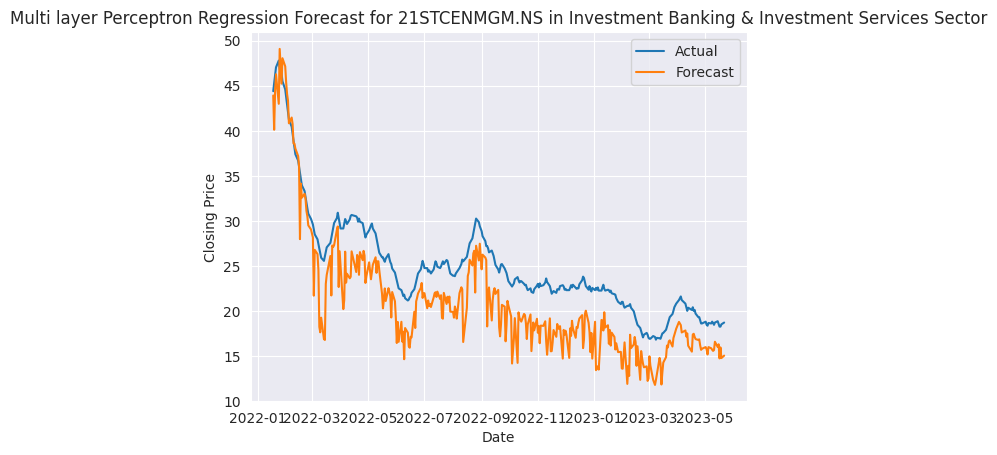

 This is mse score :  0.3846750135869901
 This is rmse score :  0.6202217454967135
 This is r2 score :  0.9889291499318922


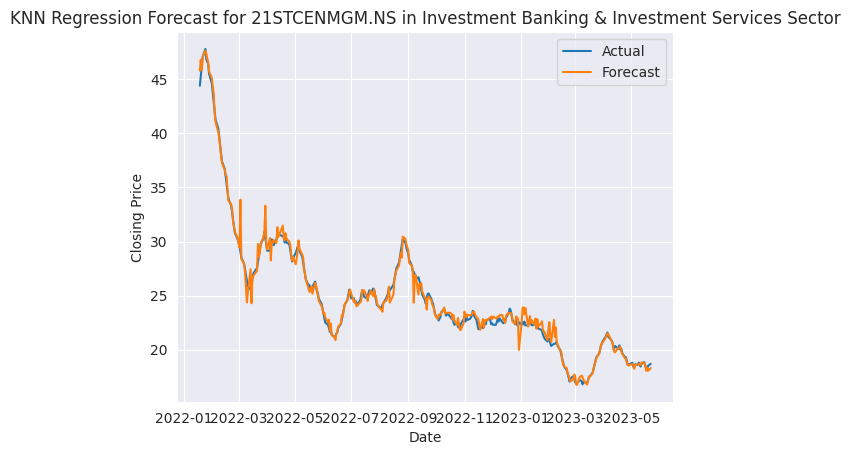

Forecasting DBSTOCKBRO.NS in Investment Banking & Investment Services sector
 This is mse score :  5.896490362751495e-27
 This is rmse score :  7.678860828763271e-14
 This is r2 score :  1.0


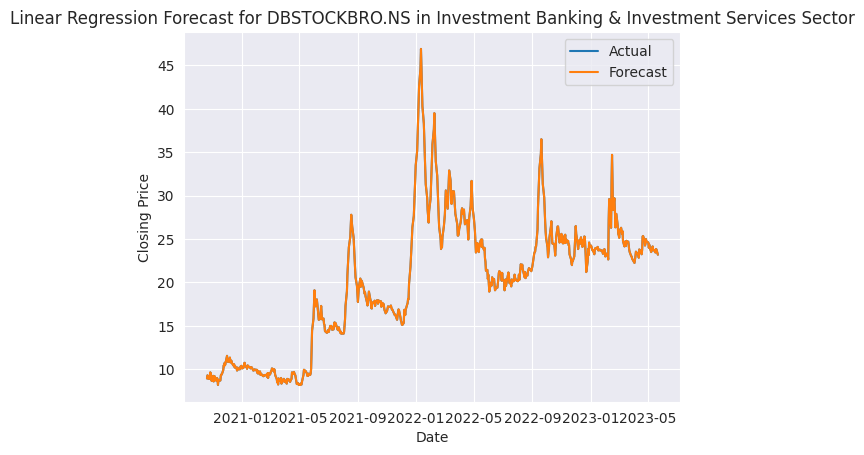

 This is mse score :  3.121540671130688
 This is rmse score :  1.7667882360743428
 This is r2 score :  0.9458609312731754


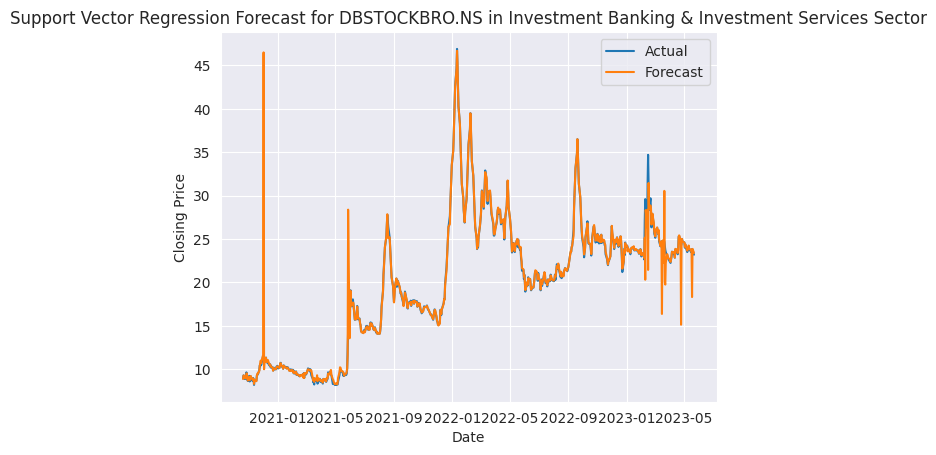

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:693: UserWarning: Training interrupted by user.
  warnings.warn("Training interrupted by user.")


 This is mse score :  0.6989448795706051
 This is rmse score :  0.8360292336818164
 This is r2 score :  0.9878777088438099


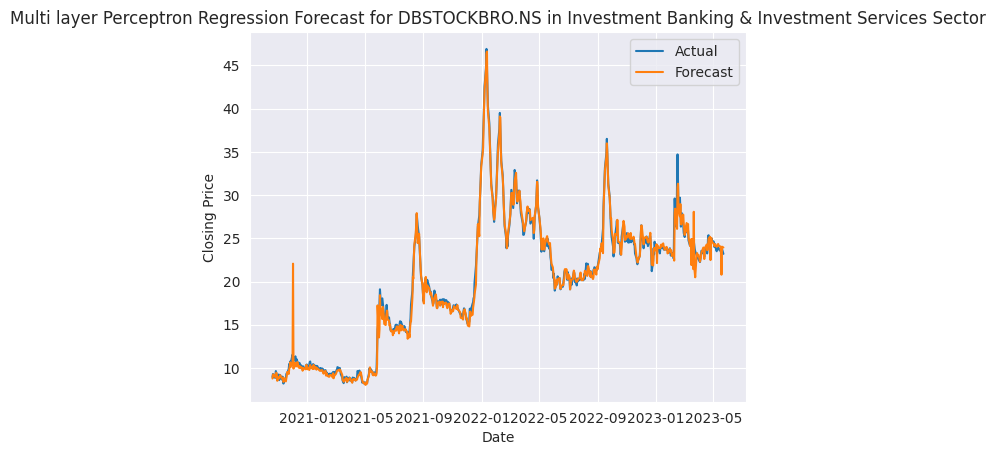

 This is mse score :  4.211846340809518
 This is rmse score :  2.0522783292744475
 This is r2 score :  0.9269509955065504


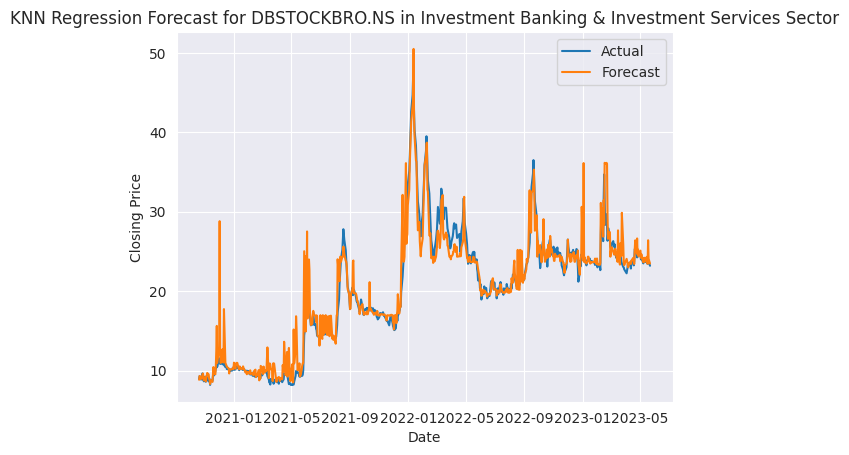

Forecasting HBSL.NS in Investment Banking & Investment Services sector
 This is mse score :  0.3132016936368796
 This is rmse score :  0.5596442563243901
 This is r2 score :  0.9989773798768894


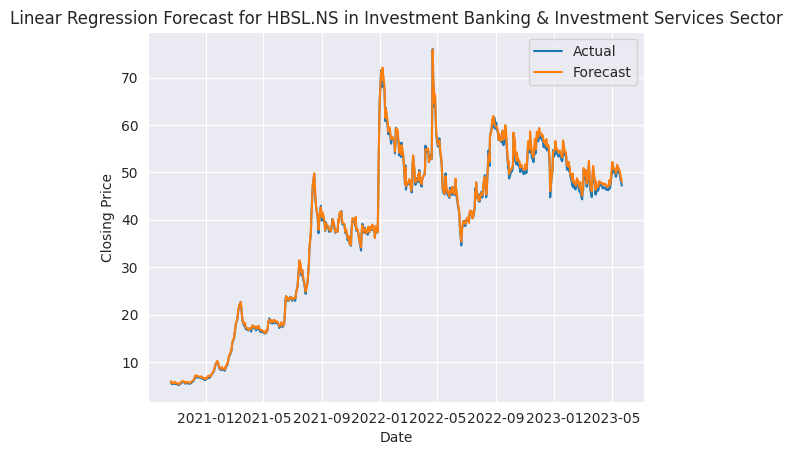

 This is mse score :  72.95231239799311
 This is rmse score :  8.541212583585137
 This is r2 score :  0.761806835016246


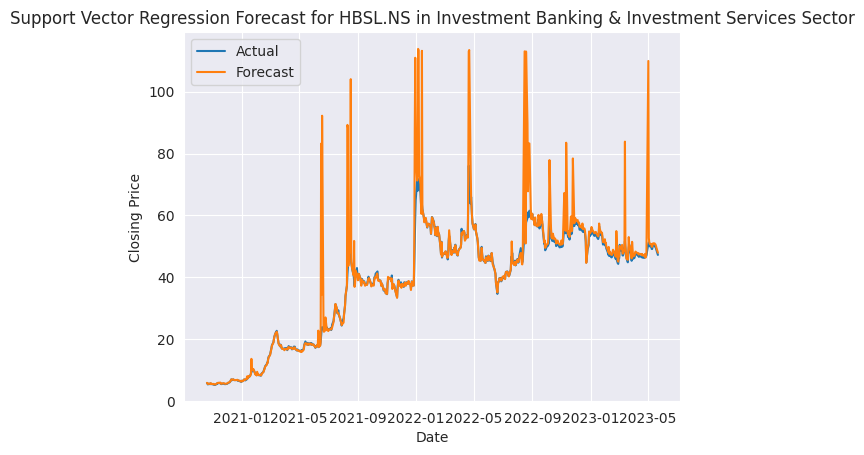

 This is mse score :  50.07879582640913
 This is rmse score :  7.076637324775739
 This is r2 score :  0.8364900784584898


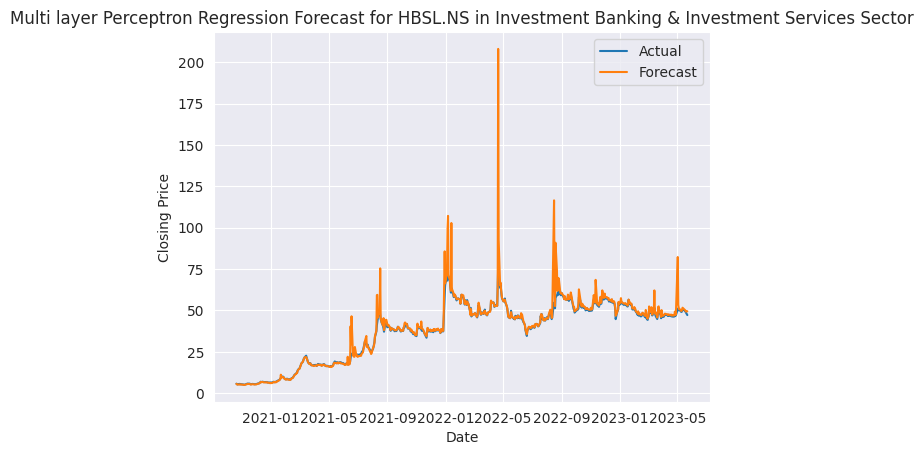

 This is mse score :  136.36961640256698
 This is rmse score :  11.677740209585371
 This is r2 score :  0.5547459776005474


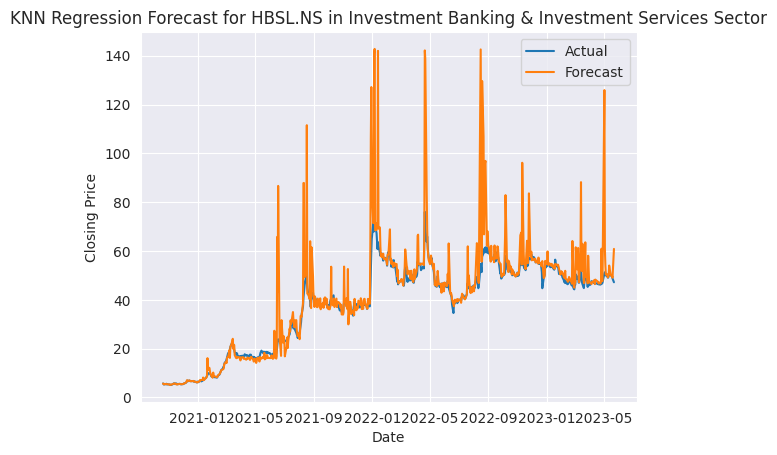

Forecasting INDBANK.NS in Investment Banking & Investment Services sector
 This is mse score :  1.8481743416922101e-28
 This is rmse score :  1.3594757598766557e-14
 This is r2 score :  1.0


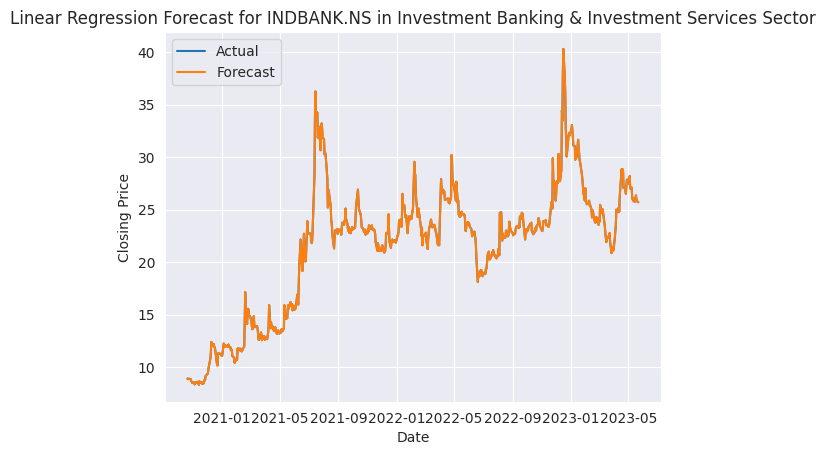

 This is mse score :  1.9934753535173664
 This is rmse score :  1.4119048670209216
 This is r2 score :  0.9473163666554942


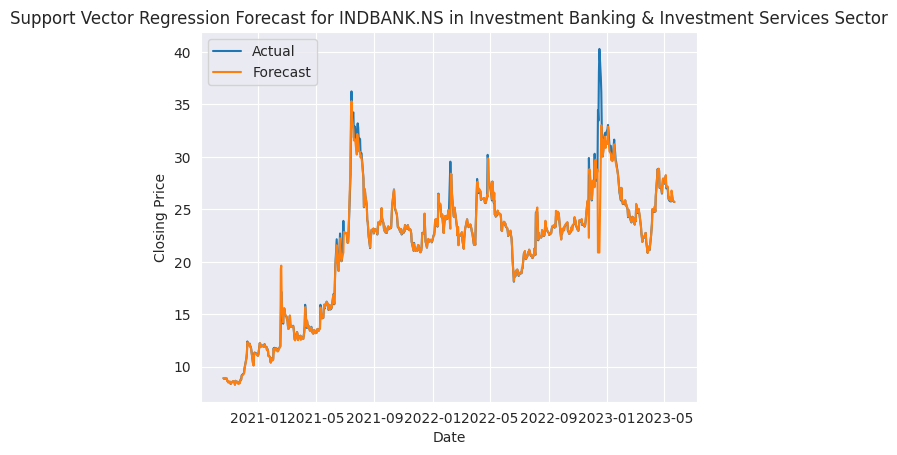

 This is mse score :  0.1469398697595909
 This is rmse score :  0.3833273663066477
 This is r2 score :  0.9961166682053808


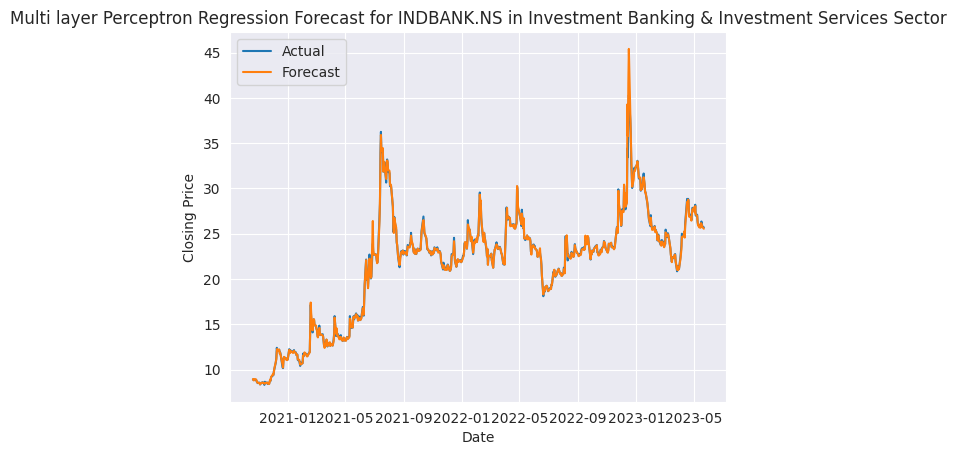

 This is mse score :  1.0352469352120939
 This is rmse score :  1.0174708522665865
 This is r2 score :  0.9726404593568194


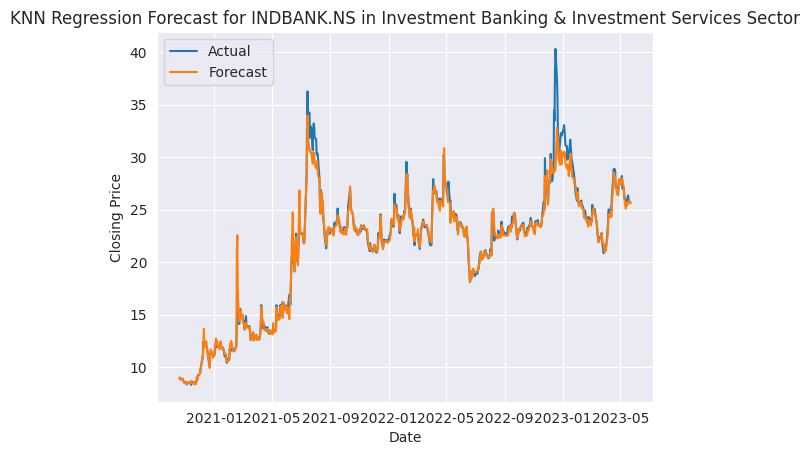

Forecasting AMJLAND.NS in Real Estate Operations sector
 This is mse score :  0.5509256486202223
 This is rmse score :  0.7422436585247612
 This is r2 score :  0.9679276103647542


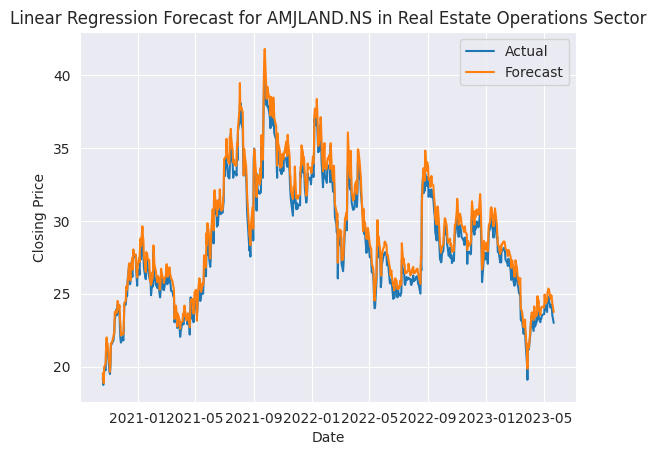

 This is mse score :  3.047005749459838
 This is rmse score :  1.7455674577225133
 This is r2 score :  0.822617161022982


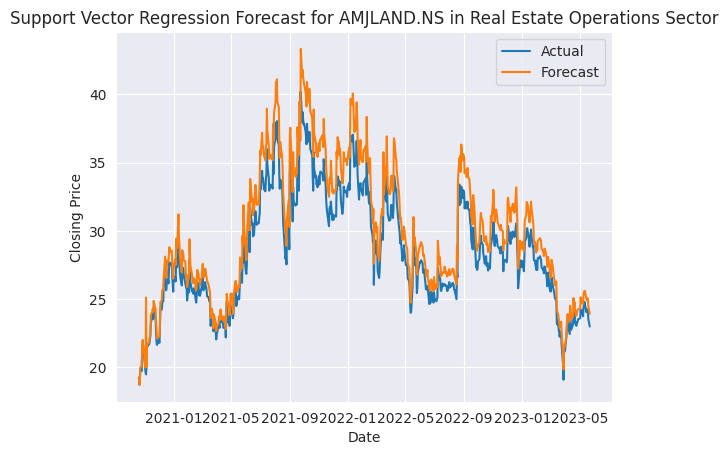

 This is mse score :  1.771785532765375
 This is rmse score :  1.331084344722518
 This is r2 score :  0.8968546915554572


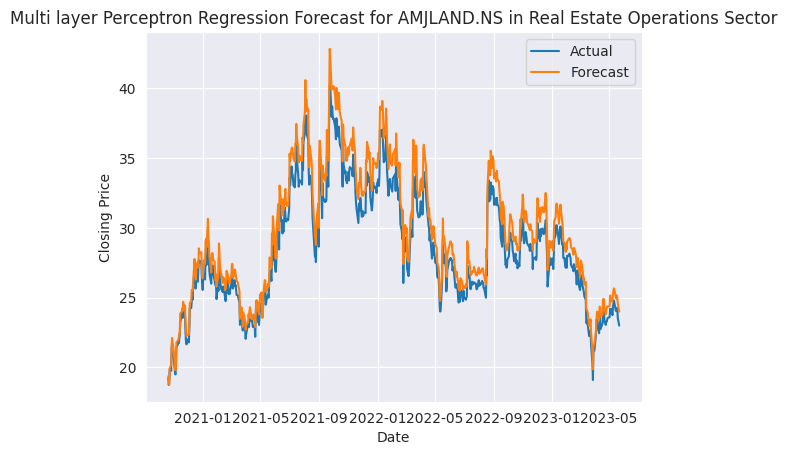

 This is mse score :  1.2122982205291415
 This is rmse score :  1.1010441501271153
 This is r2 score :  0.9294255023698699


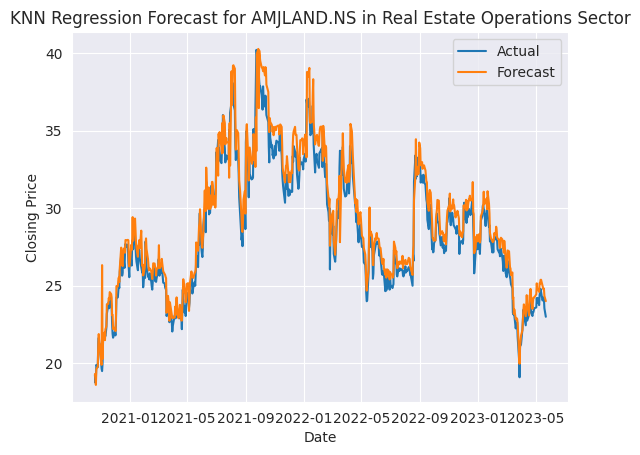

Forecasting PANSARI.NS in Real Estate Operations sector
 This is mse score :  2.1323258940503055e-25
 This is rmse score :  4.617711439718062e-13
 This is r2 score :  1.0


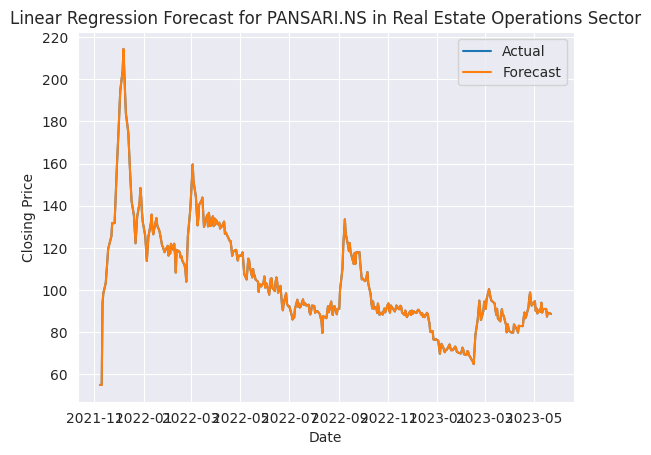

 This is mse score :  5383.180899397161
 This is rmse score :  73.37016355029584
 This is r2 score :  -7.5696693164371265


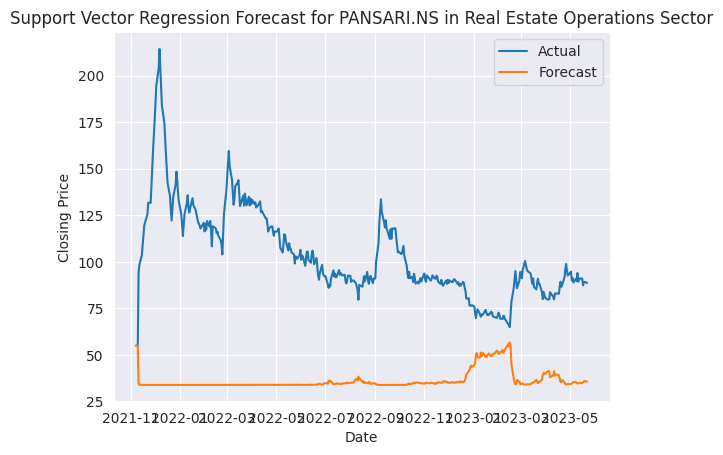

 This is mse score :  57.275801805546614
 This is rmse score :  7.5680778144484355
 This is r2 score :  0.9088206971899656


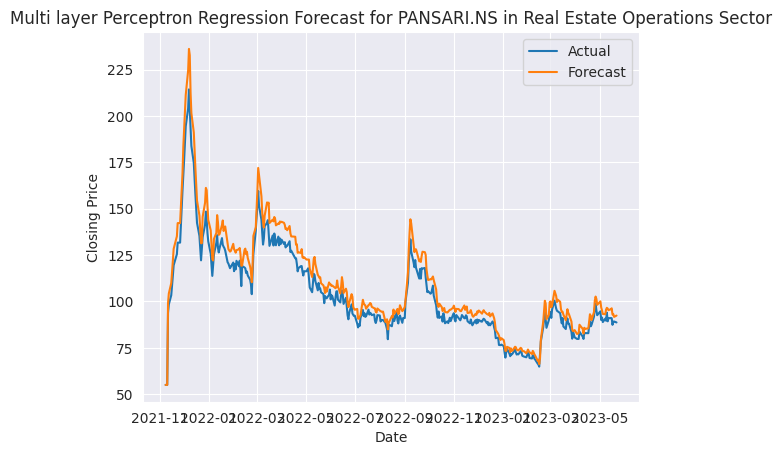

 This is mse score :  3006.4563845144357
 This is rmse score :  54.831162531123084
 This is r2 score :  -3.7860804812383506


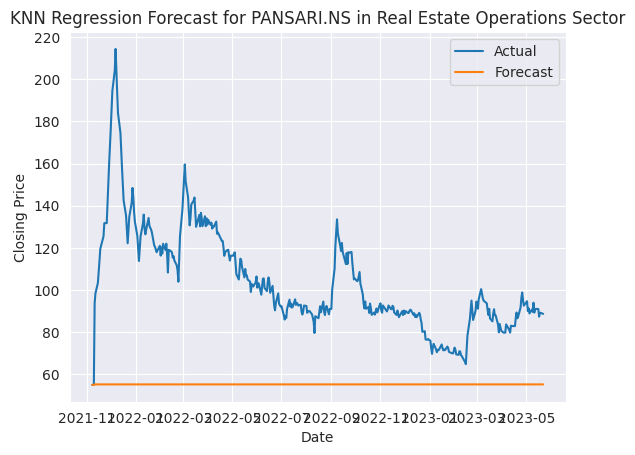

Forecasting GEECEE.NS in Real Estate Operations sector
 This is mse score :  2.446197798967061
 This is rmse score :  1.5640325440882172
 This is r2 score :  0.9967297012094855


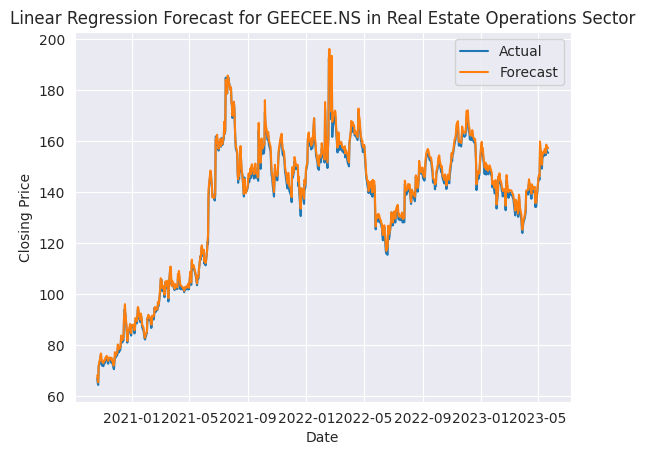

 This is mse score :  10.01729261000488
 This is rmse score :  3.1650106808674248
 This is r2 score :  0.9866079758879014


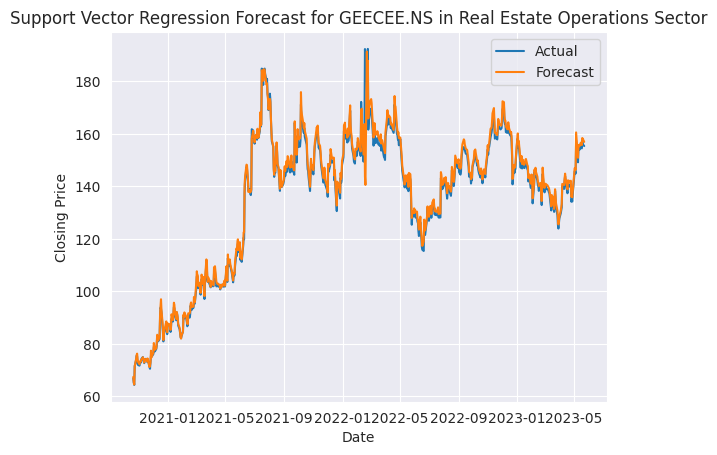

 This is mse score :  15.348844506398025
 This is rmse score :  3.9177601389567007
 This is r2 score :  0.9794802743889863


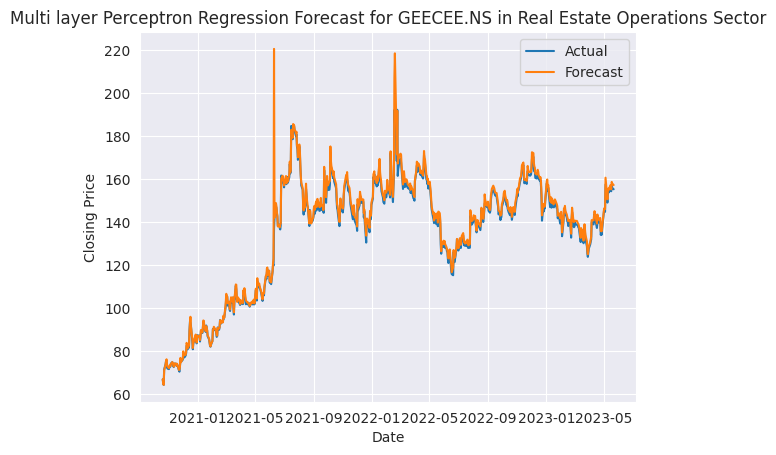

 This is mse score :  7.1427825644306715
 This is rmse score :  2.6725984667418095
 This is r2 score :  0.9904508812855486


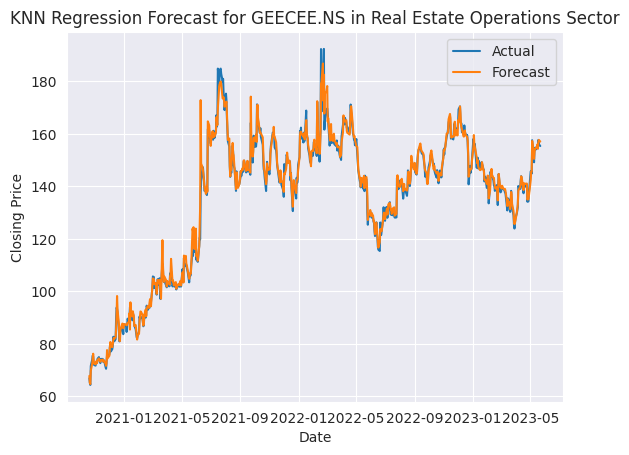

Forecasting SUMIT.NS in Real Estate Operations sector
 This is mse score :  5.423624871714636e-29
 This is rmse score :  7.364526374258317e-15
 This is r2 score :  1.0


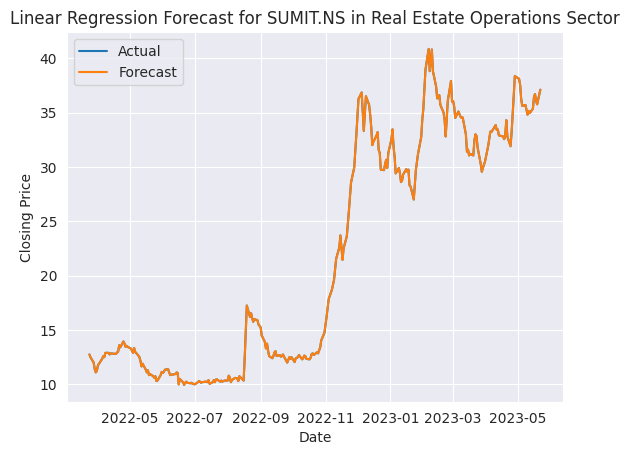

 This is mse score :  52.36037073133399
 This is rmse score :  7.236046623076304
 This is r2 score :  0.536619293950414


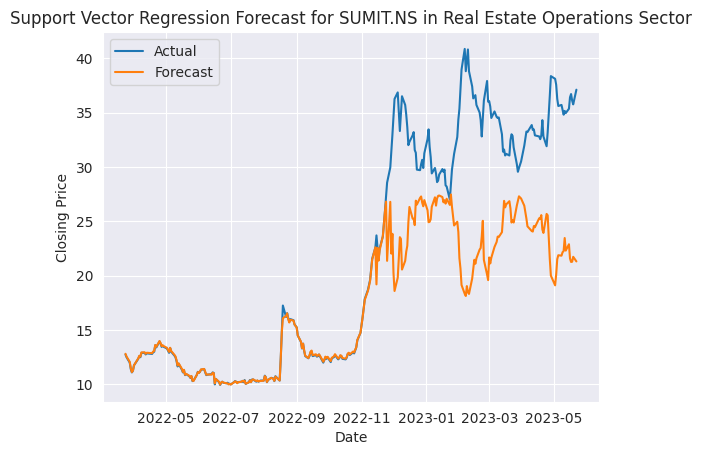

 This is mse score :  1.2271782168629524
 This is rmse score :  1.1077807620928215
 This is r2 score :  0.9891396737525708


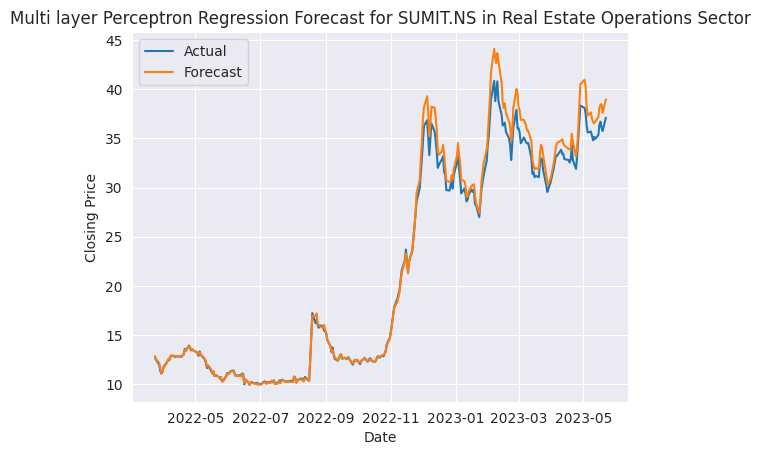

 This is mse score :  27.650353002024733
 This is rmse score :  5.25836029595013
 This is r2 score :  0.7552989041589988


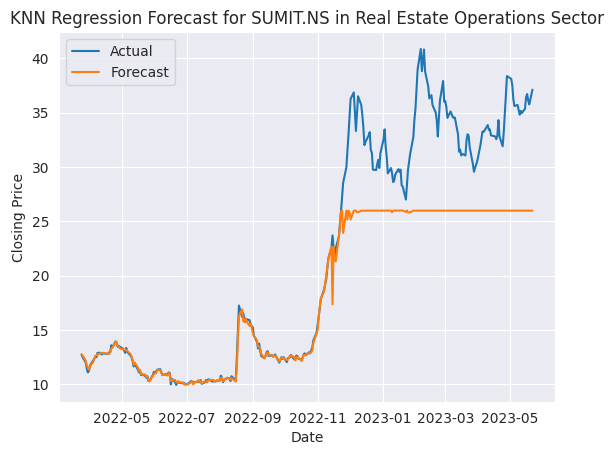

Forecasting SHRADHA.NS in Real Estate Operations sector
 This is mse score :  0.339415009293215
 This is rmse score :  0.5825933481367729
 This is r2 score :  0.9960910214173141


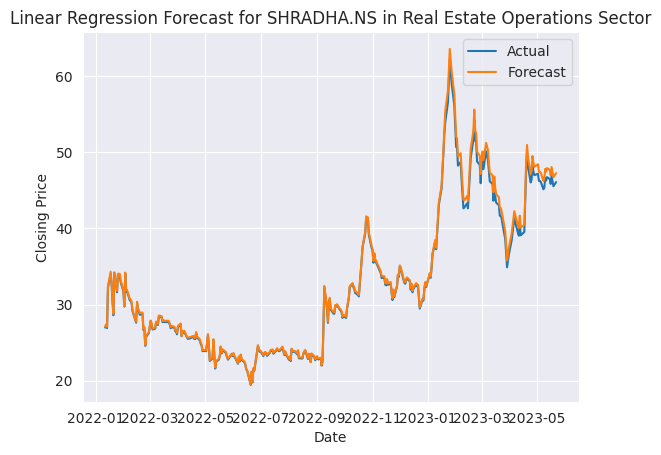

 This is mse score :  58.373956984069956
 This is rmse score :  7.640285137615608
 This is r2 score :  0.3277181580375197


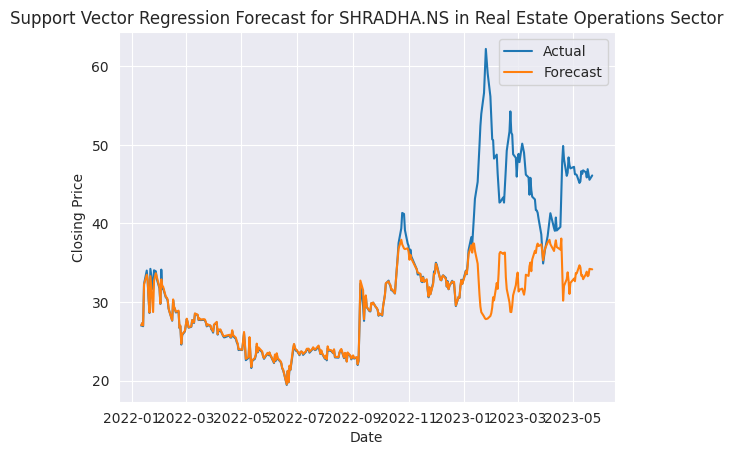

 This is mse score :  11.148792595850416
 This is rmse score :  3.3389807720096885
 This is r2 score :  0.8716014604930522


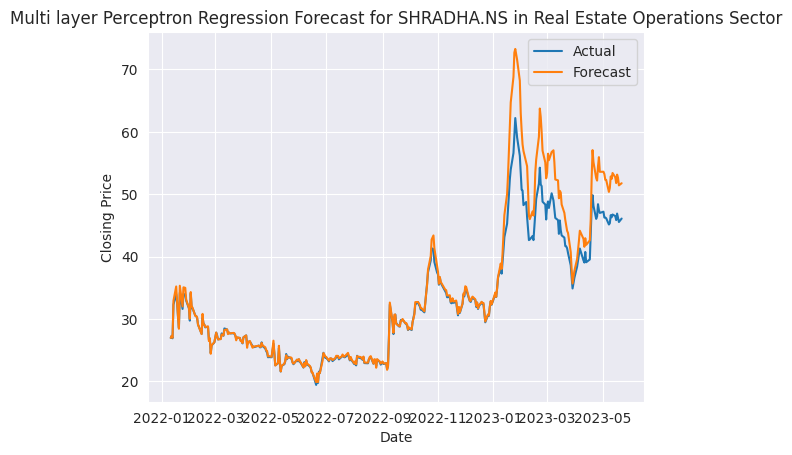

 This is mse score :  42.33702737617288
 This is rmse score :  6.50669096977664
 This is r2 score :  0.5124124486637638


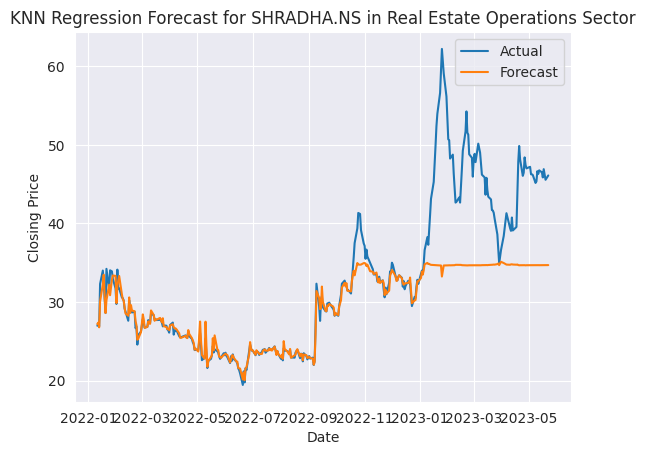

Forecasting SILLYMONKS.NS in Media & Publishing sector
 This is mse score :  0.19586202250343376
 This is rmse score :  0.4425630152909682
 This is r2 score :  0.9909727956488326


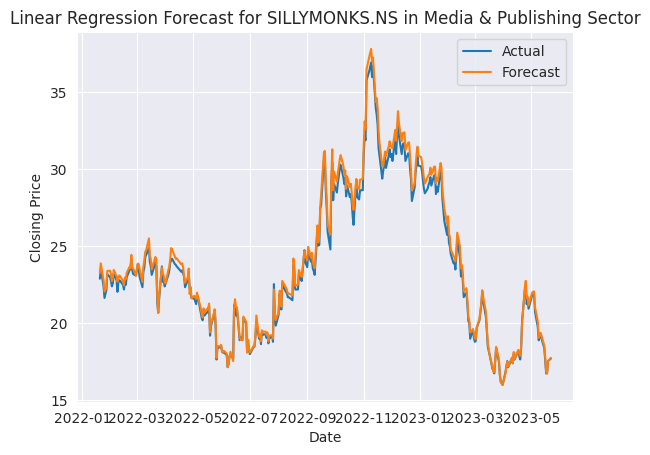

 This is mse score :  4.702964173203191
 This is rmse score :  2.1686318666853515
 This is r2 score :  0.7832422125275457


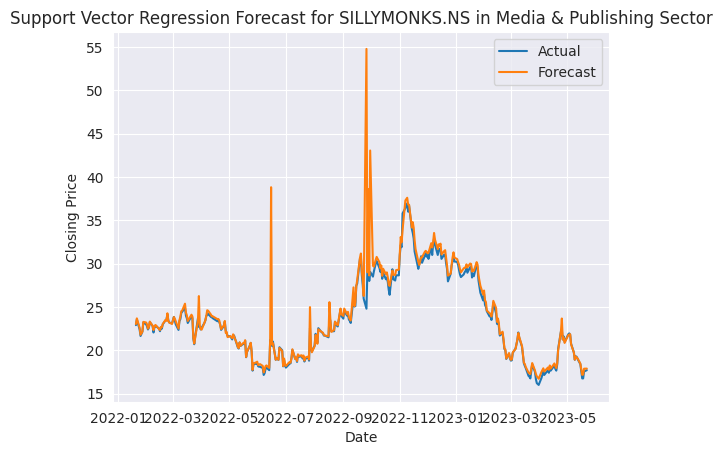

 This is mse score :  0.5306397855481716
 This is rmse score :  0.7284502629199687
 This is r2 score :  0.9755430189080222


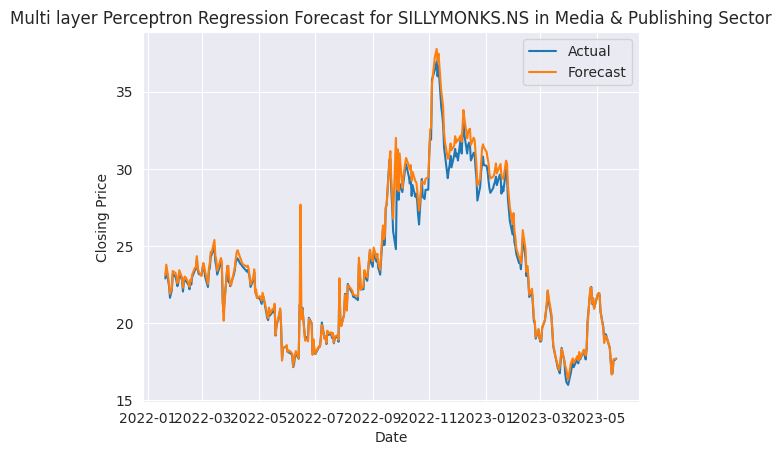

 This is mse score :  1.5160866931638417
 This is rmse score :  1.231294722300003
 This is r2 score :  0.93012415465568


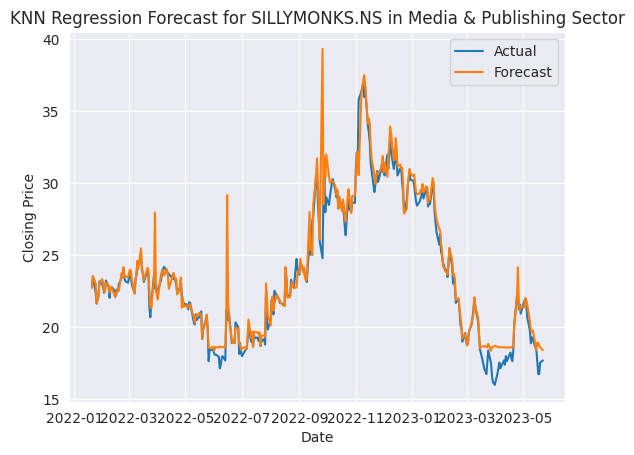

Forecasting PNC.NS in Media & Publishing sector
 This is mse score :  4.414372094526615e-28
 This is rmse score :  2.1010407170082677e-14
 This is r2 score :  1.0


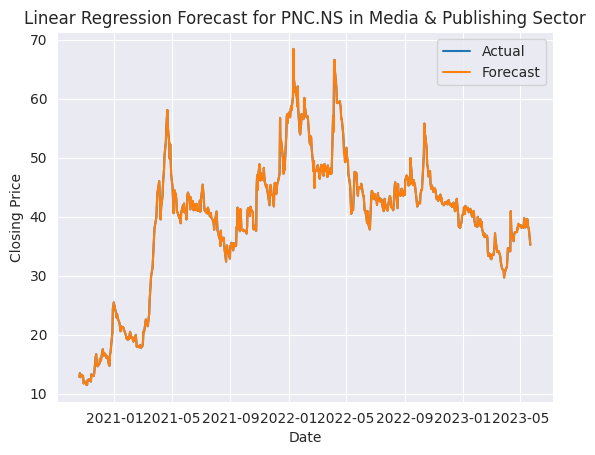

 This is mse score :  433.31891921646644
 This is rmse score :  20.81631377589381
 This is r2 score :  -2.3482486271144265


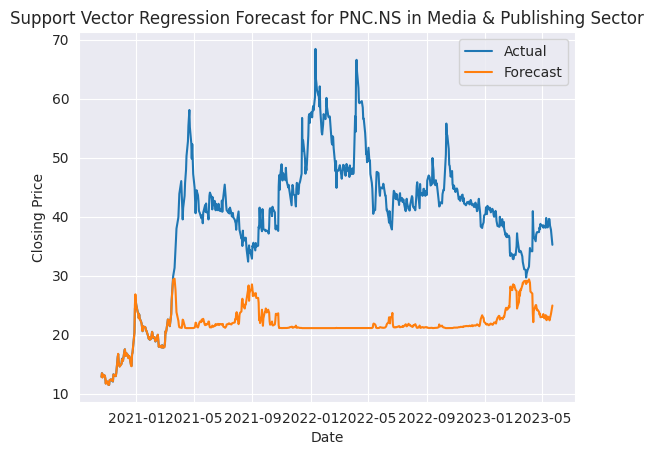

 This is mse score :  13.573592559602666
 This is rmse score :  3.6842356818752333
 This is r2 score :  0.8951170589669163


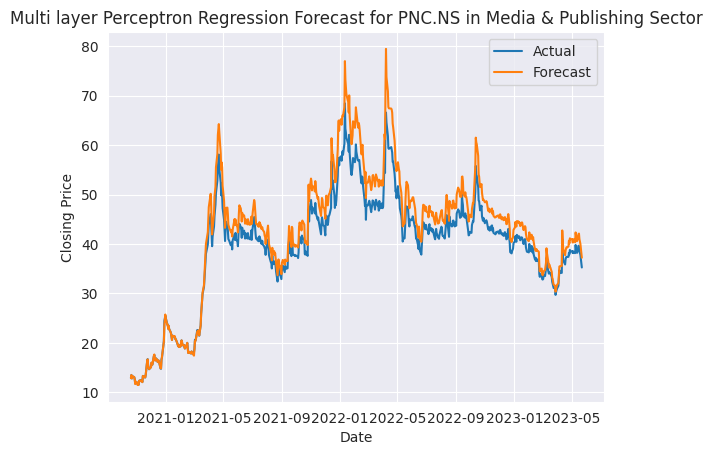

 This is mse score :  226.34382350659115
 This is rmse score :  15.04472743211359
 This is r2 score :  -0.7489552445162999


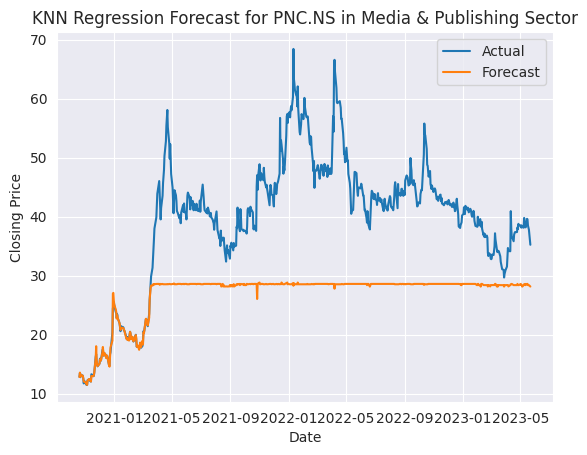

Forecasting PRESSMN.NS in Media & Publishing sector
 This is mse score :  0.4648061666686584
 This is rmse score :  0.6817669445409175
 This is r2 score :  0.9980962458073713


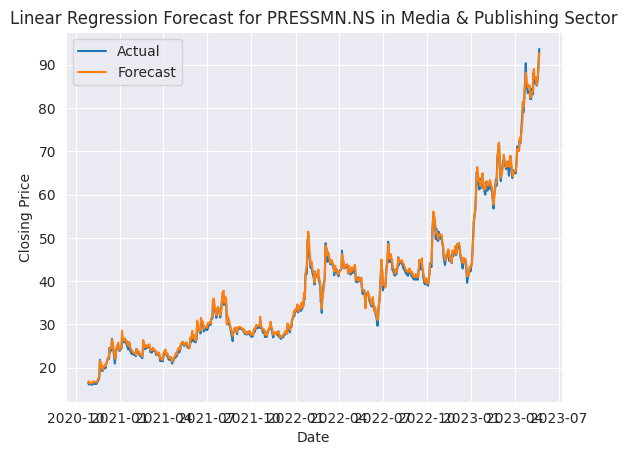

 This is mse score :  6.925336772833713
 This is rmse score :  2.631603460408447
 This is r2 score :  0.9716351893281875


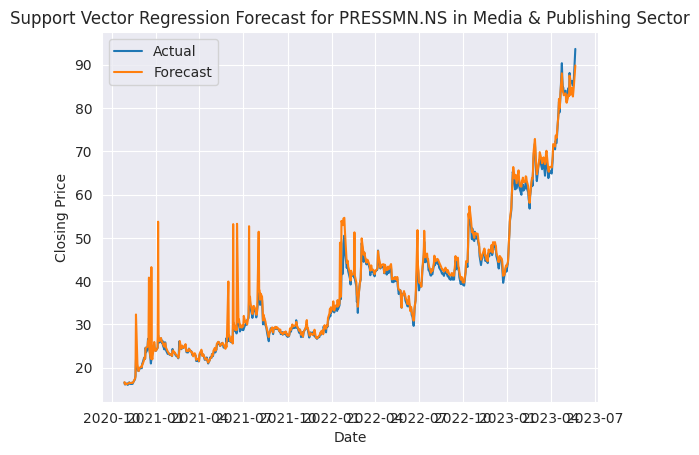

 This is mse score :  1.0312425063864117
 This is rmse score :  1.0155011109725147
 This is r2 score :  0.9957762345125049


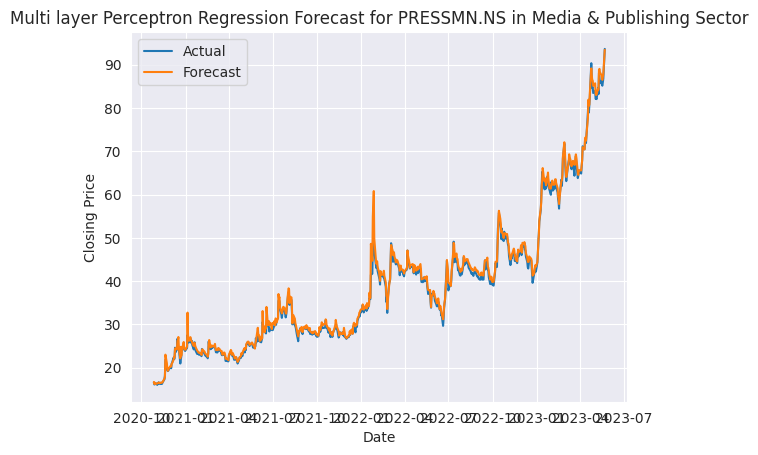

 This is mse score :  15.44254097336904
 This is rmse score :  3.9296998579241444
 This is r2 score :  0.9367504042951995


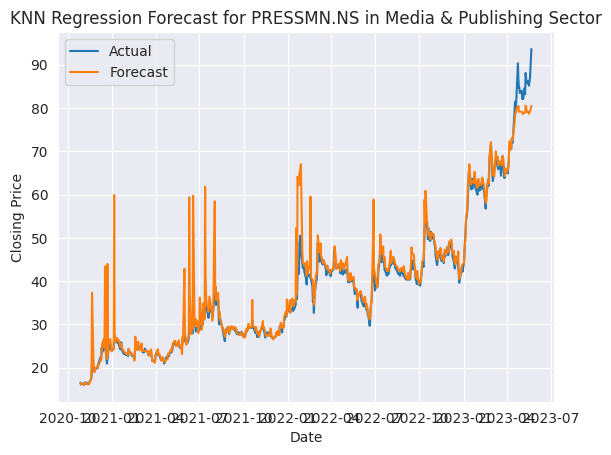

Forecasting DEN.NS in Media & Publishing sector
 This is mse score :  1.005945580959922e-26
 This is rmse score :  1.0029683848257242e-13
 This is r2 score :  1.0


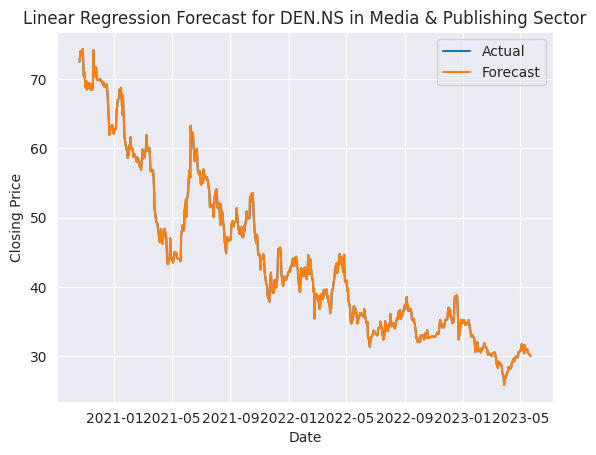

 This is mse score :  229.3650071729335
 This is rmse score :  15.144801324973976
 This is r2 score :  -0.6074009183997777


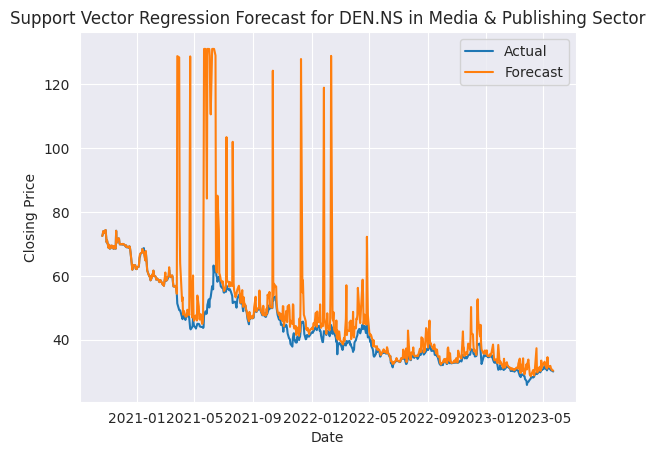

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:693: UserWarning: Training interrupted by user.
  warnings.warn("Training interrupted by user.")


 This is mse score :  346.5531298138887
 This is rmse score :  18.61593752175508
 This is r2 score :  -1.4286608755326191


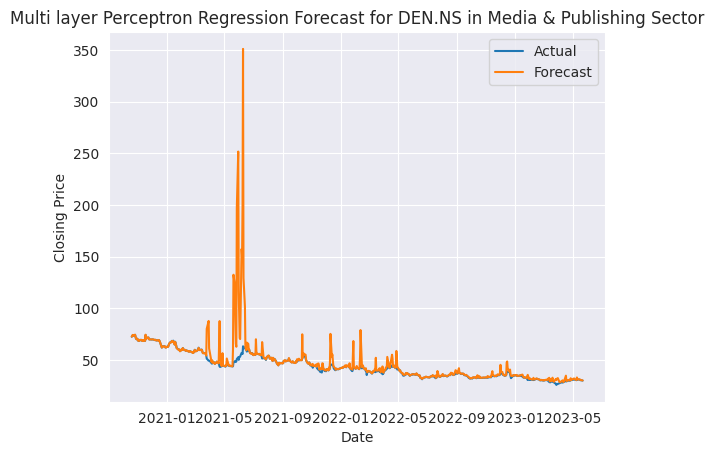

 This is mse score :  308.26035059596103
 This is rmse score :  17.557344633969027
 This is r2 score :  -1.1603032509688647


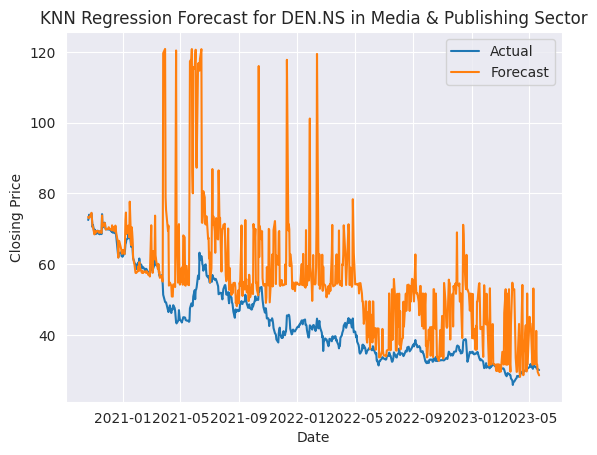

Forecasting VERTOZ.NS in Media & Publishing sector
 This is mse score :  0.003844525490623023
 This is rmse score :  0.0620042376827828
 This is r2 score :  0.9999989888594605


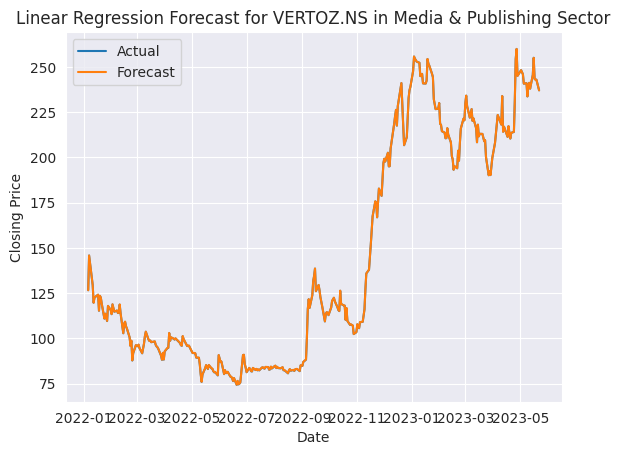

 This is mse score :  21.85782007623844
 This is rmse score :  4.675234761617692
 This is r2 score :  0.9942512208493126


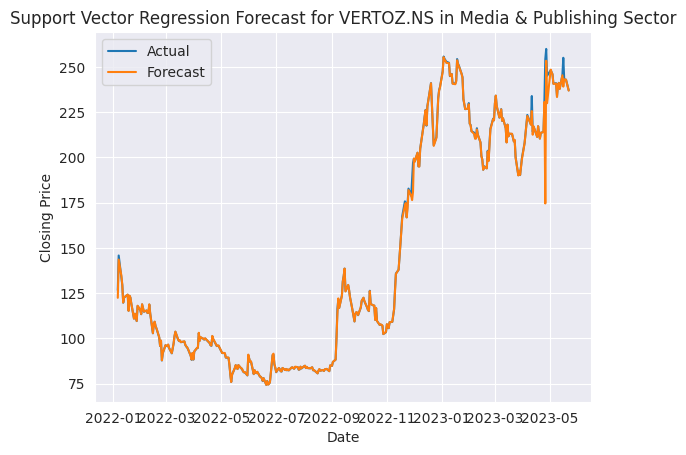

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:693: UserWarning: Training interrupted by user.
  warnings.warn("Training interrupted by user.")


 This is mse score :  11.683365429590722
 This is rmse score :  3.418093829840065
 This is r2 score :  0.996927182703617


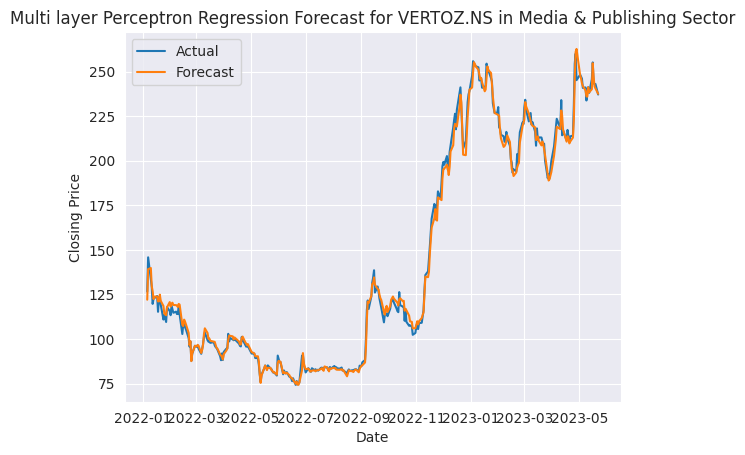

 This is mse score :  43.85600059028335
 This is rmse score :  6.622386321431524
 This is r2 score :  0.9884655257959584


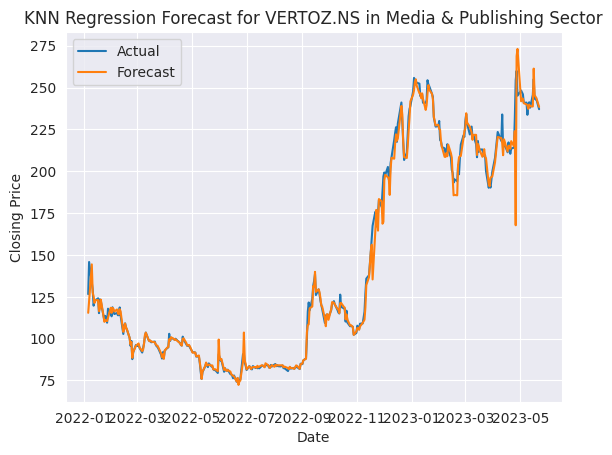

Forecasting COUNCODOS.NS in Construction & Engineering sector
 This is mse score :  1.879159591990497e-30
 This is rmse score :  1.370824420555199e-15
 This is r2 score :  1.0


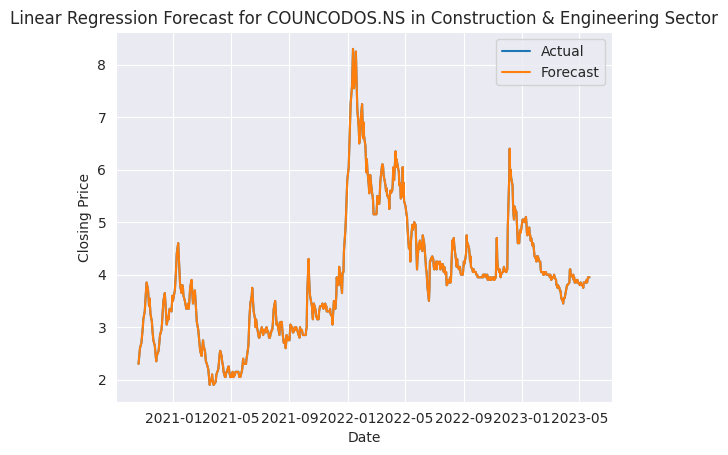

 This is mse score :  0.15325357646835366
 This is rmse score :  0.39147615057414886
 This is r2 score :  0.8889739518970093


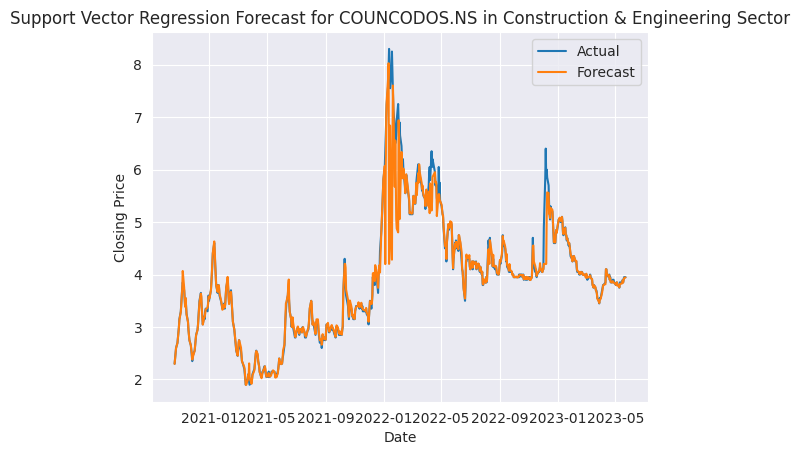

 This is mse score :  0.06629454329176578
 This is rmse score :  0.25747726752427247
 This is r2 score :  0.9519722715639378


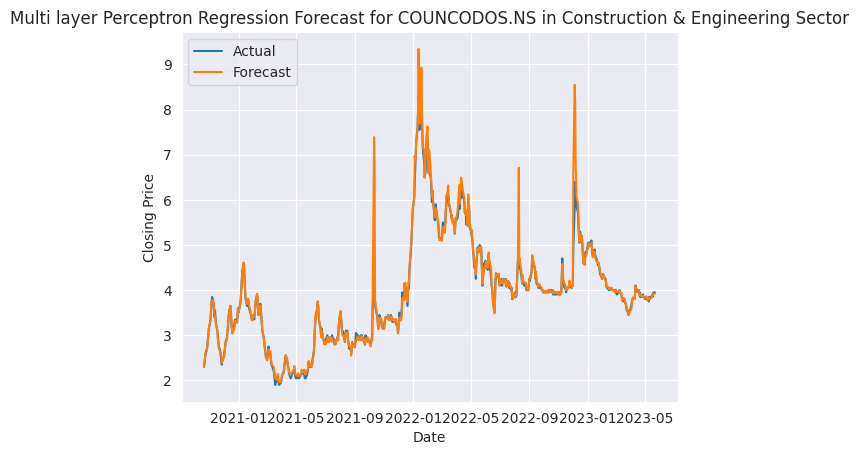

 This is mse score :  0.14479046962496384
 This is rmse score :  0.38051342896797197
 This is r2 score :  0.8951051321875324


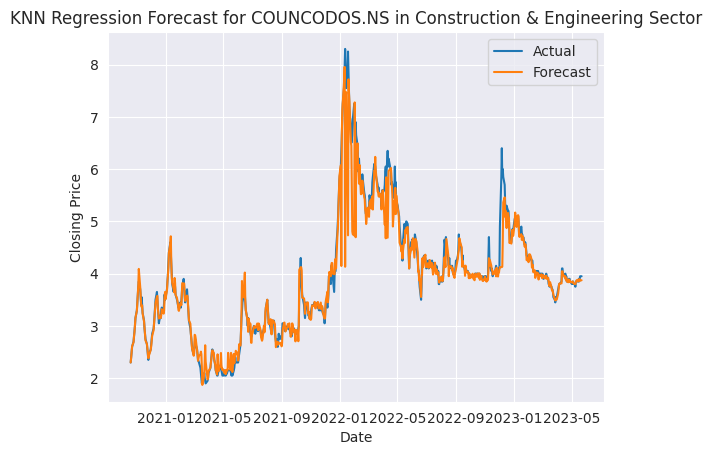

Forecasting SETUINFRA.NS in Construction & Engineering sector
 This is mse score :  3.486802125948401e-06
 This is rmse score :  0.001867298081707471
 This is r2 score :  0.9999943695833932


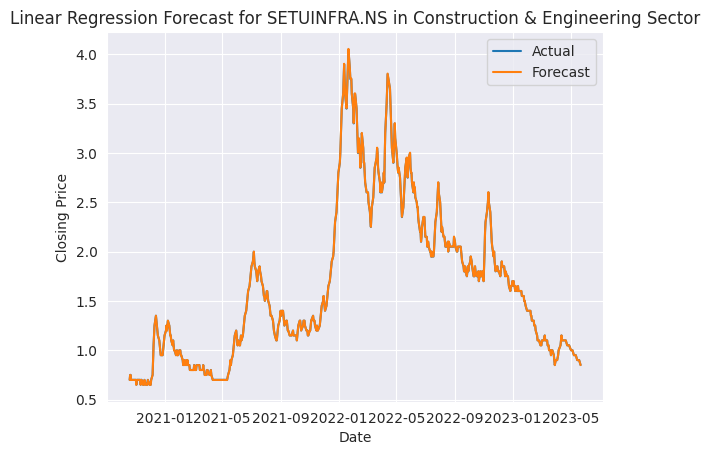

 This is mse score :  0.0013953754357869954
 This is rmse score :  0.03735472441053468
 This is r2 score :  0.997746776346149


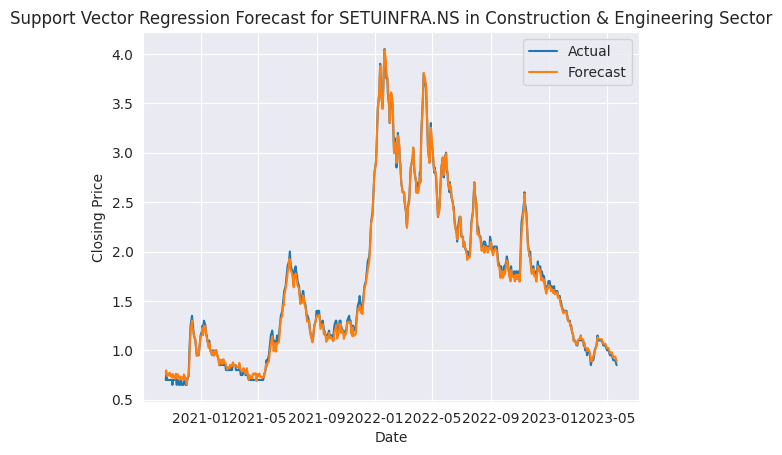

 This is mse score :  0.00042663444174027983
 This is rmse score :  0.020655131123773575
 This is r2 score :  0.9993110794478516


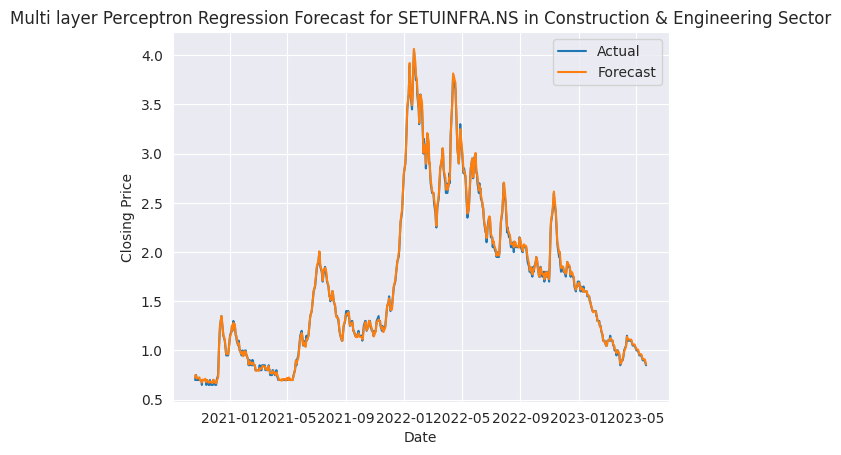

 This is mse score :  0.0036683080531820355
 This is rmse score :  0.060566558868587174
 This is r2 score :  0.994076491342002


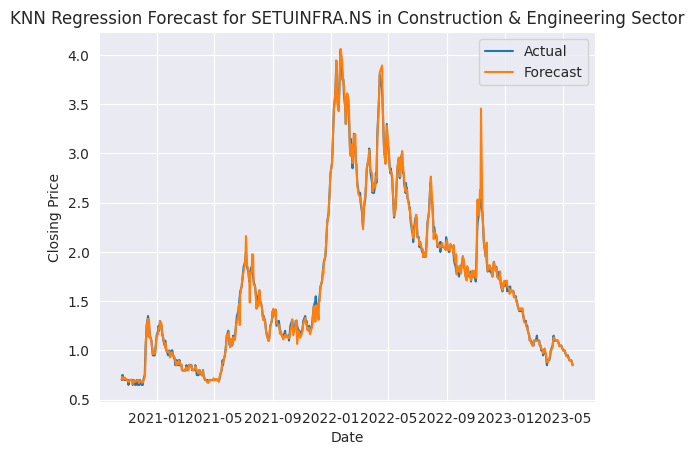

Forecasting HECPROJECT.NS in Construction & Engineering sector
 This is mse score :  0.12462188391568851
 This is rmse score :  0.3530182487006706
 This is r2 score :  0.9964521804449044


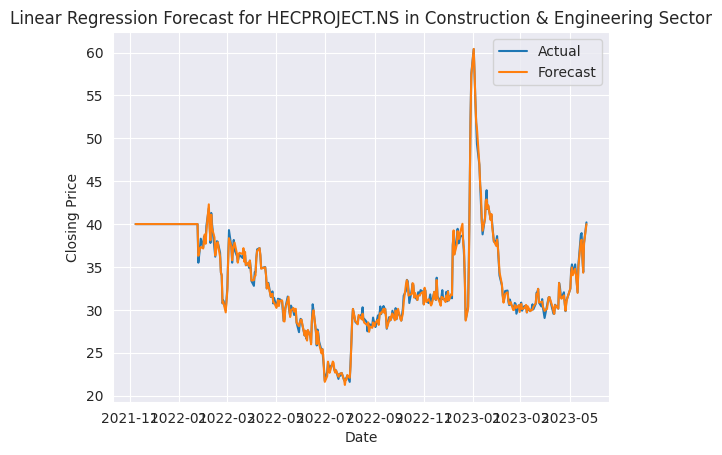

 This is mse score :  17.30664497903468
 This is rmse score :  4.160125596545695
 This is r2 score :  0.5073027981886595


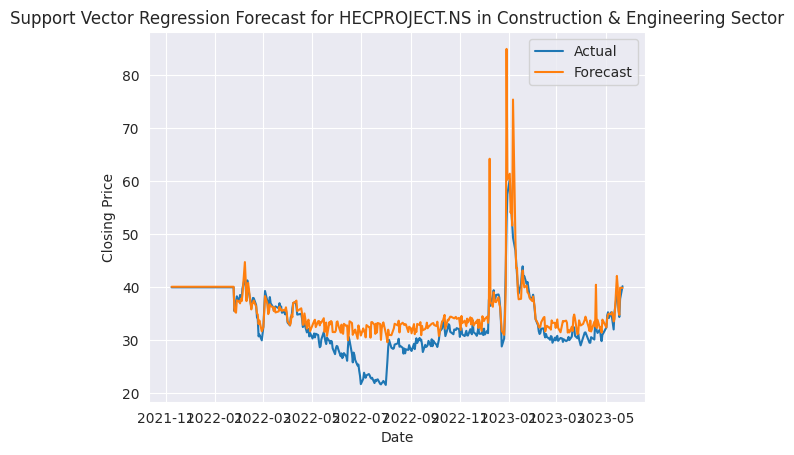

 This is mse score :  1.3108059412501314
 This is rmse score :  1.1449043371610272
 This is r2 score :  0.9626830954148548


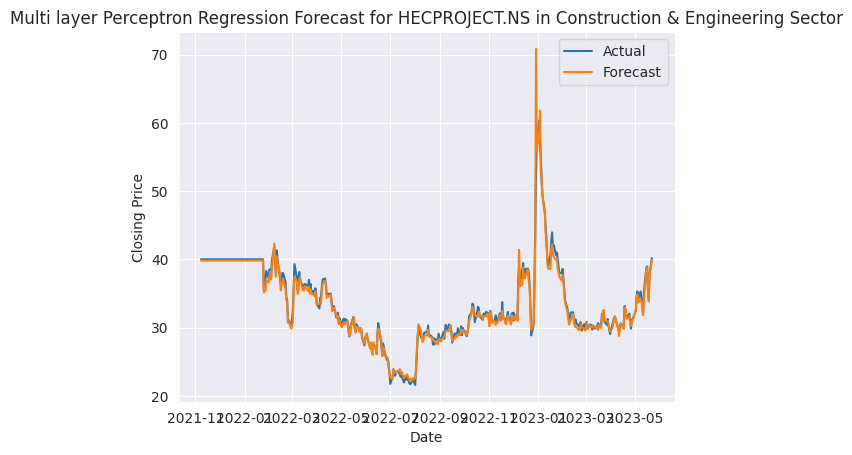

 This is mse score :  51.920999435892526
 This is rmse score :  7.205622765305753
 This is r2 score :  -0.47812191030102813


KeyboardInterrupt: ignored

In [49]:
from sklearn.model_selection import train_test_split

# Loop through each sector and stock
for sector, stocks in selected_stocks.items():
    for stock in stocks:
        print(f'Forecasting {stock} in {sector} sector')

        # Filter the data for the current stock
        data_stock = df_historical_data[df_historical_data['ticker'] == stock]

        # Separate the features and target variable
        X = data_stock.drop(['close', 'Sector', 'ticker'], axis=1)
        y = data_stock['close']
        
        # Split the data into training and testing sets
        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, shuffle=False)

        # Apply feature scaling
        scaler = StandardScaler()
        X_train_scaled = scaler.fit_transform(X_train)
        X_test_scaled = scaler.transform(X_test)

        # Apply regression algorithms and evaluate their performance
        for name, algorithm in regression_algorithms.items():
            algorithm.fit(X_train_scaled, y_train)
            y_pred = algorithm.predict(X_test_scaled)
            mse = mean_squared_error(y_test, y_pred)
            rmse = np.sqrt(mse)
            r2 = r2_score(y_test, y_pred)
            print(" This is mse score : ",mse)
            print(" This is rmse score : ",rmse)
            print(" This is r2 score : ", r2)
            # print(f'{name}: RMSE={rmse:rms}, R-squared={r2:.2f}')
            
            # Plot the forecasted and actual stock prices
            sns.lineplot(x=X_test.index, y=y_test, label='Actual')
            sns.lineplot(x=X_test.index, y=y_pred, label='Forecast')
            plt.xlabel('Date')
            plt.ylabel('Closing Price')
            plt.title(f'{name} Forecast for {stock} in {sector} Sector')
            plt.legend()
            plt.show()


LSTM ( With Good RMSE SCORE)

Forecasting TAINWALCHM.NS in Chemicals sector
Model: "sequential_32"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_48 (LSTM)              (None, 100, 50)           10400     
                                                                 
 lstm_49 (LSTM)              (None, 50)                20200     
                                                                 
 dense_48 (Dense)            (None, 25)                1275      
                                                                 
 dense_49 (Dense)            (None, 1)                 26        
                                                                 
Total params: 31,901
Trainable params: 31,901
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100
28/28 [==============================] - 11s 231ms/step - loss: 0.0216 - val_loss: 0.0038
Epoch 2/100
28/28 [==============

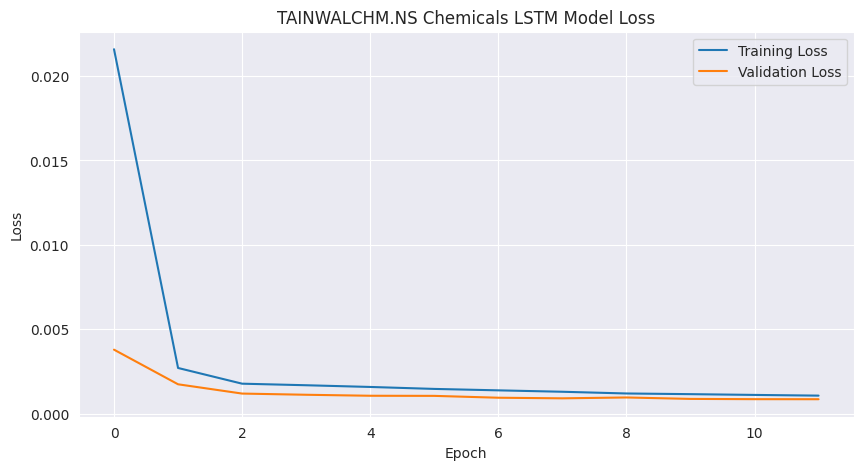

16/16 [==============================] - 1s 39ms/step
RMSE: 5.62
MAE: 3.58
R-squared: 0.88


<ipython-input-50-fa9bed50aa45>:112: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  valid['Predictions'] = predictions
<ipython-input-50-fa9bed50aa45>:118: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use('seaborn-whitegrid') # Set the plot style to white grid


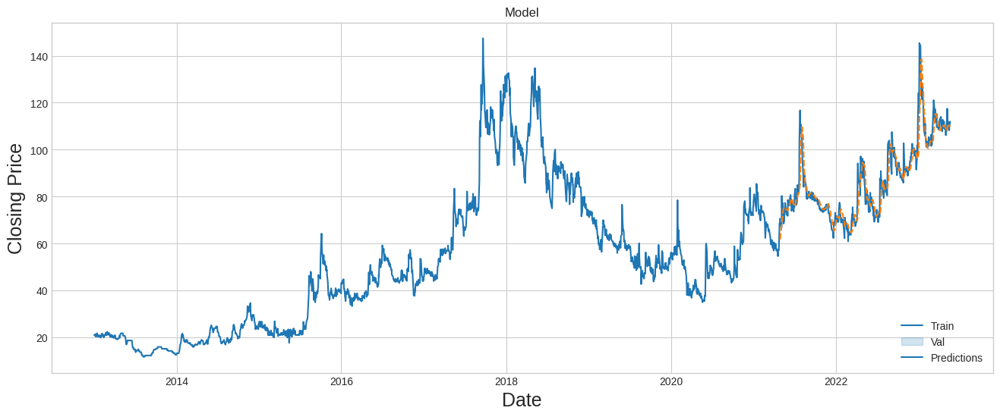

Forecasting ARVEE.NS in Chemicals sector
Model: "sequential_33"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_50 (LSTM)              (None, 100, 50)           10400     
                                                                 
 lstm_51 (LSTM)              (None, 50)                20200     
                                                                 
 dense_50 (Dense)            (None, 25)                1275      
                                                                 
 dense_51 (Dense)            (None, 1)                 26        
                                                                 
Total params: 31,901
Trainable params: 31,901
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100
14/14 [==============================] - 12s 214ms/step - loss: 0.0066 - val_loss: 0.0436
Epoch 2/100
14/14 [===================

KeyboardInterrupt: ignored

In [50]:
from keras.optimizers import RMSprop
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

for sector, stocks in selected_stocks.items():
    for stock in stocks:
        print(f'Forecasting {stock} in {sector} sector')

        # Get the historical data for the stock
        stock_data = df_historical_data[df_historical_data['ticker']==stock].copy()

        # Create a new dataframe with only the 'Close' column 
        data = stock_data.filter(['close'])
        data = pd.DataFrame(data)

        # Convert the dataframe to a numpy array
        dataset = data.values

        # Get the number of rows to train the model on
        training_data_len = int(np.ceil(len(dataset) * .80))

        # Scale the data
        from sklearn.preprocessing import MinMaxScaler

        scaler = MinMaxScaler(feature_range=(0,1))
        scaled_data = scaler.fit_transform(dataset)

        # Create the scaled training data set
        train_data = scaled_data[0:int(training_data_len), :]

        # Split the data into x_train and y_train data sets
        x_train = []
        y_train = []

        for i in range(100, len(train_data)):
            x_train.append(train_data[i-100:i, 0])
            y_train.append(train_data[i, 0])

        # Convert the x_train and y_train to numpy arrays 
        x_train, y_train = np.array(x_train), np.array(y_train)
        

        # Reshape the data
        x_train = np.reshape(x_train, (x_train.shape[0], x_train.shape[1], 1))

        # Build the LSTM model
        from keras.models import Sequential
        from keras.layers import Dense, LSTM, Dropout
        from keras.callbacks import EarlyStopping
        
        model = Sequential()
        model.add(LSTM(50, return_sequences=True, input_shape= (x_train.shape[1], 1)))
        model.add(LSTM(50, return_sequences=False))
        model.add(Dense(25))
        model.add(Dense(1))
        model.compile(loss="mean_squared_error", optimizer='adam')
        #model.compile(loss='mean_squared_error',optimizer='adam')
        model.summary()
        

        # Create EarlyStopping callback with a patience of 10 epochs and a minimum improvement of 0.001
        early_stop = EarlyStopping(monitor='val_loss', min_delta=0.001, patience=10, verbose=1)

        # Train the model
        # Train the model with the EarlyStopping callback
        history = model.fit(x_train, y_train, epochs=100, batch_size=64, verbose=1, validation_split=0.1, callbacks=[early_stop])
        
         # Plot the loss and accuracy curves for training and validation
        plt.figure(figsize=(10, 5))
        plt.plot(history.history['loss'], label='Training Loss')
        plt.plot(history.history['val_loss'], label='Validation Loss')
        plt.title(f'{stock} {sector} LSTM Model Loss')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.legend(loc='upper right')
        plt.show()
        
        # Create a new array containing scaled values from index 1543 to 2002
        test_data = scaled_data[training_data_len - 100:, :]

        # Create the data sets x_test and y_test
        x_test = []
        y_test = dataset[training_data_len:, :]

        for i in range(100, len(test_data)):
            x_test.append(test_data[i - 100:i, 0])

        # Convert the data to a numpy array
        x_test = np.array(x_test)

        # Reshape the data
        x_test = np.reshape(x_test, (x_test.shape[0], x_test.shape[1], 1))

        # Get the model's predicted price values
        predictions = model.predict(x_test)
        predictions = scaler.inverse_transform(predictions)

        # Get the root mean squared error (RMSE)
        rmse = np.sqrt(mean_squared_error(y_test, predictions))
        print(f"RMSE: {rmse:.2f}")

        # Get the mean absolute error (MAE)
        mae = mean_absolute_error(y_test, predictions)
        print(f"MAE: {mae:.2f}")

        # Get the coefficient of determination (R-squared)
        r2 = r2_score(y_test, predictions)
        print(f"R-squared: {r2:.2f}")

        # Plot the data
        train = data[:training_data_len]
        valid = data[training_data_len:]
        valid['Predictions'] = predictions

        # Visualize the data
        import matplotlib.pyplot as plt
        import seaborn as sns

        plt.style.use('seaborn-whitegrid') # Set the plot style to white grid

        plt.figure(figsize=(16, 6))
        plt.title('Model')
        plt.xlabel('Date', fontsize=18)
        plt.ylabel('Closing Price', fontsize=18)

        sns.lineplot(data=train['close'])
        sns.lineplot(data=valid[['close', 'Predictions']])

        plt.legend(['Train', 'Val', 'Predictions'], loc='lower right')
        plt.show()


GRU

Forecasting TAINWALCHM.NS in Chemicals sector
Model: "sequential_34"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru (GRU)                   (None, 100, 50)           7950      
                                                                 
 gru_1 (GRU)                 (None, 50)                15300     
                                                                 
 dense_52 (Dense)            (None, 25)                1275      
                                                                 
 dense_53 (Dense)            (None, 1)                 26        
                                                                 
Total params: 24,551
Trainable params: 24,551
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100
28/28 [==============================] - 10s 210ms/step - loss: 0.0201 - val_loss: 9.8789e-04
Epoch 2/100
28/28 [==========

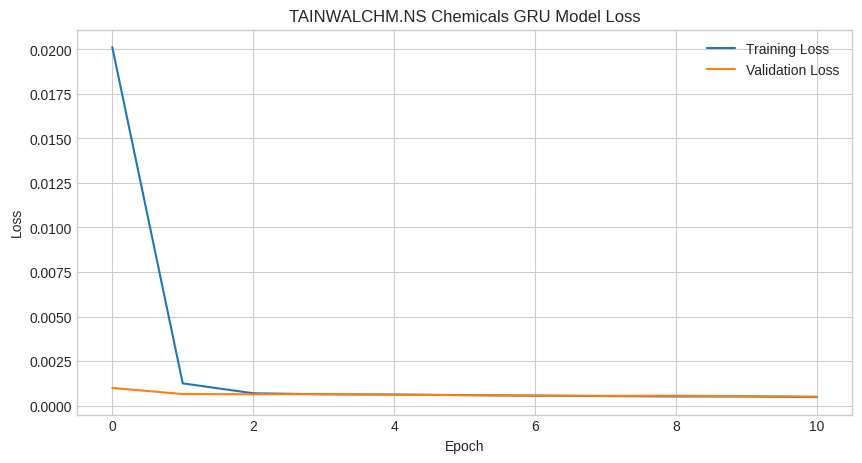

16/16 [==============================] - 3s 27ms/step
RMSE: 3.92
MAE: 2.51
R-squared: 0.94


<ipython-input-51-c9c5f410190f>:110: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  valid['Predictions'] = predictions
<ipython-input-51-c9c5f410190f>:116: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use('seaborn-whitegrid') # Set the plot style to white grid


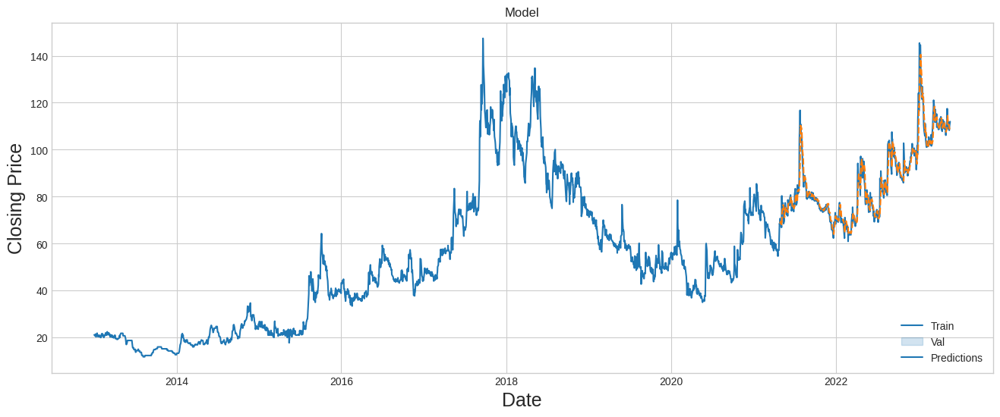

Forecasting ARVEE.NS in Chemicals sector
Model: "sequential_35"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_2 (GRU)                 (None, 100, 50)           7950      
                                                                 
 gru_3 (GRU)                 (None, 50)                15300     
                                                                 
 dense_54 (Dense)            (None, 25)                1275      
                                                                 
 dense_55 (Dense)            (None, 1)                 26        
                                                                 
Total params: 24,551
Trainable params: 24,551
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100
14/14 [==============================] - 8s 255ms/step - loss: 0.0069 - val_loss: 0.0434
Epoch 2/100
14/14 [====================

KeyboardInterrupt: ignored

In [51]:
from keras.optimizers import RMSprop

for sector, stocks in selected_stocks.items():
    for stock in stocks:
        print(f'Forecasting {stock} in {sector} sector')

        # Get the historical data for the stock
        stock_data = df_historical_data[df_historical_data['ticker']==stock].copy()

        # Create a new dataframe with only the 'Close' column 
        data = stock_data.filter(['close'])
        data = pd.DataFrame(data)

        # Convert the dataframe to a numpy array
        dataset = data.values

        # Get the number of rows to train the model on
        training_data_len = int(np.ceil(len(dataset) * .80))

        # Scale the data
        from sklearn.preprocessing import MinMaxScaler

        scaler = MinMaxScaler(feature_range=(0,1))
        scaled_data = scaler.fit_transform(dataset)

        # Create the scaled training data set
        train_data = scaled_data[0:int(training_data_len), :]

        # Split the data into x_train and y_train data sets
        x_train = []
        y_train = []

        for i in range(100, len(train_data)):
            x_train.append(train_data[i-100:i, 0])
            y_train.append(train_data[i, 0])

        # Convert the x_train and y_train to numpy arrays 
        x_train, y_train = np.array(x_train), np.array(y_train)
        

        # Reshape the data
        x_train = np.reshape(x_train, (x_train.shape[0], x_train.shape[1], 1))

        # Build the GRU model
        from keras.models import Sequential
        from keras.layers import Dense, GRU, Dropout
        from keras.callbacks import EarlyStopping
        
        model = Sequential()
        model.add(GRU(50, return_sequences=True, input_shape= (x_train.shape[1], 1)))
        model.add(GRU(50, return_sequences=False))
        model.add(Dense(25))
        model.add(Dense(1))
        model.compile(loss="mean_squared_error", optimizer='adam')
        #model.compile(loss='mean_squared_error',optimizer='adam')
        model.summary()
        

        # Create EarlyStopping callback with a patience of 10 epochs and a minimum improvement of 0.001
        early_stop = EarlyStopping(monitor='val_loss', min_delta=0.001, patience=10, verbose=1)

        # Train the model
        # Train the model with the EarlyStopping callback
        history = model.fit(x_train, y_train, epochs=100, batch_size=64, verbose=1, validation_split=0.1, callbacks=[early_stop])
        
         # Plot the loss and accuracy curves for training and validation
        plt.figure(figsize=(10, 5))
        plt.plot(history.history['loss'], label='Training Loss')
        plt.plot(history.history['val_loss'], label='Validation Loss')
        plt.title(f'{stock} {sector} GRU Model Loss')
        plt.xlabel('Epoch')
        plt.ylabel('Loss')
        plt.legend(loc='upper right')
        plt.show()
        
        # Create a new array containing scaled values from index 1543 to 2002
        test_data = scaled_data[training_data_len - 100:, :]

        # Create the data sets x_test and y_test
        x_test = []
        y_test = dataset[training_data_len:, :]

        for i in range(100, len(test_data)):
            x_test.append(test_data[i - 100:i, 0])
        
        # Convert the data to a numpy array
        x_test = np.array(x_test)

        # Reshape the data
        x_test = np.reshape(x_test, (x_test.shape[0], x_test.shape[1], 1))

        # Get the model's predicted price values
        predictions = model.predict(x_test)
        predictions = scaler.inverse_transform(predictions)

        rmse = np.sqrt(mean_squared_error(y_test, predictions))
        print(f"RMSE: {rmse:.2f}")

        # Get the mean absolute error (MAE)
        mae = mean_absolute_error(y_test, predictions)
        print(f"MAE: {mae:.2f}")

        # Get the coefficient of determination (R-squared)
        r2 = r2_score(y_test, predictions)
        print(f"R-squared: {r2:.2f}")

        # Plot the data
        train = data[:training_data_len]
        valid = data[training_data_len:]
        valid['Predictions'] = predictions

        # Visualize the data
        import matplotlib.pyplot as plt
        import seaborn as sns

        plt.style.use('seaborn-whitegrid') # Set the plot style to white grid

        plt.figure(figsize=(16, 6))
        plt.title('Model')
        plt.xlabel('Date', fontsize=18)
        plt.ylabel('Closing Price', fontsize=18)

        sns.lineplot(data=train['close'])
        sns.lineplot(data=valid[['close', 'Predictions']])

        plt.legend(['Train', 'Val', 'Predictions'], loc='lower right')
        plt.show()


# Time Series(ARIMA)

In [52]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.arima_model import ARIMA
from sklearn.metrics import mean_squared_error, mean_absolute_error
import math
from statsmodels.tsa.stattools import adfuller
import statsmodels
import itertools
#from statsmodels.tsa.arima_model import ARIMA
from statsmodels.tsa.arima.model import ARIMA
print(statsmodels.__version__)

0.13.5


Forecasting TAINWALCHM.NS in Chemicals sector


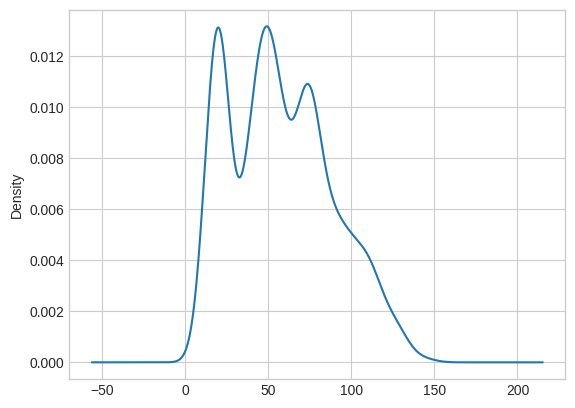

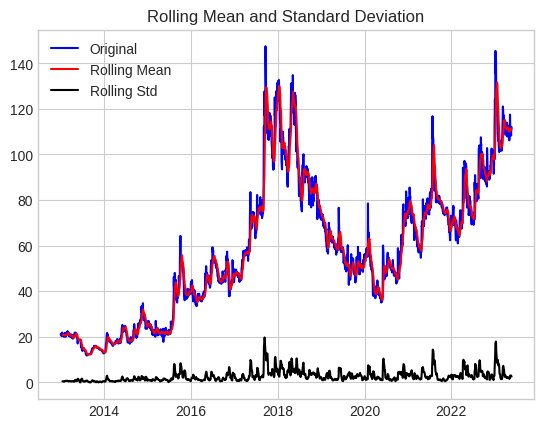

Results of Dickey-Fuller Test:
Test Statistics                  -1.976412
p-value                           0.297010
No. of lags used                  0.000000
Number of observations used    2561.000000
Critical value (1%)              -3.432906
Critical value (5%)              -2.862669
Critical value (10%)             -2.567371
dtype: float64


<Figure size 640x480 with 0 Axes>

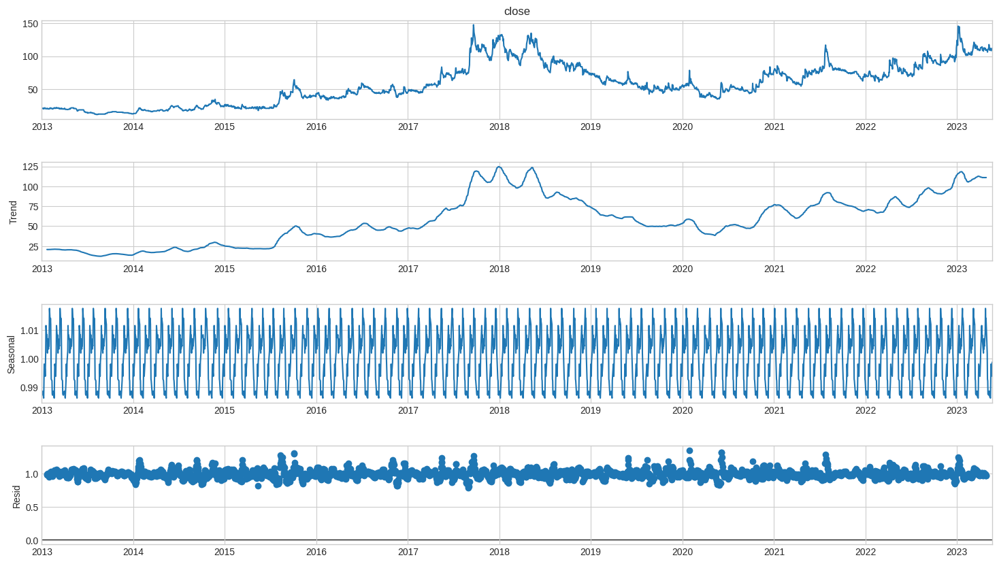

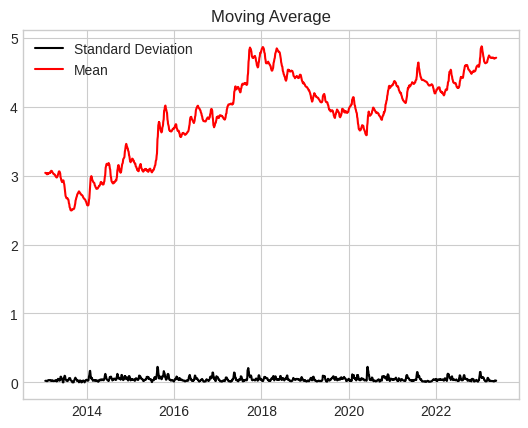

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


                               SARIMAX Results                                
Dep. Variable:                  close   No. Observations:                 2302
Model:                 ARIMA(1, 2, 2)   Log Likelihood                4126.502
Date:                Mon, 22 May 2023   AIC                          -8245.003
Time:                        19:39:01   BIC                          -8222.041
Sample:                             0   HQIC                         -8236.631
                               - 2302                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.9946      0.014    -70.369      0.000      -1.022      -0.967
ma.L1         -0.0072      0.237     -0.030      0.976      -0.472       0.458
ma.L2         -0.9928      0.234     -4.244      0.0

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(


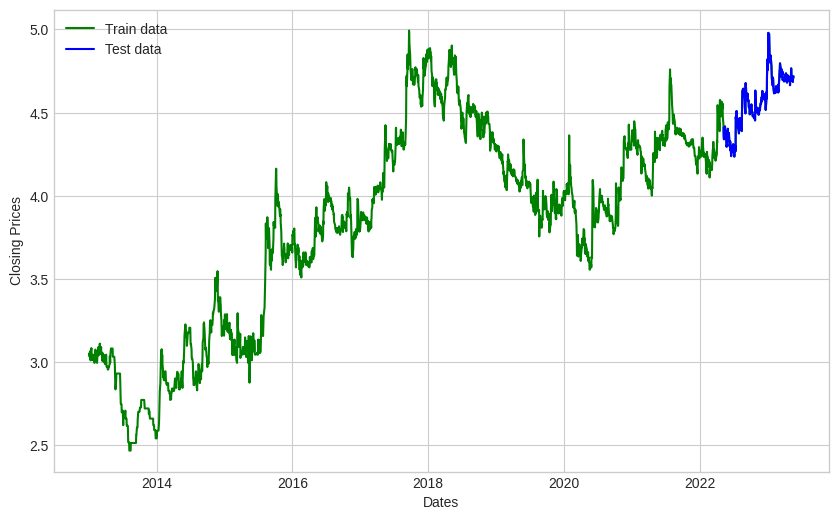

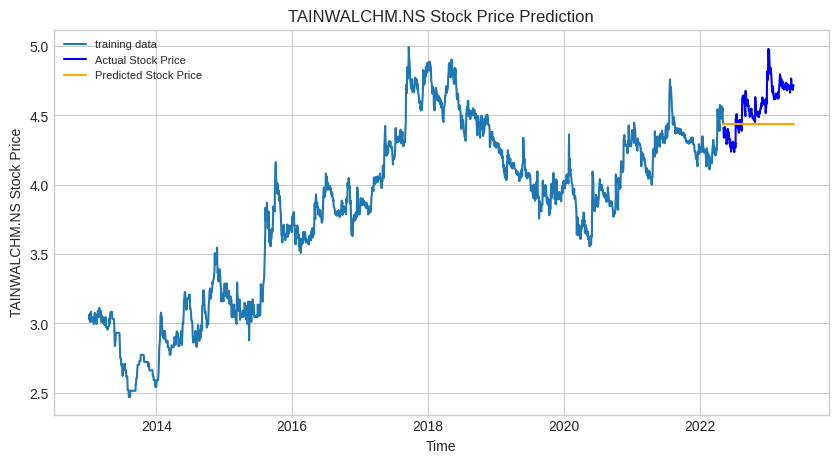

MSE: 0.04148000373988003
MAE: 0.17291798443740627
RMSE: 0.20366640307100242
MAPE: 0.03731543810468289
Forecasting ARVEE.NS in Chemicals sector


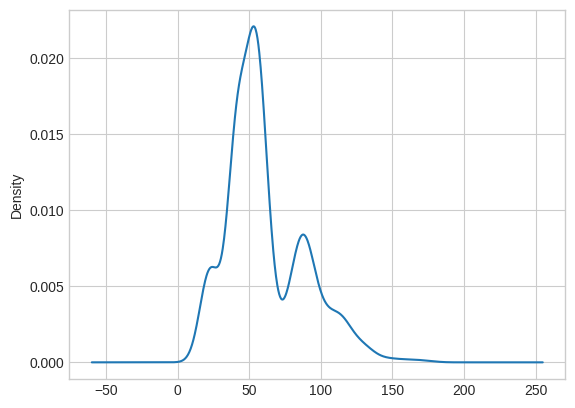

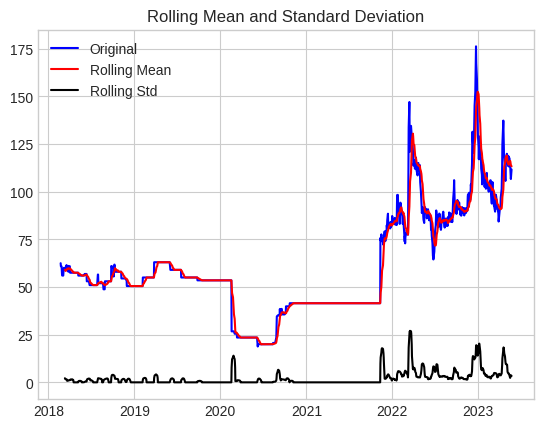

Results of Dickey-Fuller Test:
Test Statistics                  -1.217433
p-value                           0.666052
No. of lags used                 20.000000
Number of observations used    1271.000000
Critical value (1%)              -3.435505
Critical value (5%)              -2.863817
Critical value (10%)             -2.567982
dtype: float64


<Figure size 640x480 with 0 Axes>

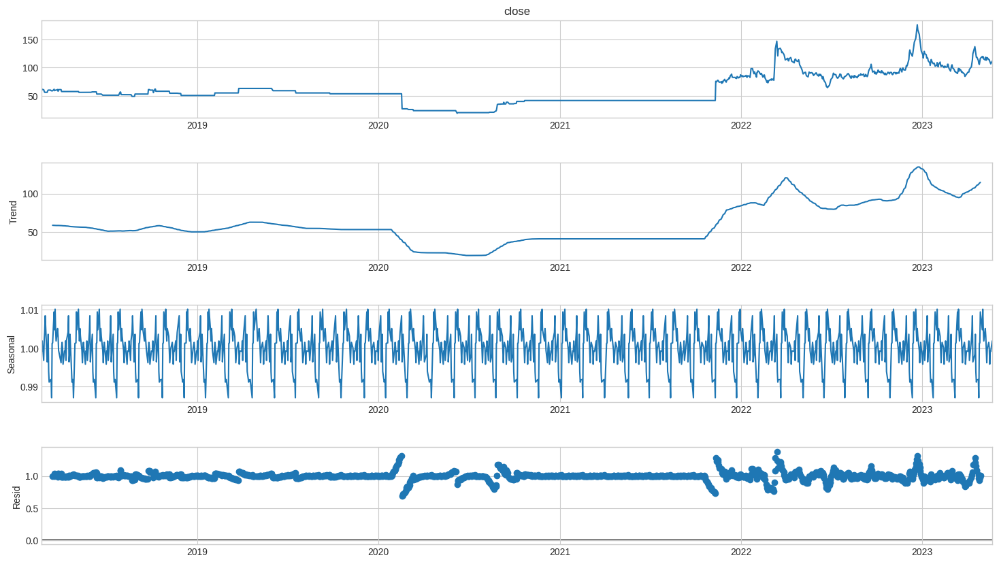

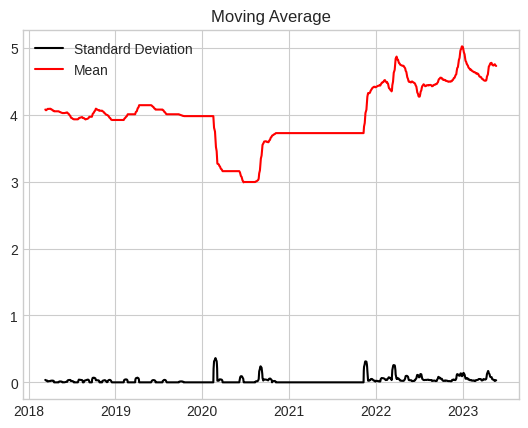

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/di

                               SARIMAX Results                                
Dep. Variable:                  close   No. Observations:                 1159
Model:                 ARIMA(1, 2, 2)   Log Likelihood                2182.917
Date:                Mon, 22 May 2023   AIC                          -4357.834
Time:                        19:39:08   BIC                          -4337.620
Sample:                             0   HQIC                         -4350.206
                               - 1159                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.9936      0.014    -71.994      0.000      -1.021      -0.967
ma.L1         -0.0026      1.786     -0.001      0.999      -3.502       3.497
ma.L2         -0.9973      1.784     -0.559      0.5

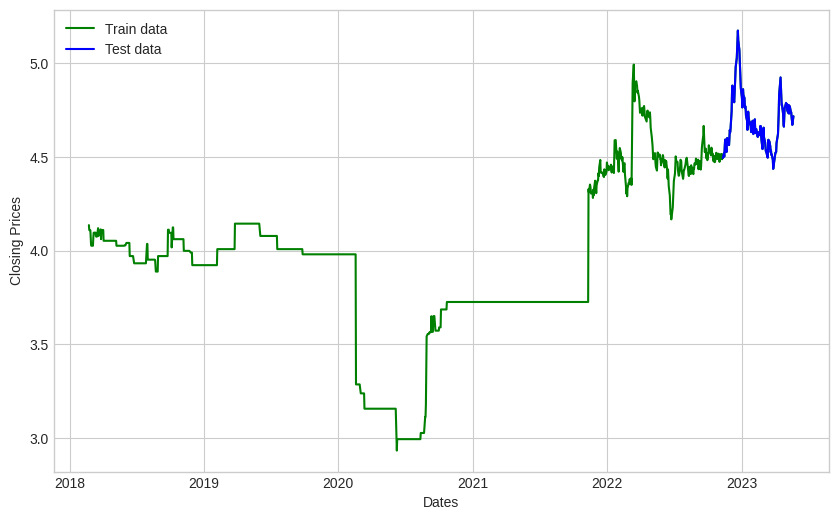

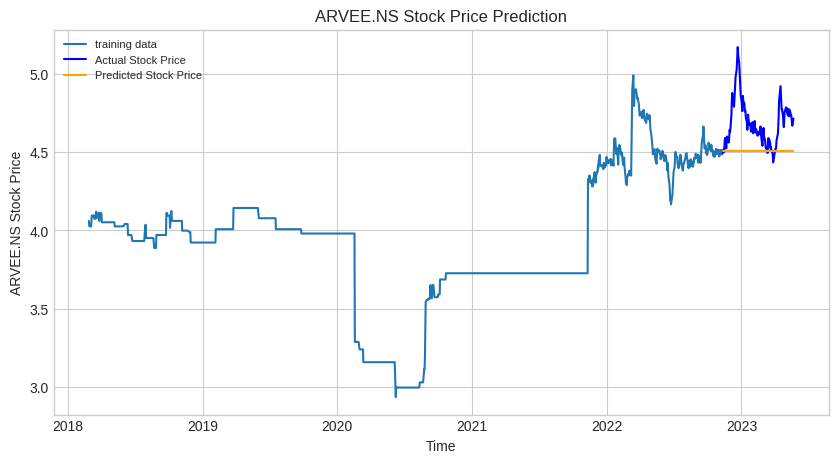

MSE: 0.05698545413108319
MAE: 0.19004059768604412
RMSE: 0.23871626281232536
MAPE: 0.039560677010332744
Forecasting AGROPHOS.NS in Chemicals sector


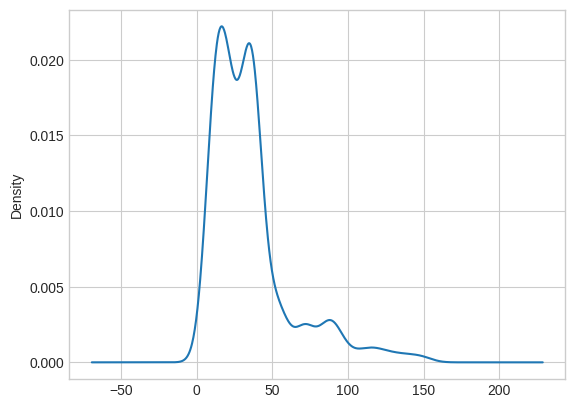

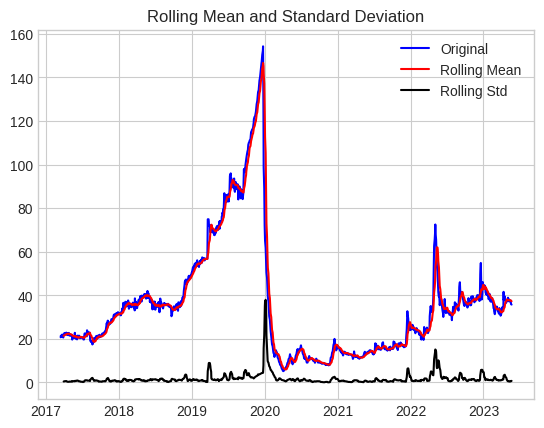

Results of Dickey-Fuller Test:
Test Statistics                  -2.123570
p-value                           0.235143
No. of lags used                  3.000000
Number of observations used    1525.000000
Critical value (1%)              -3.434645
Critical value (5%)              -2.863437
Critical value (10%)             -2.567780
dtype: float64


<Figure size 640x480 with 0 Axes>

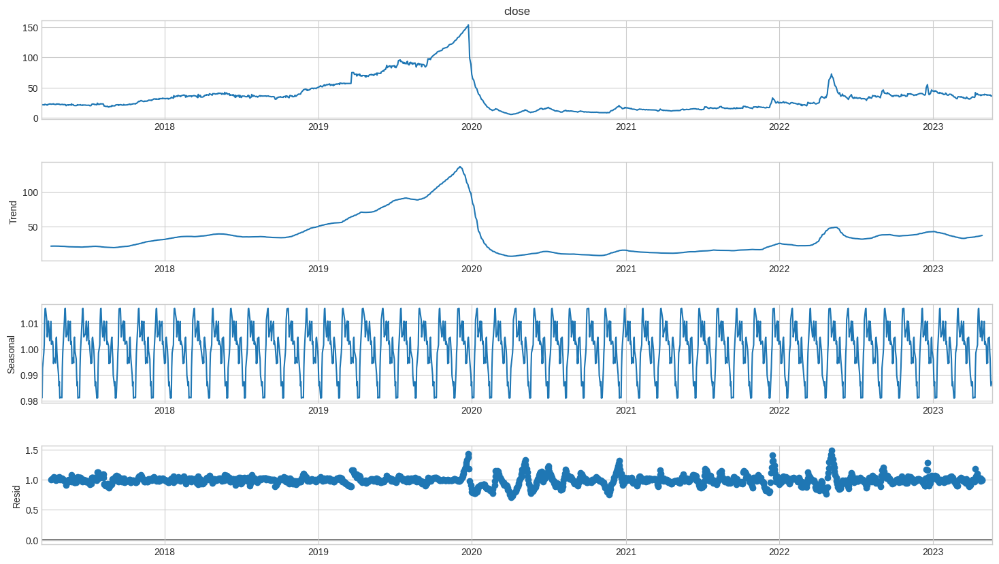

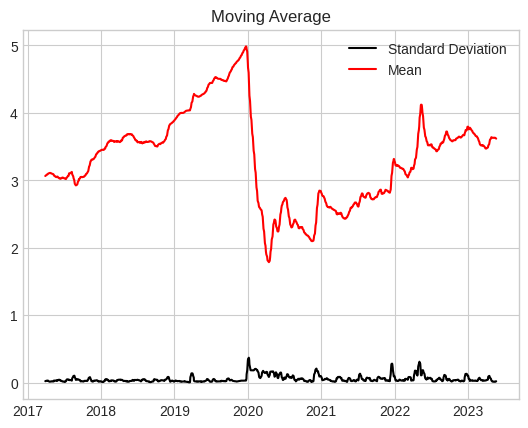

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


                               SARIMAX Results                                
Dep. Variable:                  close   No. Observations:                 1373
Model:                 ARIMA(1, 2, 2)   Log Likelihood                2531.695
Date:                Mon, 22 May 2023   AIC                          -5055.390
Time:                        19:39:14   BIC                          -5034.497
Sample:                             0   HQIC                         -5047.572
                               - 1373                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.9313      0.175     -5.330      0.000      -1.274      -0.589
ma.L1          0.0411      0.179      0.229      0.819      -0.310       0.393
ma.L2         -0.8171      0.162     -5.035      0.0

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(


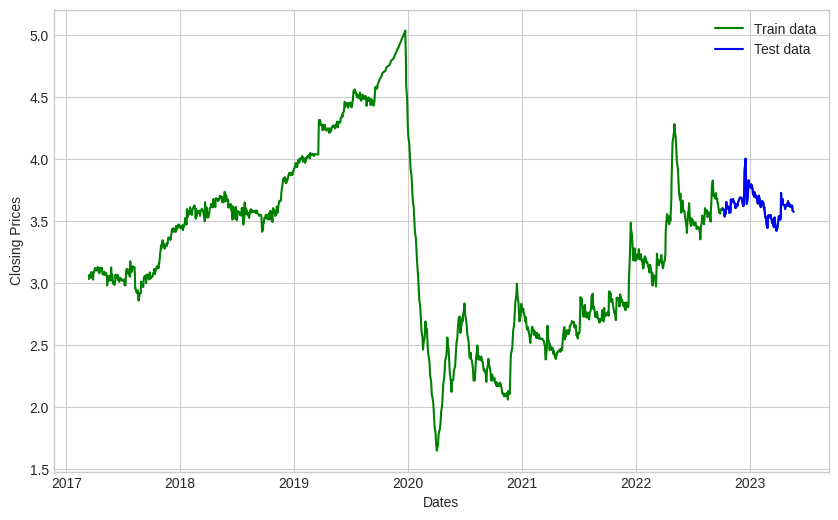

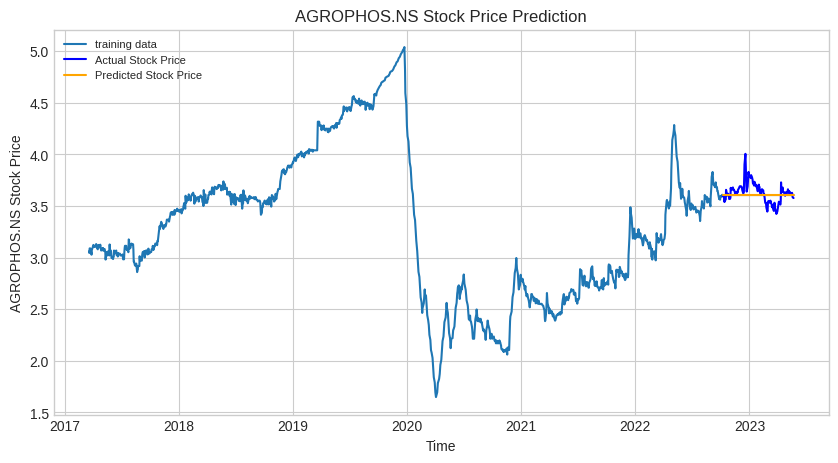

MSE: 0.009549176287331042
MAE: 0.074357016520012
RMSE: 0.09771988685692919
MAPE: 0.020341689873489725
Forecasting SIKKO.NS in Chemicals sector


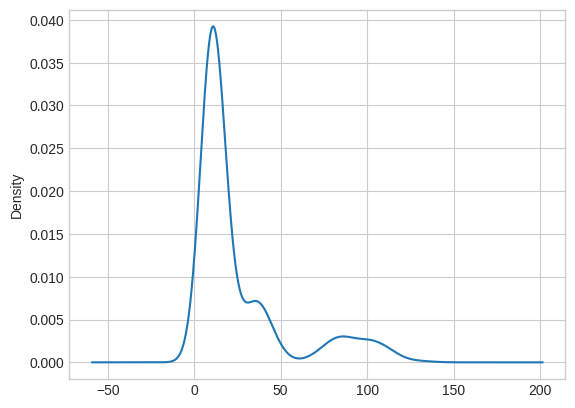

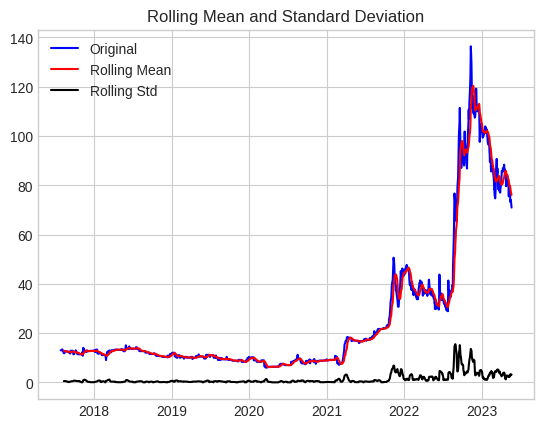

Results of Dickey-Fuller Test:
Test Statistics                  -0.730284
p-value                           0.838749
No. of lags used                 22.000000
Number of observations used    1412.000000
Critical value (1%)              -3.434990
Critical value (5%)              -2.863589
Critical value (10%)             -2.567861
dtype: float64


<Figure size 640x480 with 0 Axes>

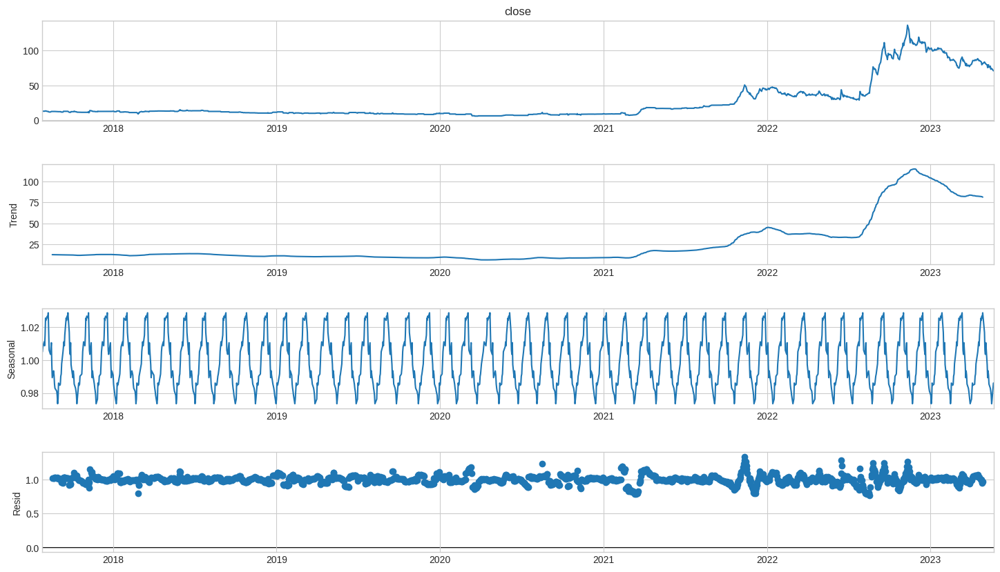

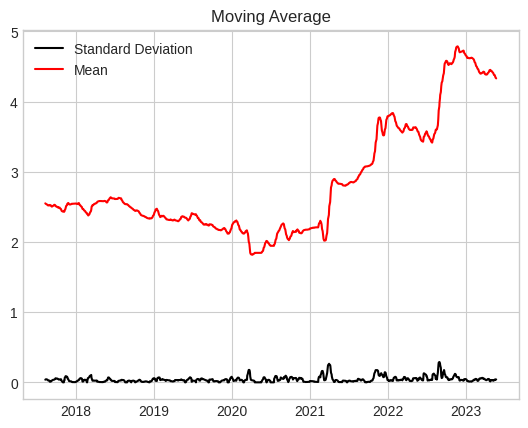

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:471: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


                               SARIMAX Results                                
Dep. Variable:                  close   No. Observations:                 1288
Model:                 ARIMA(1, 2, 2)   Log Likelihood                2433.255
Date:                Mon, 22 May 2023   AIC                          -4858.510
Time:                        19:39:19   BIC                          -4837.873
Sample:                             0   HQIC                         -4850.763
                               - 1288                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.8808      0.684     -1.288      0.198      -2.221       0.460
ma.L1         -0.1119      0.676     -0.165      0.869      -1.438       1.214
ma.L2         -0.8804      0.673     -1.309      0.1

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:834: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(


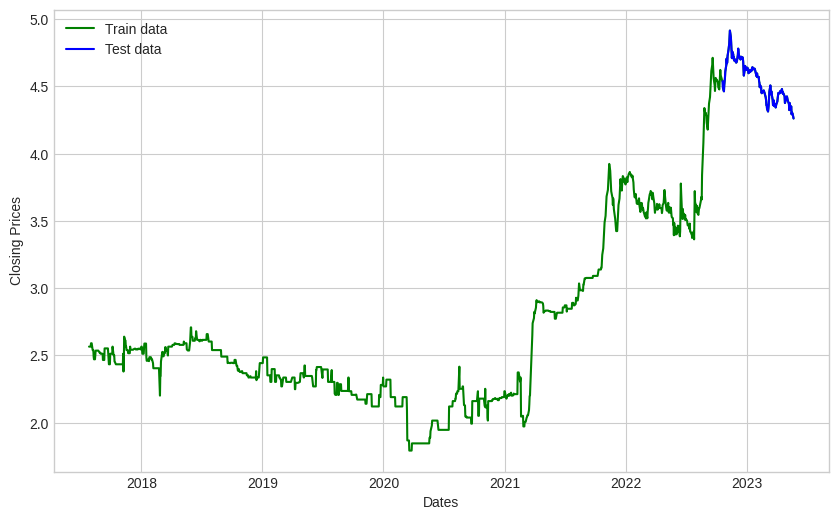

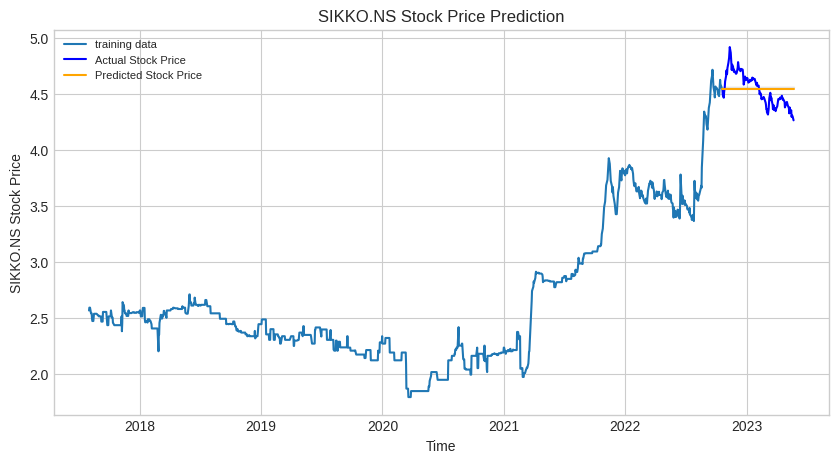

MSE: 0.02149855354131988
MAE: 0.12939859386096225
RMSE: 0.14662385052002924
MAPE: 0.028475284090033207
Forecasting ALKALI.NS in Chemicals sector


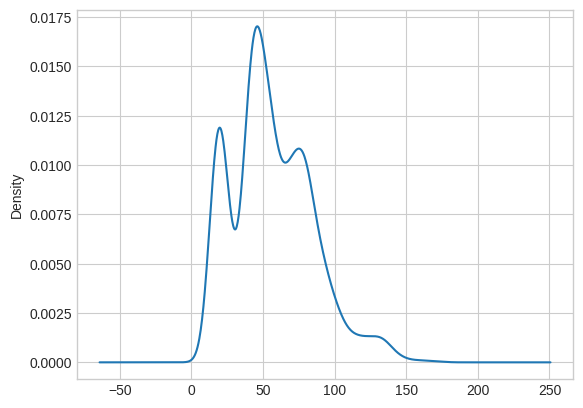

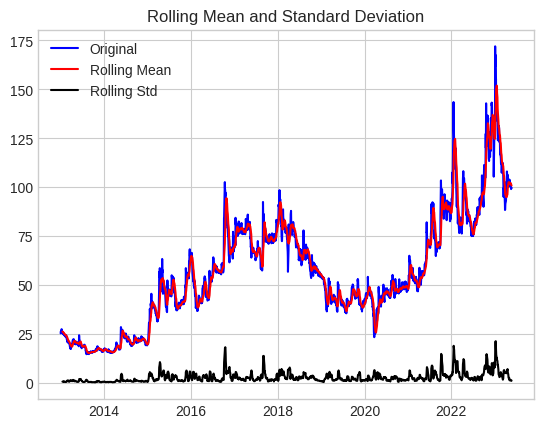

Results of Dickey-Fuller Test:
Test Statistics                  -1.678854
p-value                           0.442039
No. of lags used                 19.000000
Number of observations used    2542.000000
Critical value (1%)              -3.432925
Critical value (5%)              -2.862678
Critical value (10%)             -2.567376
dtype: float64


<Figure size 640x480 with 0 Axes>

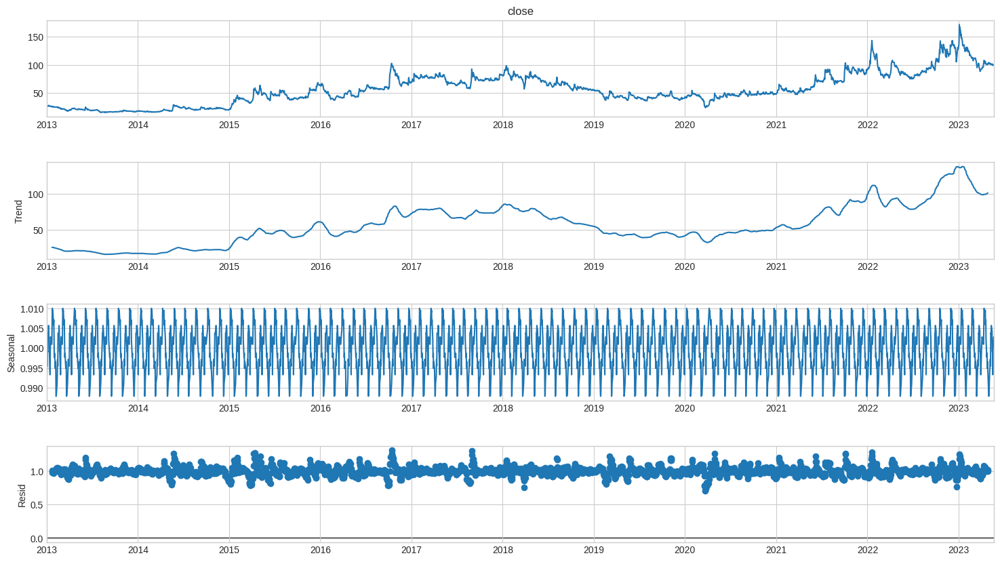

KeyboardInterrupt: ignored

In [53]:
# Define selected_stocks and stock_data here

from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.arima.model import ARIMA
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import math

# Set a higher limit for the number of rows displayed when printing Pandas dataframes
# Set a higher limit for the number of rows displayed when printing Pandas dataframes
pd.set_option('display.max_rows', 1000)

# Define a function to test for stationarity
def test_stationarity(timeseries):
    # Assuming the timeseries object has a datetime index
    timeseries = timeseries['2013':]
    
    # Determing rolling statistics
    rolmean = timeseries.rolling(12).mean()
    rolstd = timeseries.rolling(12).std()

    # Plot rolling statistics:
    plt.plot(timeseries, color='blue', label='Original')
    plt.plot(rolmean, color='red', label='Rolling Mean')
    plt.plot(rolstd, color='black', label='Rolling Std')
    plt.legend(loc='best')
    plt.title('Rolling Mean and Standard Deviation')
    plt.show(block=False)

    print("Results of Dickey-Fuller Test:")
    adft = adfuller(timeseries, autolag='AIC')

    # output for adft will give us without defining what the values are.
    # hence we manually write what values does it explains using a for loop
    output = pd.Series(adft[0:4], index=['Test Statistics', 'p-value', 'No. of lags used', 'Number of observations used'])
    for key, value in adft[4].items():
        output[f'Critical value ({key})'] = value
    print(output)
    

# Loop over the selected stocks
for sector, stocks in selected_stocks.items():
    for stock in stocks:
        print(f'Forecasting {stock} in {sector} sector')
        
        # Get the stock data
        stock_data = df_historical_data.loc[df_historical_data['ticker'] == stock]
        df_close = stock_data['close']

        # Distribution of the dataset
        df_close.plot(kind='kde')
        plt.show()

        # Test for stationarity
        test_stationarity(df_close)

        # To separate the trend and the seasonality from a time series,
        # we can decompose the series using the following code.
        result = seasonal_decompose(df_close, model='multiplicative', period=30)
        fig = plt.figure()
        fig = result.plot()
        fig.set_size_inches(16, 9)
        plt.show()

        # Eliminate trend
        df_log = np.log(df_close)
        moving_avg = df_log.rolling(12).mean()
        std_dev = df_log.rolling(12).std()
        plt.legend(loc='best')
        plt.title('Moving Average')
        plt.plot(std_dev, color="black", label="Standard Deviation")
        plt.plot(moving_avg, color="red", label="Mean")
        plt.legend()
        plt.show()

        # Split data into train and test set
        train_data, test_data = df_log[3:int(len(df_log)*0.9)], df_log[int(len(df_log)*0.9):]
        plt.figure(figsize=(10, 6))
        plt.grid(True)
        plt.xlabel('Dates')
        plt.ylabel('Closing Prices')
        plt.plot(df_log, 'green', label='Train data')

        plt.plot(test_data, 'blue', label='Test data')
        plt.legend()
        
        # Build Model
        model = ARIMA(train_data, order=(1,2,2))  
        fitted = model.fit()  #BFGS
        print(fitted.summary())
        
        #forecast_result = fitted.forecast(321, alpha=0.05)
        #fc = forecast_result[0]
        #se = forecast_result[1]
        #conf = forecast_result[2]


        # Forecast
        fc, se, conf = fitted.forecast(321, alpha=0.05)[:3]  
        # Make as pandas series
        fc_series = pd.Series(fc, index=test_data.index)

        if isinstance(conf, float):
            # conf is a float, set the confidence interval to a constant value
            lower_series = pd.Series([conf] * len(test_data), index=test_data.index)
            upper_series = pd.Series([conf] * len(test_data), index=test_data.index)
        else:
            # conf is an array, use the values for the confidence interval
            lower_series = pd.Series(conf[:, 0], index=test_data.index)
            upper_series = pd.Series(conf[:, 1], index=test_data.index)
        # Plot
        plt.figure(figsize=(10,5), dpi=100)
        plt.plot(train_data, label='training data')
        plt.plot(test_data, color = 'blue', label='Actual Stock Price')
        plt.plot(fc_series, color = 'orange',label='Predicted Stock Price')
        plt.fill_between(lower_series.index, lower_series, upper_series, 
                         color='k', alpha=.10)
        plt.title(f'{stock} Stock Price Prediction')
        plt.xlabel('Time')
        plt.ylabel(f'{stock} Stock Price')
        plt.legend(loc='upper left', fontsize=8)
        plt.show()

        # report performance
        mse = mean_squared_error(test_data, fc_series)
        print('MSE: '+str(mse))
        mae = mean_absolute_error(test_data, fc_series)
        print('MAE: '+str(mae))
        rmse = math.sqrt(mean_squared_error(test_data, fc_series))
        print('RMSE: '+str(rmse))
        mape = np.mean(np.abs(fc_series - test_data)/np.abs(test_data))
        print('MAPE: '+str(mape))


Ensmeble

- XG-Boost

- Random Forest

### XG-Boost

Forecasting TAINWALCHM.NS in Chemicals sector


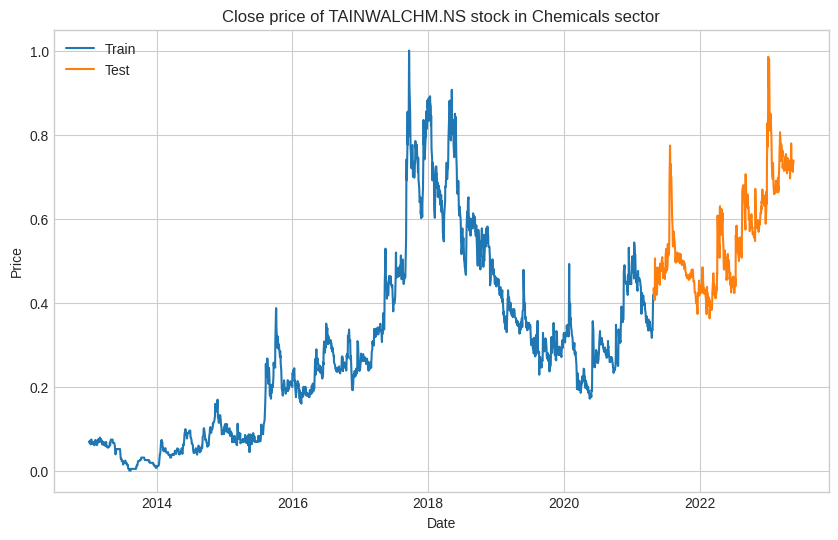

Fitting 5 folds for each of 27 candidates, totalling 135 fits
Best hyperparameters:  {'learning_rate': 0.1, 'max_depth': 7, 'n_estimators': 200}
Best score:  0.8852295442070366


/usr/local/lib/python3.10/dist-packages/xgboost/sklearn.py:835: UserWarning: `eval_metric` in `fit` method is deprecated for better compatibility with scikit-learn, use `eval_metric` in constructor or`set_params` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/xgboost/sklearn.py:835: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


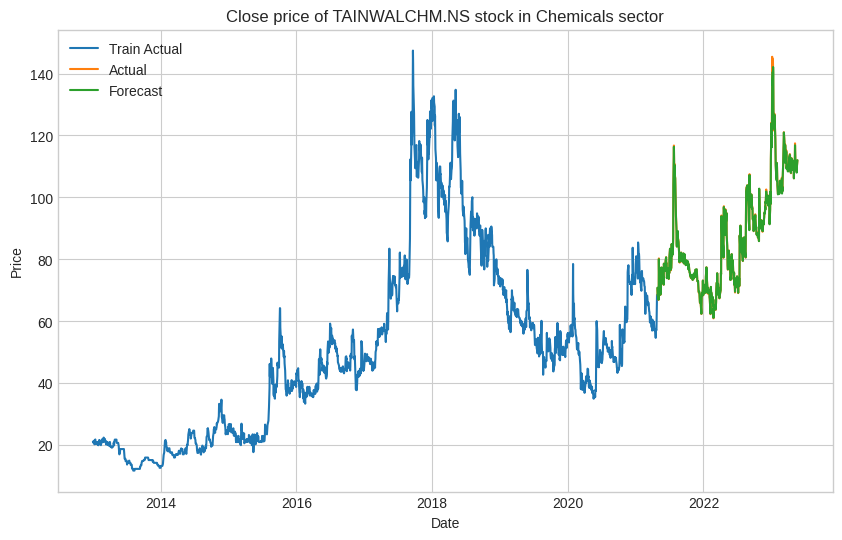

TAINWALCHM.NS Chemicals sector model evaluation metrics:
R-squared score: 0.9983498308484564
RMSE: 87.80390005437813
Forecasting ARVEE.NS in Chemicals sector


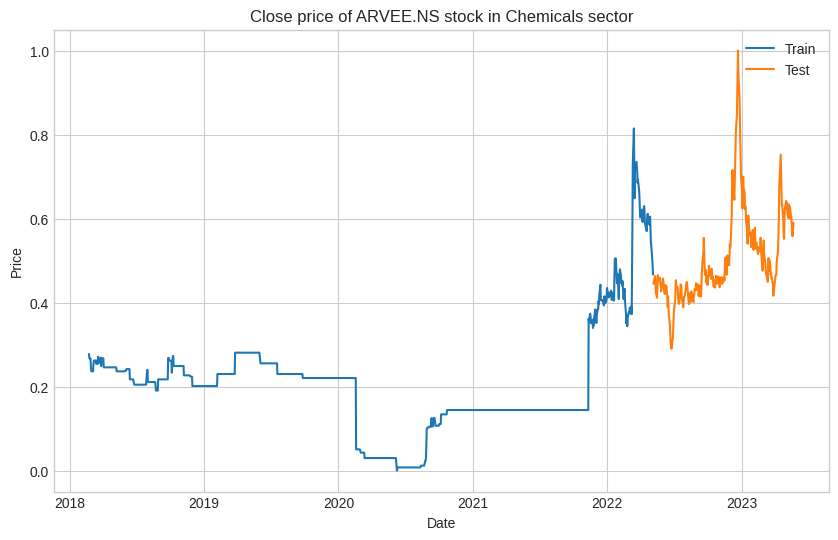

Fitting 5 folds for each of 27 candidates, totalling 135 fits
Best hyperparameters:  {'learning_rate': 0.1, 'max_depth': 5, 'n_estimators': 200}
Best score:  0.6411462808022172


/usr/local/lib/python3.10/dist-packages/xgboost/sklearn.py:835: UserWarning: `eval_metric` in `fit` method is deprecated for better compatibility with scikit-learn, use `eval_metric` in constructor or`set_params` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/xgboost/sklearn.py:835: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


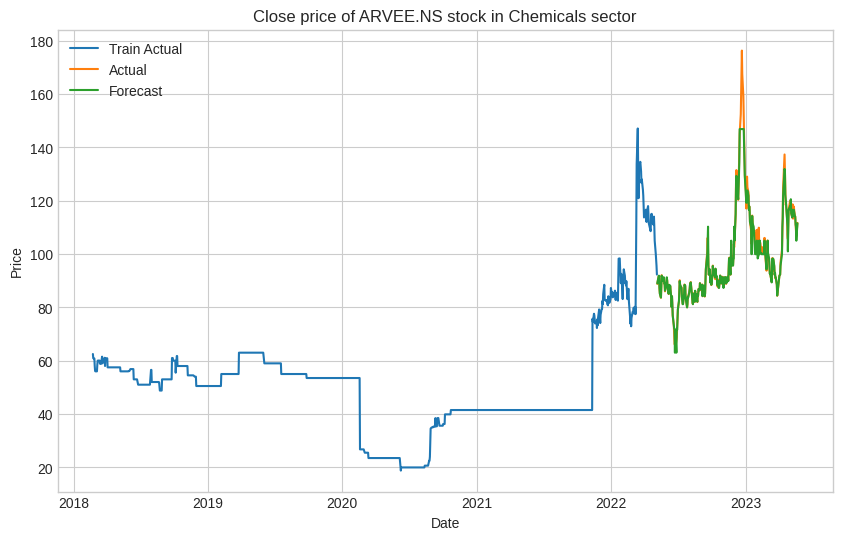

ARVEE.NS Chemicals sector model evaluation metrics:
R-squared score: 0.9639802250733956
RMSE: 98.96434736705812
Forecasting AGROPHOS.NS in Chemicals sector


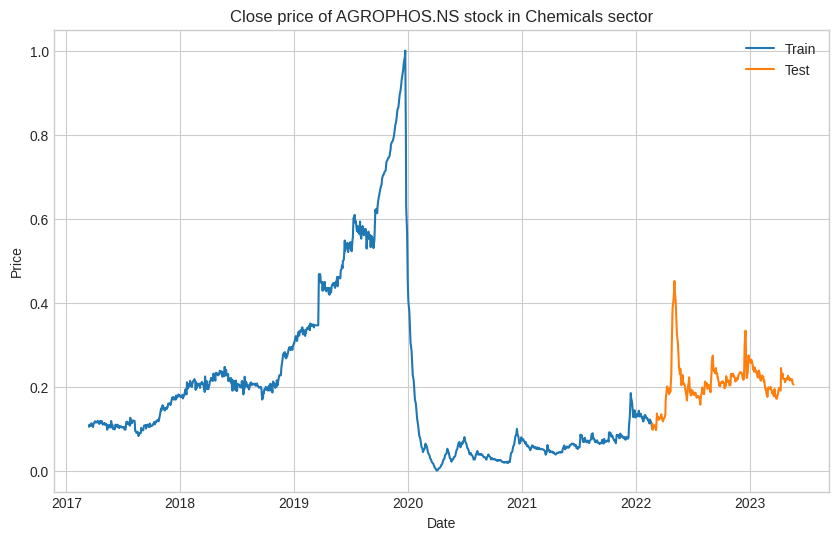

Fitting 5 folds for each of 27 candidates, totalling 135 fits
Best hyperparameters:  {'learning_rate': 0.1, 'max_depth': 5, 'n_estimators': 200}
Best score:  0.6599597384596189


/usr/local/lib/python3.10/dist-packages/xgboost/sklearn.py:835: UserWarning: `eval_metric` in `fit` method is deprecated for better compatibility with scikit-learn, use `eval_metric` in constructor or`set_params` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/xgboost/sklearn.py:835: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


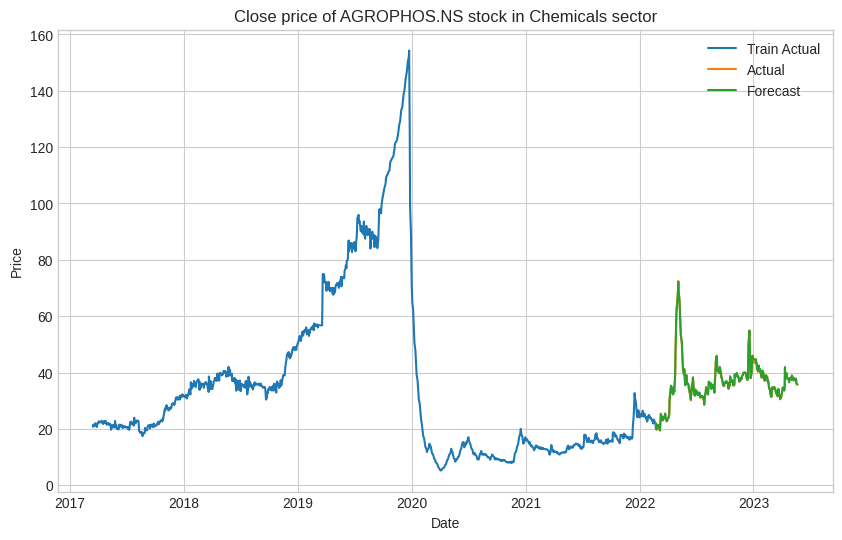

AGROPHOS.NS Chemicals sector model evaluation metrics:
R-squared score: 0.9978830862540473
RMSE: 37.304183545326
Forecasting SIKKO.NS in Chemicals sector


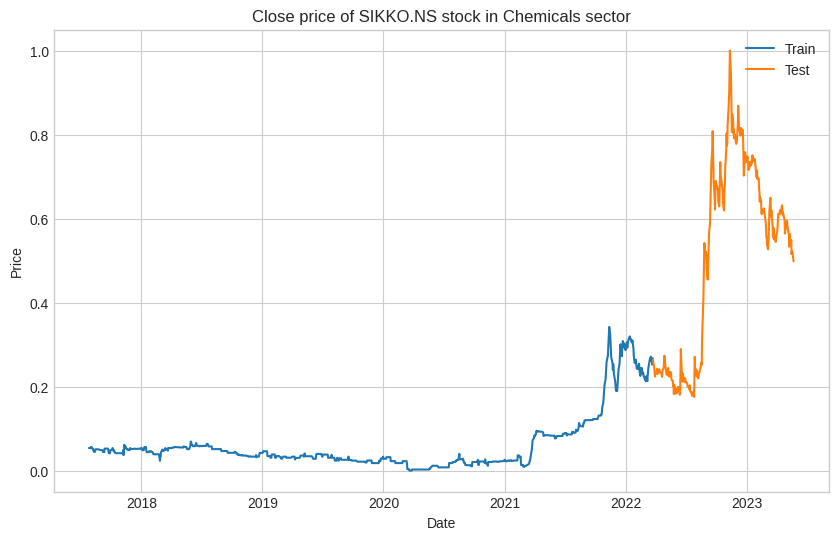

Fitting 5 folds for each of 27 candidates, totalling 135 fits
Best hyperparameters:  {'learning_rate': 0.1, 'max_depth': 7, 'n_estimators': 200}
Best score:  0.5924680428633249


/usr/local/lib/python3.10/dist-packages/xgboost/sklearn.py:835: UserWarning: `eval_metric` in `fit` method is deprecated for better compatibility with scikit-learn, use `eval_metric` in constructor or`set_params` instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/xgboost/sklearn.py:835: UserWarning: `early_stopping_rounds` in `fit` method is deprecated for better compatibility with scikit-learn, use `early_stopping_rounds` in constructor or`set_params` instead.
  warnings.warn(


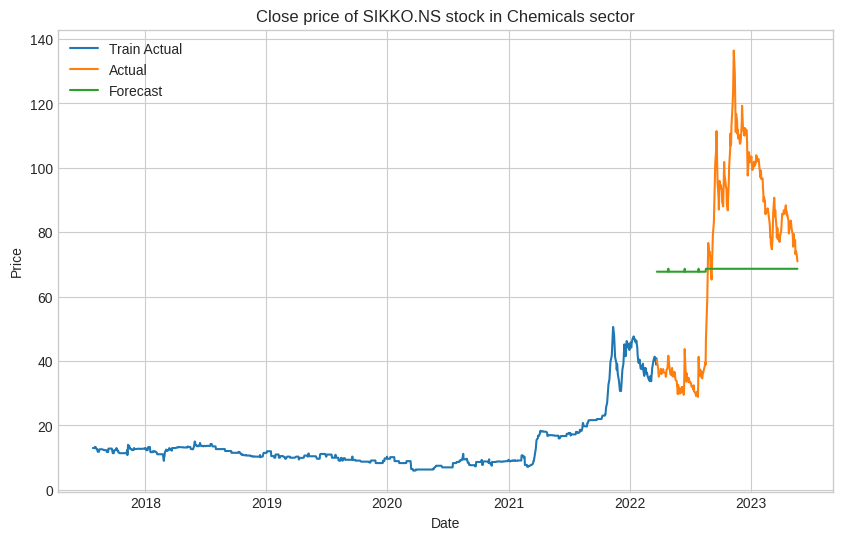

SIKKO.NS Chemicals sector model evaluation metrics:
R-squared score: 0.006243058879440544
RMSE: 67.83781383144047
Forecasting ALKALI.NS in Chemicals sector


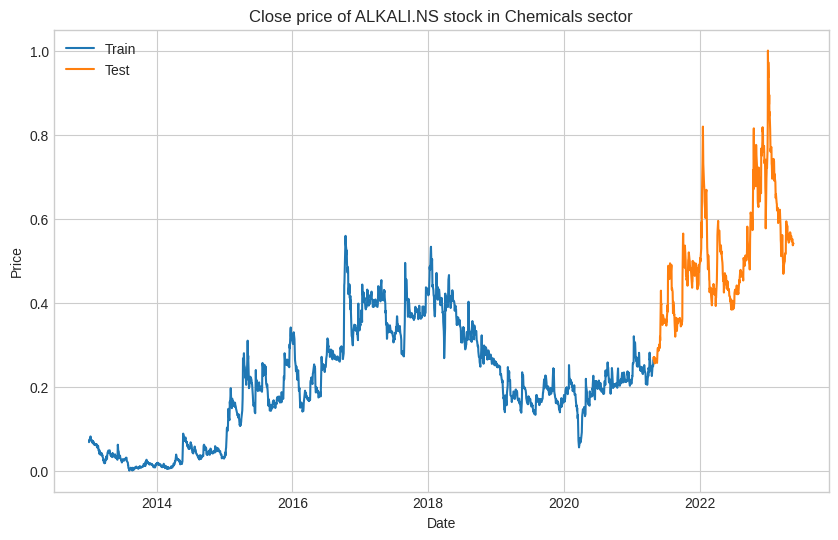

Fitting 5 folds for each of 27 candidates, totalling 135 fits


KeyboardInterrupt: ignored

In [54]:
import xgboost as xgb
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import GridSearchCV

# Define the forecast horizon
forecast_horizon = 365

# Define the scaler
scaler = MinMaxScaler(feature_range=(0, 1))

for sector, stocks in selected_stocks.items():
    for stock in stocks:
        print(f'Forecasting {stock} in {sector} sector')
        
        # Get the stock data
        stock_data = df_historical_data.loc[df_historical_data['ticker'] == stock]

        # Preprocess the data
        X = stock_data.drop(['ticker', 'Sector'], axis=1)
        X = scaler.fit_transform(X)
        y = stock_data['close'].values.reshape(-1, 1)
        y = scaler.fit_transform(y)

        # Split the data into training and testing sets
        split = int(len(X) * 0.8)
        X_train, X_test = X[:split], X[split:]
        y_train, y_test = y[:split], y[split:]
        
        # Plot the training and testing sets
        plt.figure(figsize=(10, 6))
        plt.plot(stock_data.index[:split], y_train, label='Train')
        plt.plot(stock_data.index[split:], y_test, label='Test')
        plt.title(f'Close price of {stock} stock in {sector} sector')
        plt.xlabel('Date')
        plt.ylabel('Price')
        plt.legend()
        plt.show()
        
        # Define the hyperparameters to tune
        param_grid = {
            'max_depth': [3, 5, 7],
            'n_estimators': [50, 100, 200],
            'learning_rate': [0.01, 0.1, 1],
        }

        # Define the XGBoost model
        model = xgb.XGBRegressor(objective='reg:squarederror')

        # Perform a grid search to find the best hyperparameters
        grid_search = GridSearchCV(model, param_grid, cv=5, n_jobs=-1, verbose=2)
        grid_result_xg = grid_search.fit(X_train, y_train)
        
        # Print the best hyperparameters and the corresponding score
        print("Best hyperparameters: ", grid_search.best_params_)
        print("Best score: ", grid_search.best_score_)
        
        # Extract the best hyperparameters and import them into the model
        best_params = grid_search.best_params_
        best_params['objective'] = 'reg:squarederror'
        model = xgb.XGBRegressor(**best_params)
        model.fit(X_train, y_train)

        # # Train the XGBoost model on the training set
        # eval_set = [(X_train, y_train), (X_test, y_test)]
        # model.fit(X_train, y_train, eval_set=eval_set, eval_metric='rmse', early_stopping_rounds=10, verbose=False)

        # Make the forecast using the trained model
        forecast = model.predict(X_test)
        forecast = scaler.inverse_transform(forecast.reshape(-1, 1))

        # Create a date range for the forecast period
        forecast_dates = stock_data.index[split:]
        train_dates = stock_data.index[:split]

        # Create a pandas dataframe with the forecast and the date range
       # Create a pandas dataframe with the forecast and the date range as the index
        forecast_df = pd.DataFrame({'close': forecast.reshape(-1)}, index=forecast_dates)

        # Unscale the actual prices
        actual_prices = scaler.inverse_transform(y_test)
        actual_train_prices = scaler.inverse_transform(y_train)

        # Create a pandas dataframe
        eval_set = [(X_train, y_train), (X_test, y_test)]
        model.fit(X_train, y_train, eval_set=eval_set, eval_metric='rmse', early_stopping_rounds=10, verbose=False)

        # Impute the best hyperparameters directly into the model
        params = grid_search.best_params_
        params['objective'] = 'reg:squarederror'
        model = xgb.XGBRegressor(**params)

        # Train the XGBoost model on the training set with the imputed hyperparameters
        eval_set = [(X_train, y_train), (X_test, y_test)]
        model.fit(X_train, y_train, eval_set=eval_set, eval_metric='rmse', early_stopping_rounds=10, verbose=False)

        # Make the forecast
        forecast = model.predict(X_test)
        forecast = scaler.inverse_transform(forecast.reshape(-1, 1))

        # Create a date range for the forecast period
        forecast_dates = stock_data.index[split:]
        train_dates = stock_data.index[:split]

        # Create a pandas dataframe with the forecast and the date range as the index
        forecast_df = pd.DataFrame({'close': forecast.reshape(-1)}, index=forecast_dates)

        # Unscale the actual prices
        actual_prices = scaler.inverse_transform(y_test)
        actual_train_prices = scaler.inverse_transform(y_train)

        # Create a pandas dataframe with the actual prices and the date range as the index
        actual_df = pd.DataFrame({'close': actual_prices.reshape(-1)}, index=forecast_dates)
        actual_train_df = pd.DataFrame({'close': actual_train_prices.reshape(-1)}, index=train_dates)

        # Plot the actual and forecasted prices
        plt.figure(figsize=(10, 6))
        plt.plot(actual_train_df.index, actual_train_df['close'], label='Train Actual')
        plt.plot(actual_df.index, actual_df['close'], label='Actual')
        plt.plot(forecast_df.index, forecast_df['close'], label='Forecast')
        plt.title(f'Close price of {stock} stock in {sector} sector')
        plt.xlabel('Date')
        plt.ylabel('Price')
        plt.legend()
        plt.show()

        # Print the model evaluation metrics
        print(f'{stock} {sector} sector model evaluation metrics:')
        print(f'R-squared score: {model.score(X_test, y_test)}')
        print(f'RMSE: {mean_squared_error(y_test, forecast)**0.5}')

Random Forest

Forecasting TAINWALCHM.NS in Chemicals sector


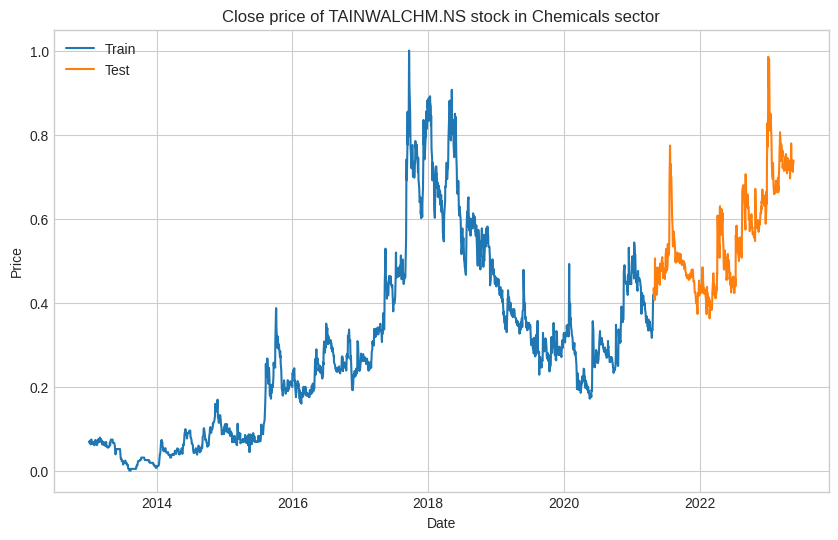

Fitting 5 folds for each of 18 candidates, totalling 90 fits


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_search.py:909: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.best_estimator_.fit(X, y, **fit_params)


Best hyperparameters:  {'max_depth': 7, 'max_features': 'sqrt', 'n_estimators': 100}
Best score:  0.8485582800824994


<ipython-input-55-d78c7a885273>:64: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  model.fit(X_train, y_train)


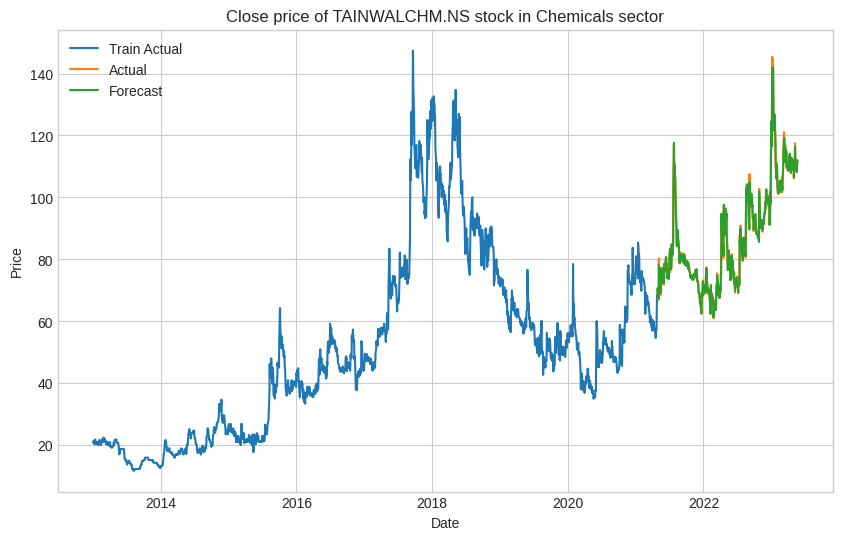

TAINWALCHM.NS Chemicals sector model evaluation metrics:
R-squared score: 0.9988487579444024
RMSE: 87.88398354568405
Forecasting ARVEE.NS in Chemicals sector


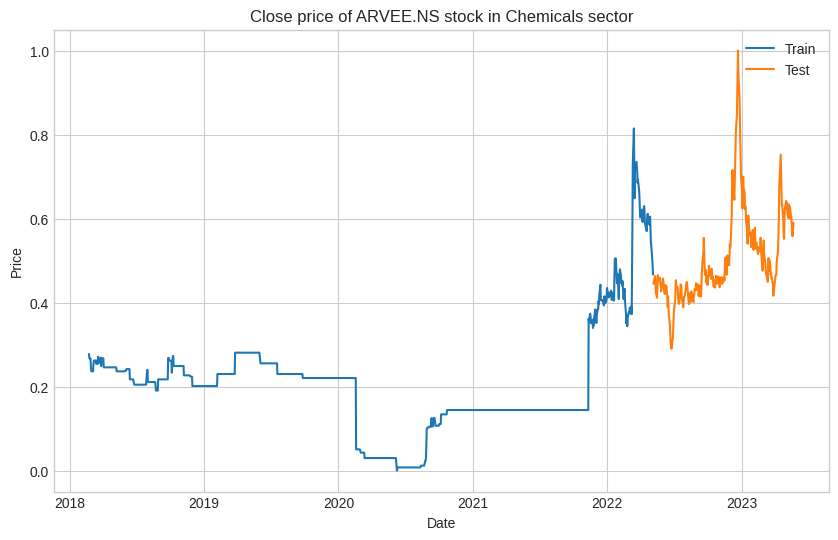

Fitting 5 folds for each of 18 candidates, totalling 90 fits


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_search.py:909: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.best_estimator_.fit(X, y, **fit_params)


Best hyperparameters:  {'max_depth': 7, 'max_features': 'sqrt', 'n_estimators': 200}
Best score:  0.6862185648625592


<ipython-input-55-d78c7a885273>:64: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  model.fit(X_train, y_train)


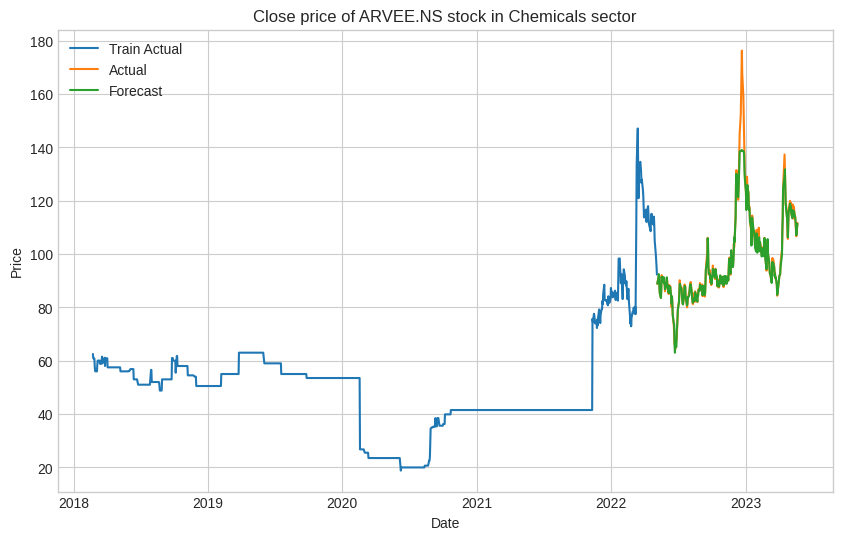

ARVEE.NS Chemicals sector model evaluation metrics:
R-squared score: 0.9428381249072969
RMSE: 98.56330398970408
Forecasting AGROPHOS.NS in Chemicals sector


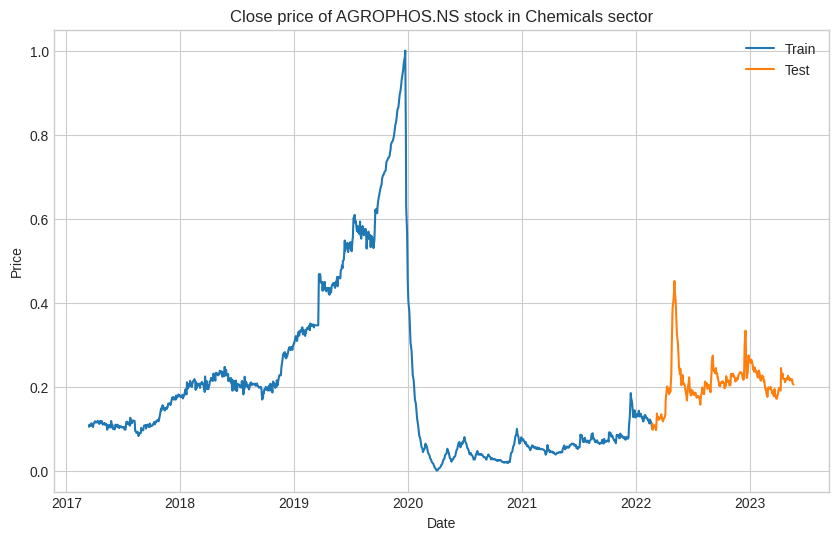

Fitting 5 folds for each of 18 candidates, totalling 90 fits


KeyboardInterrupt: ignored

In [55]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import MinMaxScaler

# Define the forecast horizon
forecast_horizon = 365

# Define the scaler
scaler = MinMaxScaler(feature_range=(0, 1))

for sector, stocks in selected_stocks.items():
    for stock in stocks:
        print(f'Forecasting {stock} in {sector} sector')
        
        # Get the stock data
        stock_data = df_historical_data.loc[df_historical_data['ticker'] == stock]

        # Preprocess the data
        X = stock_data.drop(['ticker', 'Sector'], axis=1)
        X = scaler.fit_transform(X)
        y = stock_data['close'].values.reshape(-1, 1)
        y = scaler.fit_transform(y)

        # Split the data into training and testing sets
        split = int(len(X) * 0.8)
        X_train, X_test = X[:split], X[split:]
        y_train, y_test = y[:split], y[split:]
        
        # Plot the training and testing sets
        plt.figure(figsize=(10, 6))
        plt.plot(stock_data.index[:split], y_train, label='Train')
        plt.plot(stock_data.index[split:], y_test, label='Test')
        plt.title(f'Close price of {stock} stock in {sector} sector')
        plt.xlabel('Date')
        plt.ylabel('Price')
        plt.legend()
        plt.show()
        
        # Define the hyperparameters to tune
        param_grid = {
            'n_estimators': [50, 100, 200],
            'max_depth': [3, 5, 7],
            'max_features': ['sqrt', 'log2'],
        }

        # Define the Random Forest model
        model = RandomForestRegressor()

        # Perform a grid search to find the best hyperparameters
        grid_search = GridSearchCV(model, param_grid, cv=5, n_jobs=-1, verbose=2)
        grid_result_rf = grid_search.fit(X_train, y_train)
        
        # Print the best hyperparameters and the corresponding score
        print("Best hyperparameters: ", grid_search.best_params_)
        print("Best score: ", grid_search.best_score_)
        
        # Extract the best hyperparameters and import them into the model
        best_params = grid_search.best_params_
        model = RandomForestRegressor(**best_params)

        # Train the Random Forest model on the training set
        model.fit(X_train, y_train)

        # Make the forecast using the trained model
        forecast = model.predict(X_test)
        forecast = scaler.inverse_transform(forecast.reshape(-1, 1))

        # Create a date range for the forecast period
        forecast_dates = stock_data.index[split:]
        train_dates = stock_data.index[:split]

        # Create a pandas dataframe with the forecast and the date range as the index
        forecast_df = pd.DataFrame({'close': forecast.reshape(-1)}, index=forecast_dates)

        # Unscale the actual prices
        actual_prices = scaler.inverse_transform(y_test)
        actual_train_prices = scaler.inverse_transform(y_train)

        # Create a pandas dataframe with the actual prices and the date range as the index
        actual_df = pd.DataFrame({'close': actual_prices.reshape(-1)}, index=forecast_dates)
        actual_train_df = pd.DataFrame({'close': actual_train_prices.reshape(-1)}, index=train_dates)

        # Plot the actual and forecasted prices
        plt.figure(figsize=(10, 6))
        plt.plot(actual_train_df.index, actual_train_df['close'], label='Train Actual')
        plt.plot(actual_df.index, actual_df['close'], label='Actual')
        plt.plot(forecast_df.index, forecast_df['close'], label='Forecast')
        plt.title(f'Close price of {stock} stock in {sector} sector')
        plt.xlabel('Date')
        plt.ylabel('Price')
        plt.legend()
        plt.show()

        # Print the model evaluation metrics
        print(f'{stock} {sector} sector model evaluation metrics:')
        print(f'R-squared score: {model.score(X_test, y_test)}')
        print(f'RMSE: {mean_squared_error(y_test, forecast)**0.5}')

**EXTRAS** (Tried Another Ensemble Techniques)

Forecasting TAINWALCHM.NS in Chemicals sector
15/15 [==============================] - 1s 6ms/step
RMSE score for TAINWALCHM.NS in Chemicals sector: 2.024707794189453


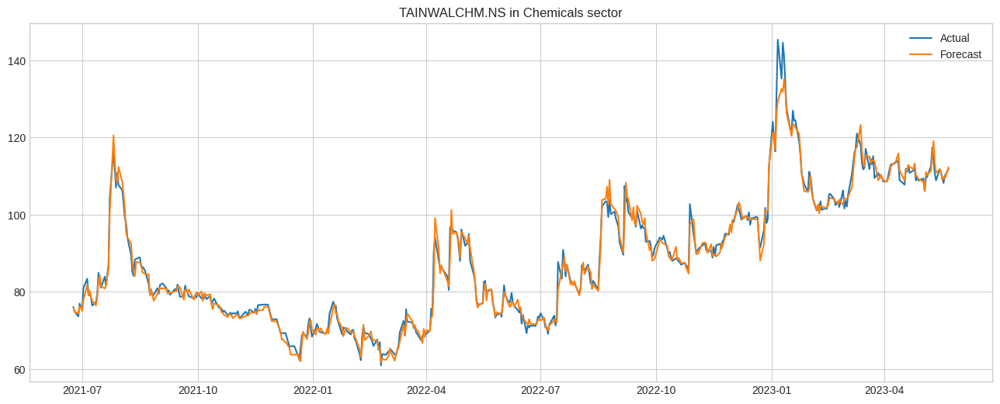

Forecasting ARVEE.NS in Chemicals sector
4/4 [==============================] - 0s 6ms/step
RMSE score for ARVEE.NS in Chemicals sector: 8.292325973510742


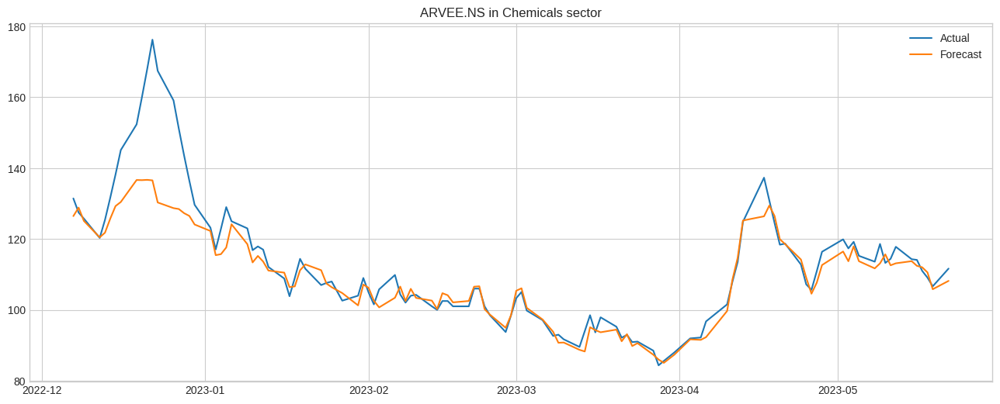

Forecasting AGROPHOS.NS in Chemicals sector
9/9 [==============================] - 0s 7ms/step
RMSE score for AGROPHOS.NS in Chemicals sector: 1.2658461332321167


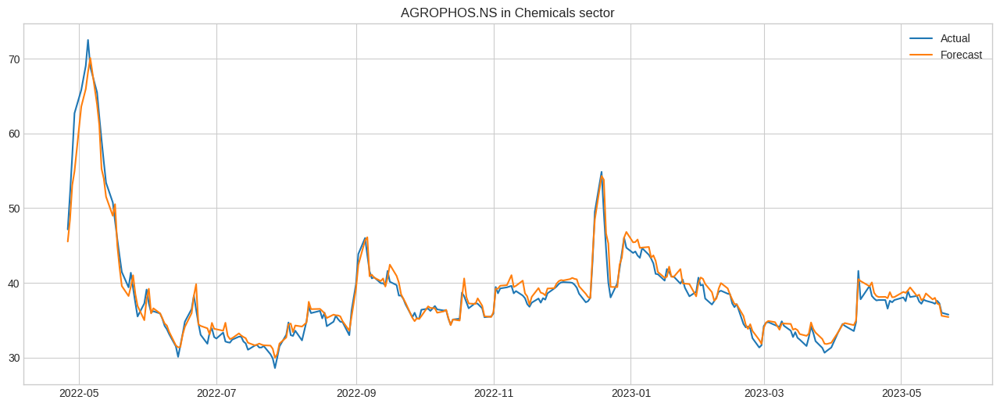

Forecasting SIKKO.NS in Chemicals sector


KeyboardInterrupt: ignored

In [57]:
# Random Forest+ XG-Boost +LSTM

import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from keras.models import Sequential
from keras.layers import Dense, LSTM
import tensorflow as tf

# Define a function to preprocess the data
def preprocess_stock_data(stock):
    # get data for the stock
    stock_data = df_historical_data.loc[df_historical_data['ticker'] == stock]
    stock_data = stock_data.drop(['ticker', 'volume', 'adjclose'], axis=1)
    stock_data['MA50'] = stock_data['close'].rolling(window=50).mean()
    stock_data['MA200'] = stock_data['close'].rolling(window=200).mean()
    stock_data['RSI'] = compute_RSI(stock_data['close'])
    stock_data['Bollinger_upper'] = stock_data['MA50'] + 2 * stock_data['close'].rolling(window=50).std()
    stock_data['Bollinger_lower'] = stock_data['MA50'] - 2 * stock_data['close'].rolling(window=50).std()
    stock_data = stock_data.dropna()
    stock_data = stock_data.drop(['Sector'], axis=1) # drop sector column
        
    # split data into train and test sets
    X = stock_data.drop(['close'], axis=1)
    y = stock_data['close']
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=False)
    
    return X_train, X_test, y_train, y_test

# Define a list of models to use for ensemble learning
models = [RandomForestRegressor(n_estimators=100, random_state=0),
          GradientBoostingRegressor(n_estimators=100, random_state=0),
          Sequential([LSTM(128, input_shape=(X_train.shape[1], 1)), Dense(1)])]

# Loop through all selected stocks and preprocess the data for each stock
for sector, stocks in selected_stocks.items():
    for stock in stocks:
        print(f'Forecasting {stock} in {sector} sector')
        
        X_train, X_test, y_train, y_test = preprocess_stock_data(stock)
        
        # Loop through all models, train them, and make predictions
        predictions = []
        for model in models:
            if isinstance(model, Sequential):
                X_train = np.reshape(X_train.values, (X_train.shape[0], X_train.shape[1], 1))
                X_test = np.reshape(X_test.values, (X_test.shape[0], X_test.shape[1], 1))
                model.compile(loss='mse', optimizer='adam')
                model.fit(X_train, y_train, epochs=50, verbose=0)
                prediction = model.predict(X_test)
                prediction = np.reshape(prediction, (prediction.shape[0],))
                predictions.append(prediction)
            else:
                model.fit(X_train, y_train)
                prediction = model.predict(X_test)
                prediction = np.reshape(prediction, (prediction.shape[0],))
                predictions.append(prediction)

        
        # Use weighted average of predictions to create final prediction
        weights = [0.4, 0.4, 0.2]
        final_prediction = np.average(predictions, axis=0, weights=weights)
        
        # Calculate RMSE score for final prediction
        rmse = tf.keras.metrics.RootMeanSquaredError()
        rmse.update_state(y_test, final_prediction)
        print(f"RMSE score for {stock} in {sector} sector: {rmse.result().numpy()}")
        
        # Calculate RMSE score for each individual model
        for i, model in enumerate(models):
            prediction = predictions[i]
            rmse = tf.keras.metrics.RootMeanSquaredError()
            rmse.update_state(y_test, prediction)
            # print(f"RMSE score for {stock} in {sector} sector using {type(model).name}: {rmse.result().numpy()}")
        
        # Plot the testing data and the forecasted values
        plt.figure(figsize=(16, 6))
        plt.plot(y_test.index, y_test.values, label='Actual')
        plt.plot(y_test.index, final_prediction, label='Forecast')
        plt.legend()
        plt.title(f"{stock} in {sector} sector")
        plt.show()


Forecasting TAINWALCHM.NS in Chemicals sector
15/15 [==============================] - 0s 4ms/step
RMSE score for TAINWALCHM.NS in Chemicals sector: 11.675729751586914


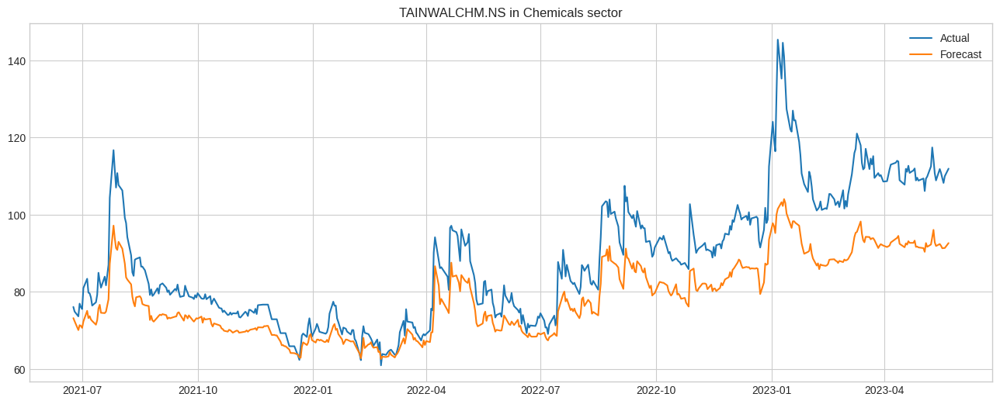

Forecasting ARVEE.NS in Chemicals sector
4/4 [==============================] - 0s 6ms/step
RMSE score for ARVEE.NS in Chemicals sector: 18.082292556762695


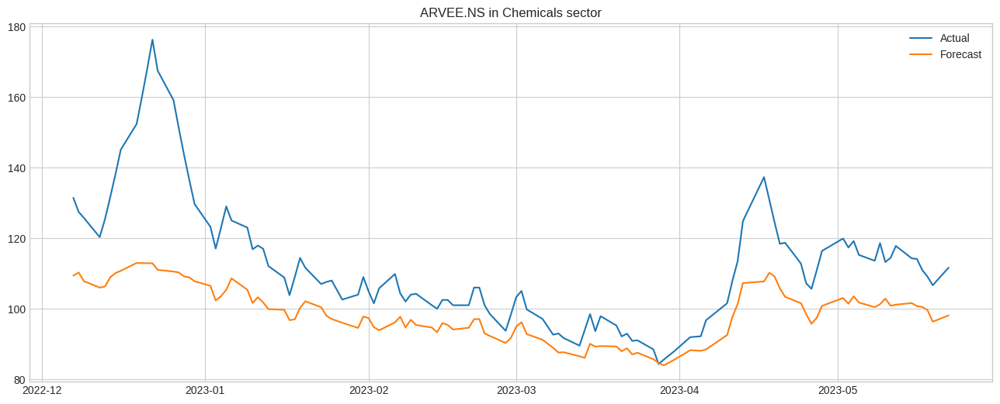

Forecasting AGROPHOS.NS in Chemicals sector
9/9 [==============================] - 0s 4ms/step
RMSE score for AGROPHOS.NS in Chemicals sector: 3.237403631210327


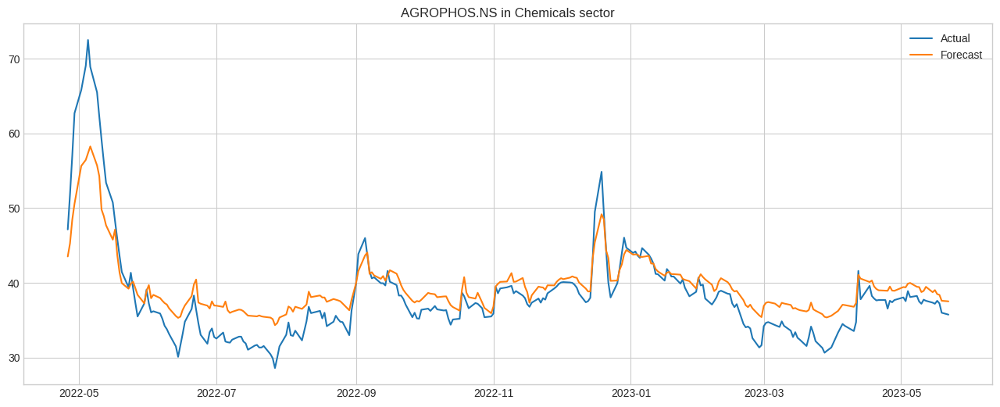

Forecasting SIKKO.NS in Chemicals sector
8/8 [==============================] - 0s 4ms/step
RMSE score for SIKKO.NS in Chemicals sector: 41.8026237487793


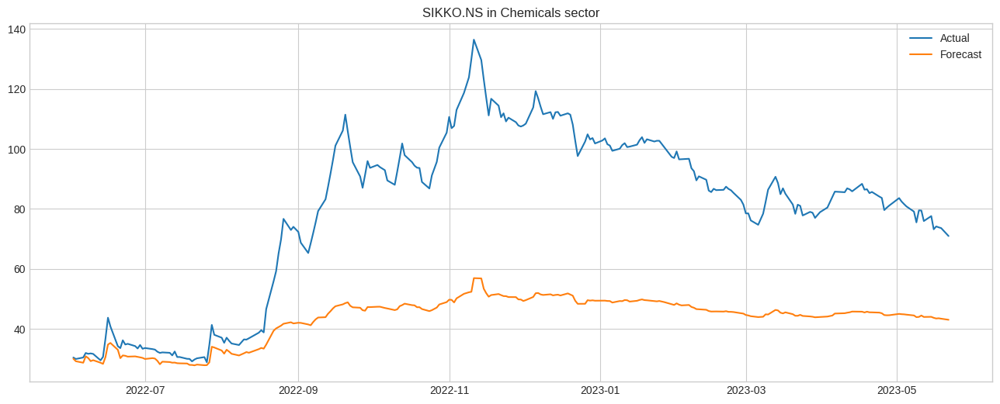

Forecasting ALKALI.NS in Chemicals sector
15/15 [==============================] - 1s 5ms/step
RMSE score for ALKALI.NS in Chemicals sector: 25.979244232177734


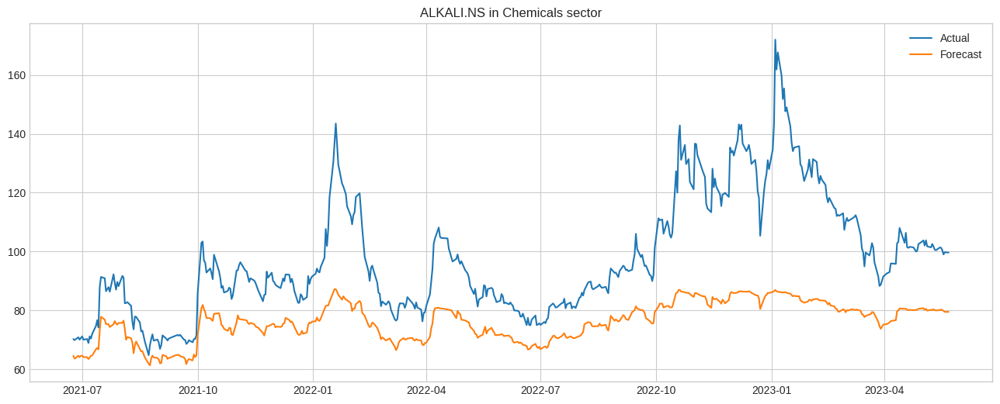

Forecasting IITL.NS in Investment Banking & Investment Services sector
15/15 [==============================] - 1s 5ms/step
RMSE score for IITL.NS in Investment Banking & Investment Services sector: 7.243526458740234


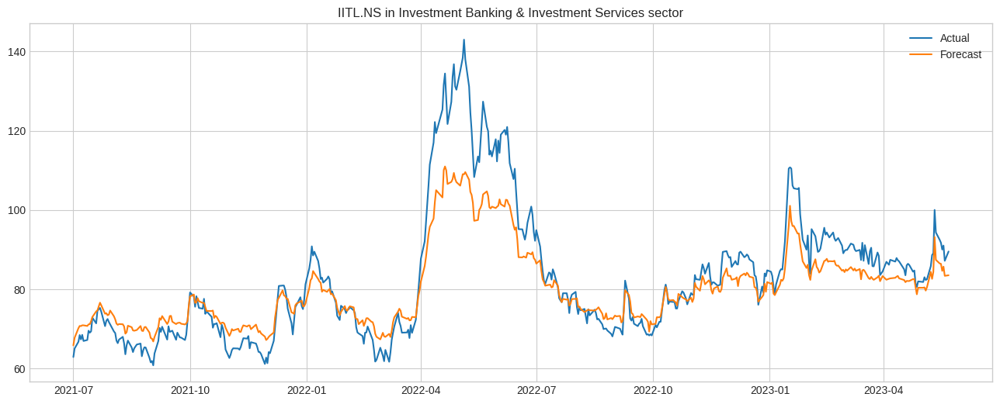

Forecasting 21STCENMGM.NS in Investment Banking & Investment Services sector


AttributeError: ignored

In [58]:
# GRU + Random Forest + SVM

import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.svm import SVR
from keras.models import Sequential
from keras.layers import Dense, GRU
import tensorflow as tf

# Define a function to preprocess the data
def preprocess_stock_data(stock):
    # get data for the stock
    stock_data = df_historical_data.loc[df_historical_data['ticker'] == stock]
    stock_data = stock_data.drop(['ticker', 'volume', 'adjclose'], axis=1)
    stock_data['MA50'] = stock_data['close'].rolling(window=50).mean()
    stock_data['MA200'] = stock_data['close'].rolling(window=200).mean()
    stock_data['RSI'] = compute_RSI(stock_data['close'])
    stock_data['Bollinger_upper'] = stock_data['MA50'] + 2 * stock_data['close'].rolling(window=50).std()
    stock_data['Bollinger_lower'] = stock_data['MA50'] - 2 * stock_data['close'].rolling(window=50).std()
    stock_data = stock_data.dropna()
    stock_data = stock_data.drop(['Sector'], axis=1) # drop sector column
        
    # split data into train and test sets
    X = stock_data.drop(['close'], axis=1)
    y = stock_data['close']
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=False)
    
    return X_train, X_test, y_train, y_test

# Define a list of models to use for ensemble learning
models = [RandomForestRegressor(n_estimators=100, random_state=0),
          SVR(kernel='rbf', C=100, gamma=0.1),
          Sequential([GRU(128, input_shape=(X_train.shape[1], 1)), Dense(1)])]

# Loop through all selected stocks and preprocess the data for each stock
for sector, stocks in selected_stocks.items():
    for stock in stocks:
        print(f'Forecasting {stock} in {sector} sector')
        
        X_train, X_test, y_train, y_test = preprocess_stock_data(stock)
        
        # Loop through all models, train them, and make predictions
        predictions = []
        for model in models:
            if isinstance(model, Sequential):
                X_train = np.reshape(X_train.values, (X_train.shape[0], X_train.shape[1], 1))
                X_test = np.reshape(X_test.values, (X_test.shape[0], X_test.shape[1], 1))
                model.compile(loss='mse', optimizer='adam')
                model.fit(X_train, y_train, epochs=50, verbose=0)
                prediction = model.predict(X_test)
                prediction = np.reshape(prediction, (prediction.shape[0],))
                predictions.append(prediction)
            else:
                model.fit(X_train, y_train)
                prediction = model.predict(X_test)
                prediction = np.reshape(prediction, (prediction.shape[0],))
                predictions.append(prediction)

        # Use weighted average of predictions to create final prediction
        weights = [0.4, 0.4, 0.2]
        final_prediction = np.average(predictions, axis=0, weights=weights)
        
        # Calculate RMSE score for final prediction
        rmse = tf.keras.metrics.RootMeanSquaredError()
        rmse.update_state(y_test, final_prediction)
        print(f"RMSE score for {stock} in {sector} sector: {rmse.result().numpy()}")
        
        # Calculate RMSE score for each individual model
        for i, model in enumerate(models):
            prediction = predictions[i]
            rmse = tf.keras.metrics.RootMeanSquaredError()
            rmse.update_state(y_test, prediction)
            # print(f"RMSE score for {stock} in {sector} sector using {type(model).name}: {rmse.result().numpy()}")
        
        # Plot the testing data and the forecasted values
        plt.figure(figsize=(16, 6))
        plt.plot(y_test.index, y_test.values, label='Actual')
        plt.plot(y_test.index, final_prediction, label='Forecast')
        plt.legend()
        plt.title(f"{stock} in {sector} sector")
        plt.show()



**END OF CODE**